# Importing all the necessary packages for the program

In [239]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from scipy import stats

# Downloading all the required .csv files, associating city_ids and merging them into a single dataframe

In [240]:
# Define your city data with city names and corresponding IDs``
city_data = pd.DataFrame({
    'city': ['amsterdam', 'newyork', 'london', 'sanfrancisco', 'toronto'],
    'id': [1, 2, 3, 4, 5]
})

# Dictionary with file paths for different cities
city_files = {
    'amsterdam': "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/listing/listing_amsterdam.csv",
    'newyork': "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/listing/listing_newyork.csv",
    'london': "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/listing/listing_london.csv",
    'sanfrancisco': "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/listing/listing_san_francisco.csv",
    'toronto': "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/listing/listing_toronto.csv"
}

# Initialize an empty list to store all dataframes
all_data = []

counter = 0

# Loop through the city files
for city, file_path in city_files.items():
    # Read each CSV file into a DataFrame
    city_df = pd.read_csv(file_path)
    
    # Find the city id by matching city name in city_data
    city_id = city_data.loc[city_data['city'] == city_data['city'][counter], 'id'].values[0]
    
    # Add city_id column to the dataframe
    city_df['city_id'] = city_id
    
    # Append to the list of dataframes
    all_data.append(city_df)

    counter = counter + 1

# Concatenate all dataframes into a single DataFrame
listing_df = pd.concat(all_data, ignore_index=True)

# Display the final DataFrame
print(listing_df.shape)


(173014, 76)


# Performing data preprocessing on the merged listing dataset

In [241]:
def data_preprocessing(df):
    # Drop unnecessary columns
    columns_to_drop = ['listing_url', 'scrape_id', 'last_scraped', 'source', 'picture_url', 
                       'host_url', 'host_response_time', 'host_response_rate', 
                       'host_acceptance_rate', 'host_thumbnail_url', 'host_picture_url', 
                       'neighbourhood_group_cleansed', 'calendar_updated', 'license', 
                       'calendar_last_scraped']
    
    df = df.drop(columns=columns_to_drop, errors='ignore')  # Use 'ignore' to avoid KeyError if columns don't exist

    df = df[df['maximum_nights'] <= 4380]

    df['minimum_nights'] = pd.to_numeric(df['minimum_nights'], errors='coerce')
    df['maximum_nights'] = pd.to_numeric(df['maximum_nights'], errors='coerce')

    # Clean and convert the 'price' column
    if 'price' in df.columns:
        df['price'] = df['price'].astype(str).replace({'\$': ''}, regex=True).replace({',': ''}, regex=True).astype('float')

    return df

def remove_null_price(df):
    
    return df.dropna(subset=['price'])

def remove_null_review_score(df):

    return df.dropna(subset=['review_scores_rating'])

def print_shape(df):

    print(df.shape)
    

listing_df = data_preprocessing(listing_df)
listing_price_df = remove_null_price(listing_df)
listing_review_score_df = remove_null_review_score(listing_df)

print_shape(listing_df)
print_shape(listing_price_df)
print_shape(listing_review_score_df)


(172998, 61)
(114552, 61)
(128917, 61)


# Saving the pre-processed data into .csv files for future use

In [242]:
def save_dataframes_to_csv(dataframes, filenames):

    for df, filename in zip(dataframes, filenames):
        df.to_csv(filename, index=False)

dataframes_to_save = [listing_df, listing_price_df, listing_review_score_df]
filenames = ["/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/pre_processed_listing_dataset/processed_listing_df.csv", 
             "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/pre_processed_listing_dataset/processed_listing_price_df.csv",
             "/Users/aishwaryaravichandran/Documents copy/machine learning neu/assignment_one/dataset/pre_processed_listing_dataset/processed_listing_review_score_df.csv"]

save_dataframes_to_csv(dataframes_to_save, filenames)

Task 1 - Numerical Analysis Before Outlier Detection

In [215]:
# List of features for statistics
feature_one = ['price']
feature_two = ['minimum_nights', 'maximum_nights', 'number_of_reviews']
feature_three = ['review_scores_rating']

def summarize_city_statistics(df, features, city_data):

    # Calculate and display summary statistics for each city ID
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        print(f"\nSummary Statistics for {city_name}:")
        
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]
        
        for feature in features:
            # Summary statistics for price
            summary_stats_one = city_df[feature].describe()
            print(f'{feature} Summary Statistics:')
            print(summary_stats_one)
    

In [216]:
summarize_city_statistics(listing_price_df,feature_one,city_data)


Summary Statistics for amsterdam:
price Summary Statistics:
count     5869.000000
mean       289.639121
std       1216.784725
min         11.000000
25%        164.000000
50%        225.000000
75%        321.000000
max      91466.000000
Name: price, dtype: float64

Summary Statistics for newyork:
price Summary Statistics:
count     22789.000000
mean        232.893238
std        1019.760485
min           8.000000
25%          85.000000
50%         147.000000
75%         250.000000
max      100000.000000
Name: price, dtype: float64

Summary Statistics for london:
price Summary Statistics:
count    63203.000000
mean       197.154755
std        839.638076
min          1.000000
25%         76.000000
50%        130.000000
75%        211.000000
max      80000.000000
Name: price, dtype: float64

Summary Statistics for sanfrancisco:
price Summary Statistics:
count     6155.000000
mean       239.705280
std       1000.318151
min         25.000000
25%        100.000000
50%        150.000000
75%   

In [217]:
summarize_city_statistics(listing_df,feature_two,city_data)


Summary Statistics for amsterdam:
minimum_nights Summary Statistics:
count    9659.000000
mean        4.215343
std        19.845051
min         1.000000
25%         2.000000
50%         3.000000
75%         4.000000
max      1001.000000
Name: minimum_nights, dtype: float64
maximum_nights Summary Statistics:
count    9659.000000
mean      320.719433
std       417.469795
min         1.000000
25%        20.000000
50%        31.000000
75%       365.000000
max      1125.000000
Name: maximum_nights, dtype: float64
number_of_reviews Summary Statistics:
count    9659.000000
mean       45.636919
std       118.572029
min         0.000000
25%         3.000000
50%        10.000000
75%        32.000000
max      4130.000000
Name: number_of_reviews, dtype: float64

Summary Statistics for newyork:
minimum_nights Summary Statistics:
count    37534.000000
mean        28.968908
std         30.615654
min          1.000000
25%         30.000000
50%         30.000000
75%         30.000000
max       1250.00

In [218]:
summarize_city_statistics(listing_review_score_df,feature_three,city_data)


Summary Statistics for amsterdam:
review_scores_rating Summary Statistics:
count    8632.000000
mean        4.839924
std         0.256842
min         1.000000
25%         4.780000
50%         4.920000
75%         5.000000
max         5.000000
Name: review_scores_rating, dtype: float64

Summary Statistics for newyork:
review_scores_rating Summary Statistics:
count    25996.000000
mean         4.725213
std          0.442827
min          0.000000
25%          4.640000
50%          4.850000
75%          5.000000
max          5.000000
Name: review_scores_rating, dtype: float64

Summary Statistics for london:
review_scores_rating Summary Statistics:
count    71646.000000
mean         4.689832
std          0.472072
min          0.000000
25%          4.570000
50%          4.830000
75%          5.000000
max          5.000000
Name: review_scores_rating, dtype: float64

Summary Statistics for sanfrancisco:
review_scores_rating Summary Statistics:
count    6033.000000
mean        4.787439
std    

# Task 2 - Plotting Histogram Before Outlier Detection

In [58]:
colors = ['red','blue','green','purple','orange']

# Plot histograms
def plotting_histogram(df,features,city_data):
    counter = 0
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        print(f"\nHistogram for {city_name}:")
        
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]
        
        color = colors[counter]
        counter = counter + 1 

        plt.figure(figsize=(15, 10))

        for i, feature in enumerate(features):
            plt.subplot(2, 3, i+1)
            sns.histplot(city_df[feature], bins=30, kde=True, color=color)
            plt.title(f'Histogram of {feature}')
            plt.xlabel(feature)
            plt.ylabel('Frequency')

        plt.tight_layout()
        plt.show()


Histogram for amsterdam:


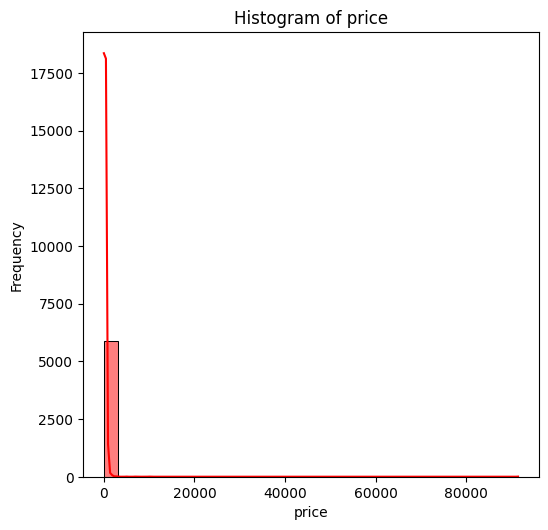


Histogram for newyork:


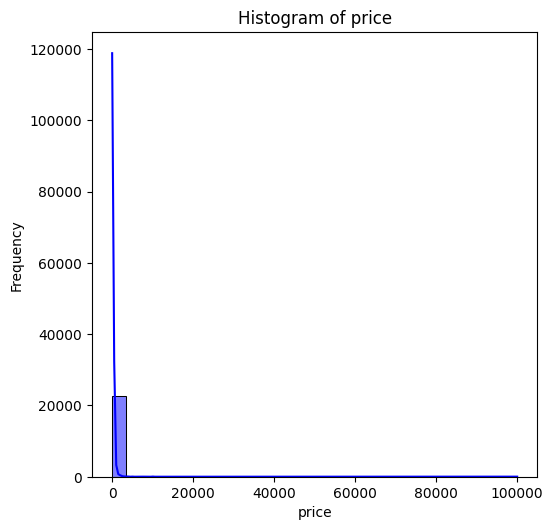


Histogram for london:


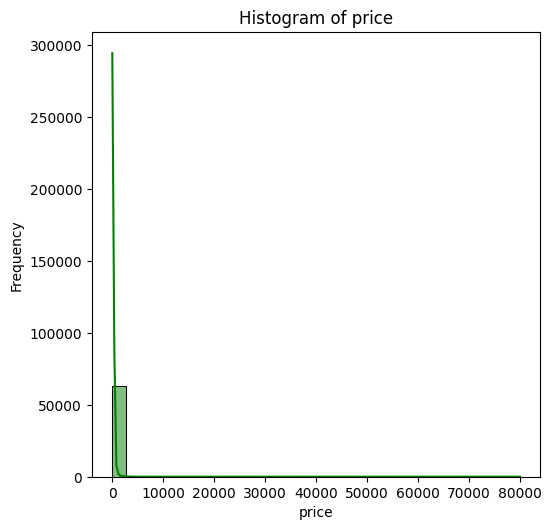


Histogram for sanfrancisco:


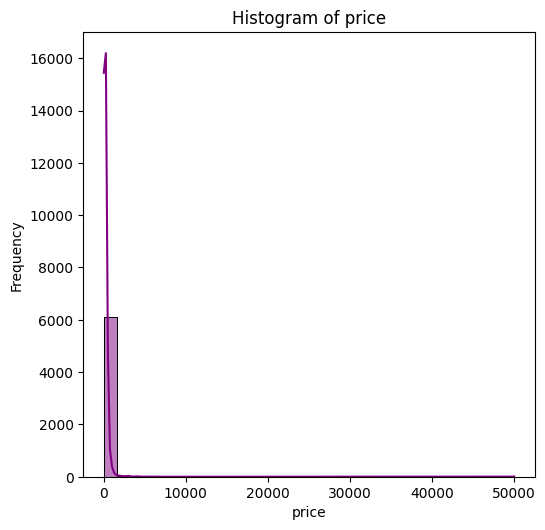


Histogram for toronto:


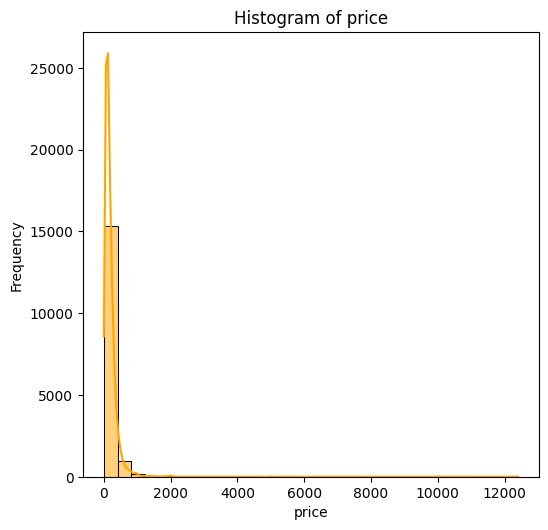

In [59]:
plotting_histogram(listing_price_df,feature_one,city_data)


Histogram for amsterdam:


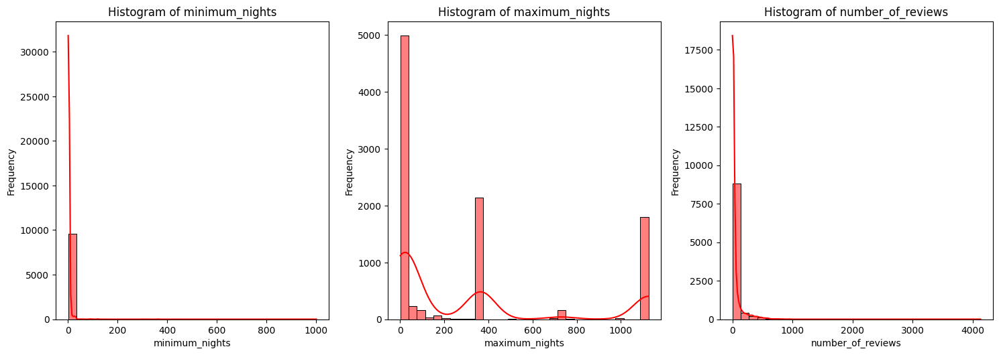


Histogram for newyork:


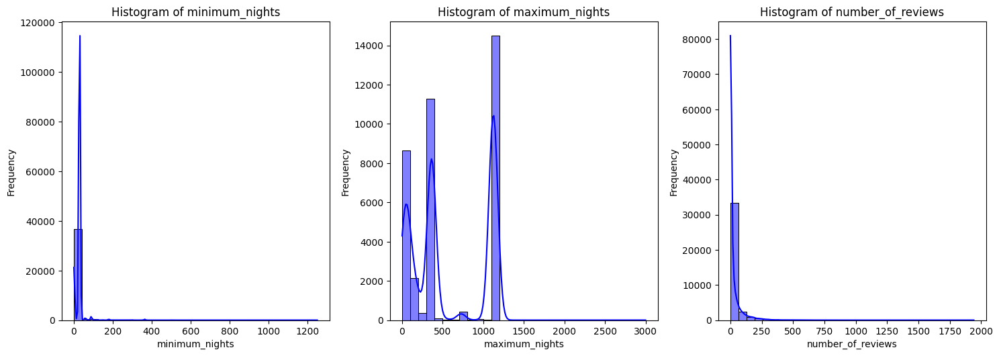


Histogram for london:


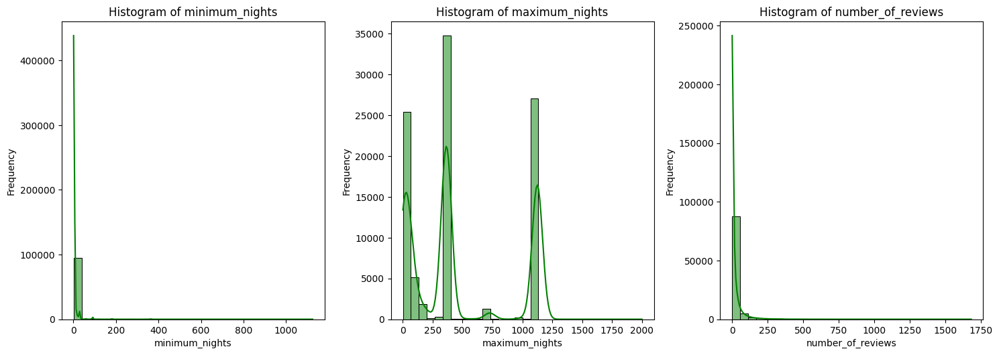


Histogram for sanfrancisco:


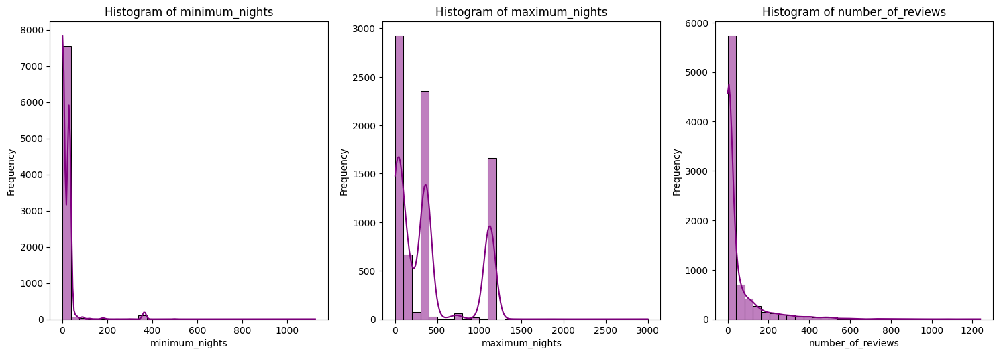


Histogram for toronto:


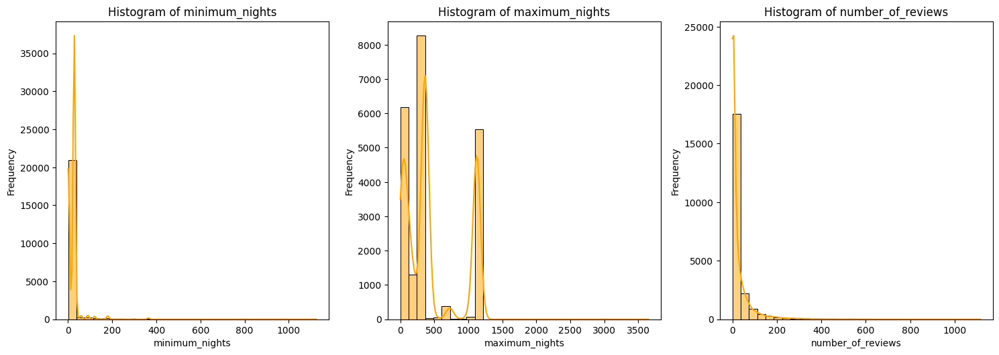

In [60]:
plotting_histogram(listing_df,feature_two,city_data)


Histogram for amsterdam:


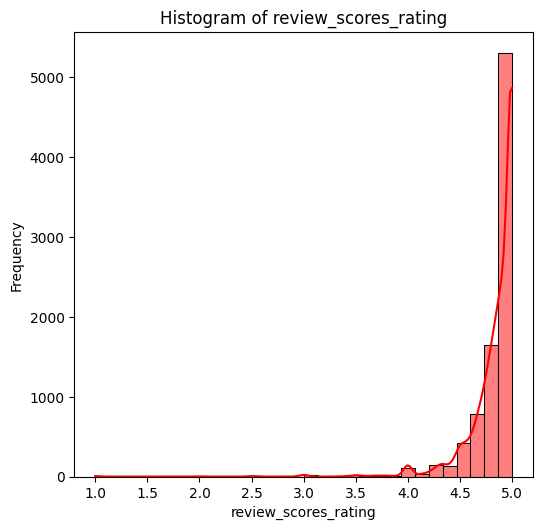


Histogram for newyork:


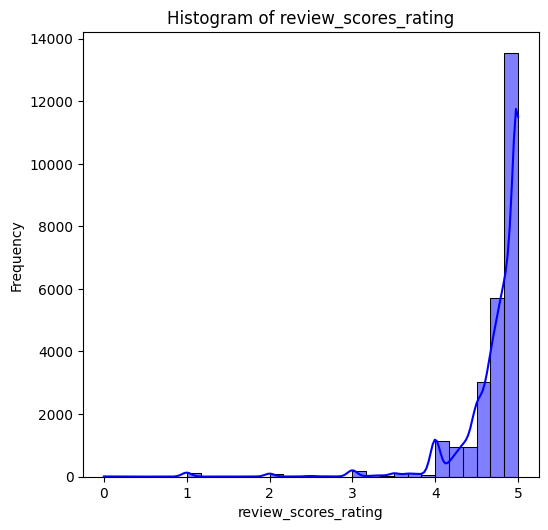


Histogram for london:


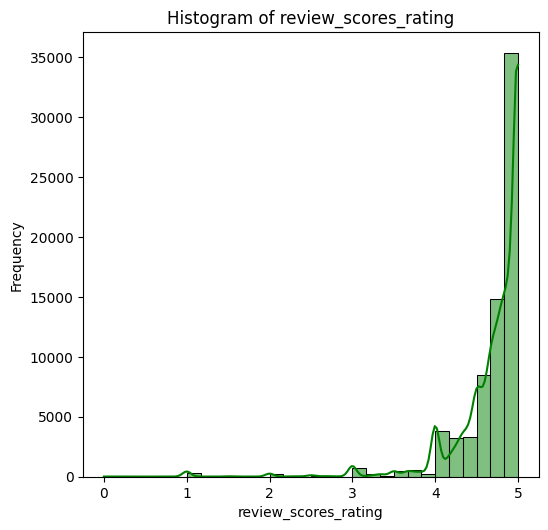


Histogram for sanfrancisco:


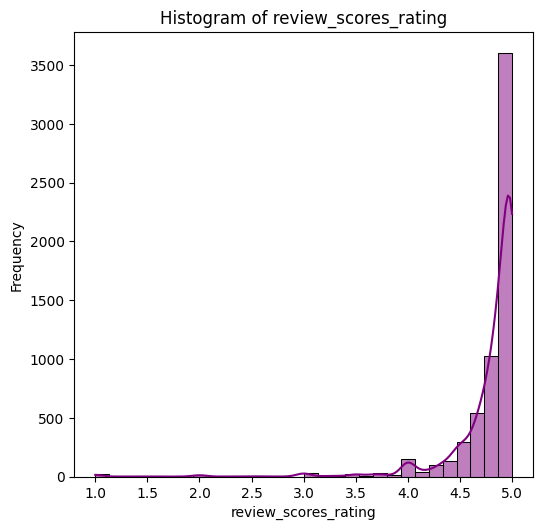


Histogram for toronto:


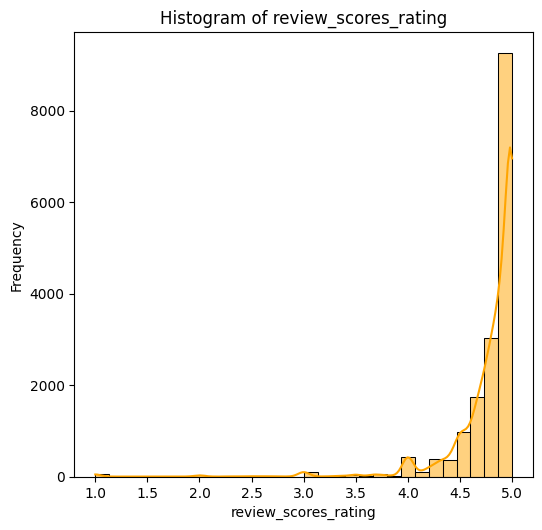

In [61]:
plotting_histogram(listing_review_score_df,feature_three,city_data)

# Task 2 - Constructing Density Plots before Outlier Detection

In [232]:
colors = ['red','blue','green','purple','orange']

def density_plots(df,features,city_data):
    counter = 0
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        print(f"\nDensity Plot for {city_name}:")
        
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]

        color = colors[counter]
        counter = counter + 1 

        # Set up the figure size for better visualization
        plt.figure(figsize=(20, 15))

        for i, feature in enumerate(features):
            # plt.subplot(5, 1, i+1)
            # Plot KDE for 'price'
            sns.kdeplot(city_df[feature], shade=True, color=color)
            plt.title(f'Density Plot for {feature}')
            plt.xlabel(f'{feature}')

            # Adjust the spacing between plots
            plt.tight_layout()

            # Show the plots
            plt.show()


Density Plot for amsterdam:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


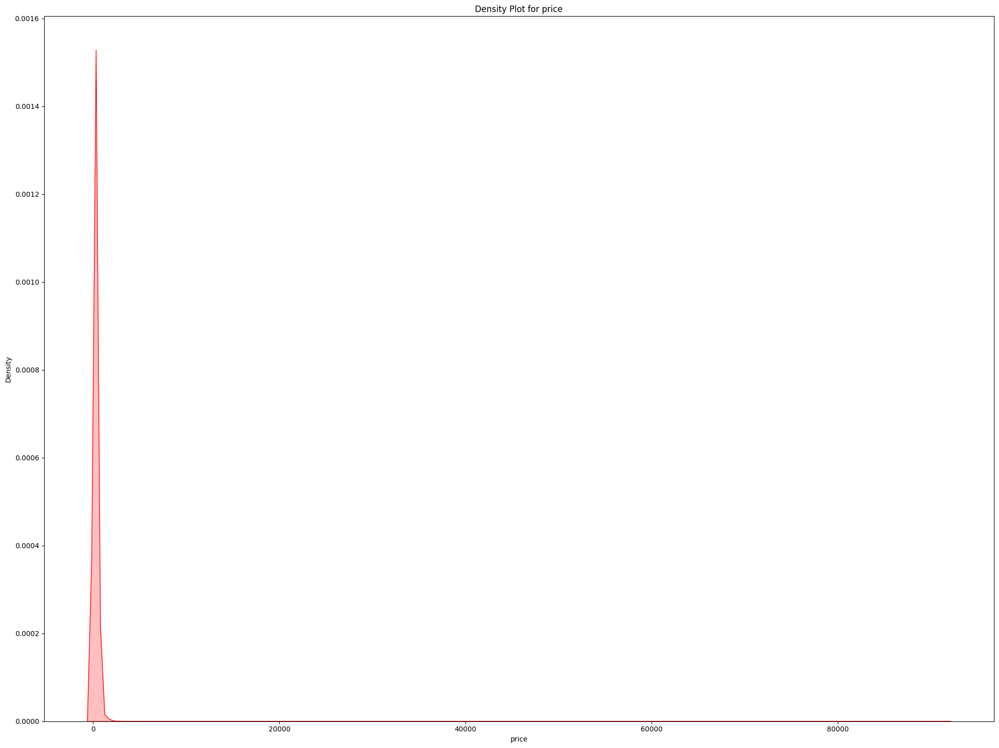


Density Plot for newyork:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


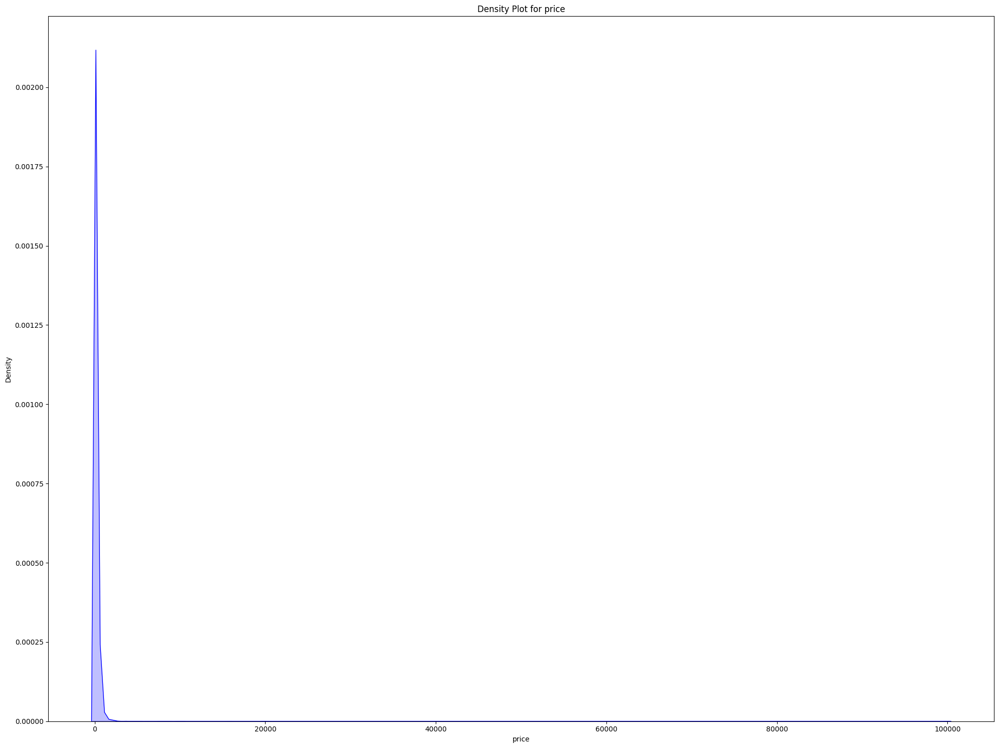


Density Plot for london:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


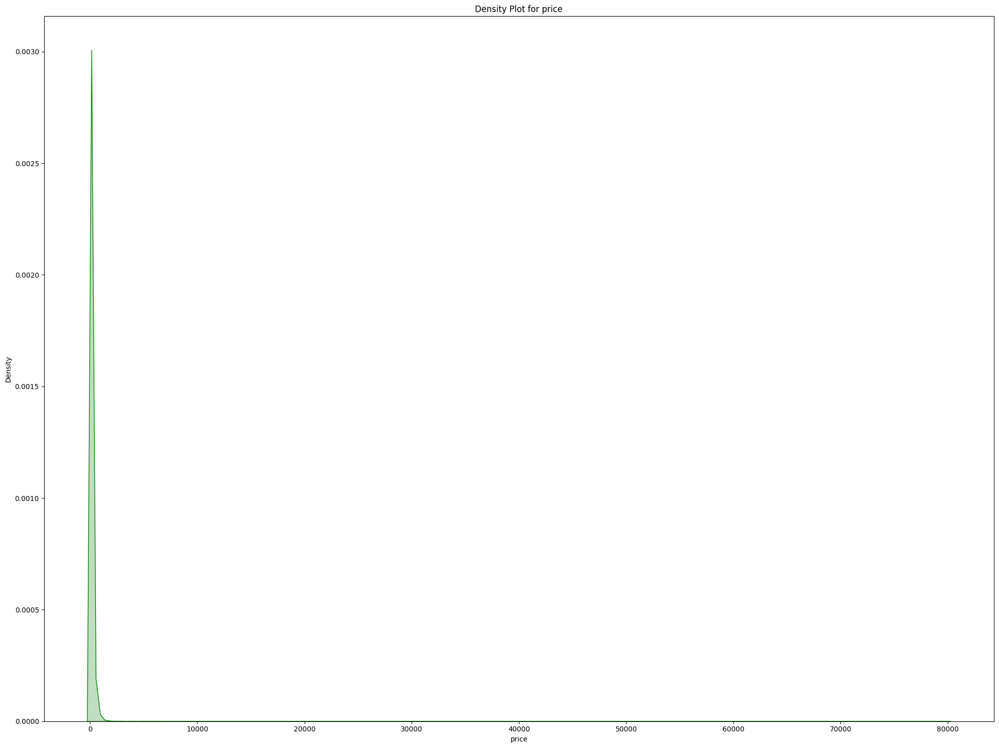


Density Plot for sanfrancisco:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


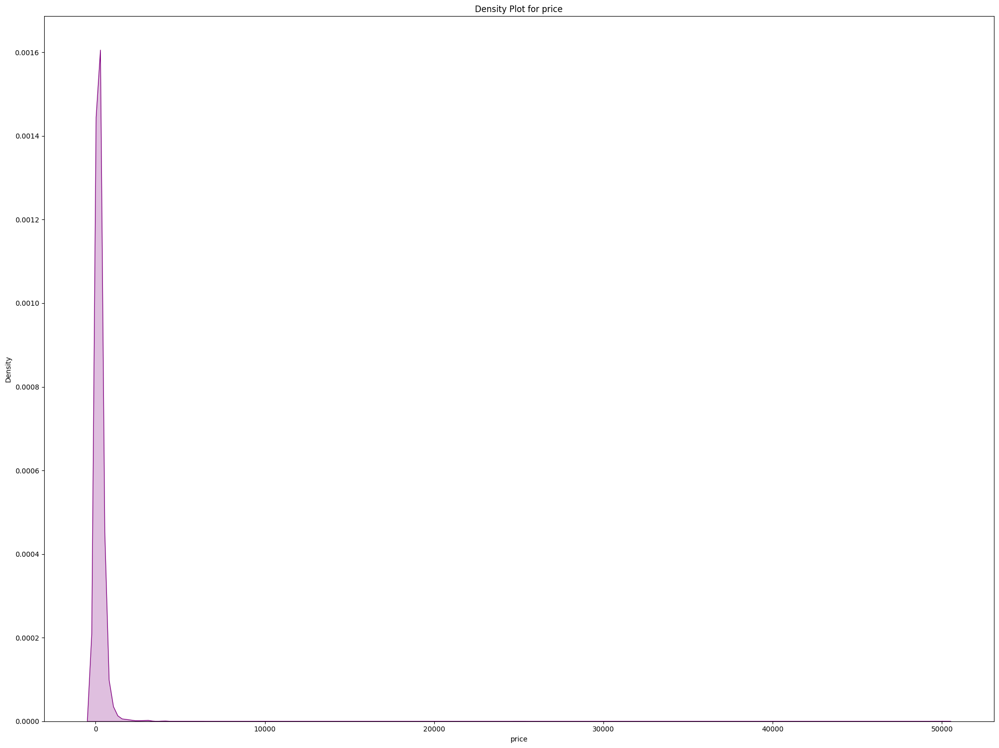


Density Plot for toronto:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


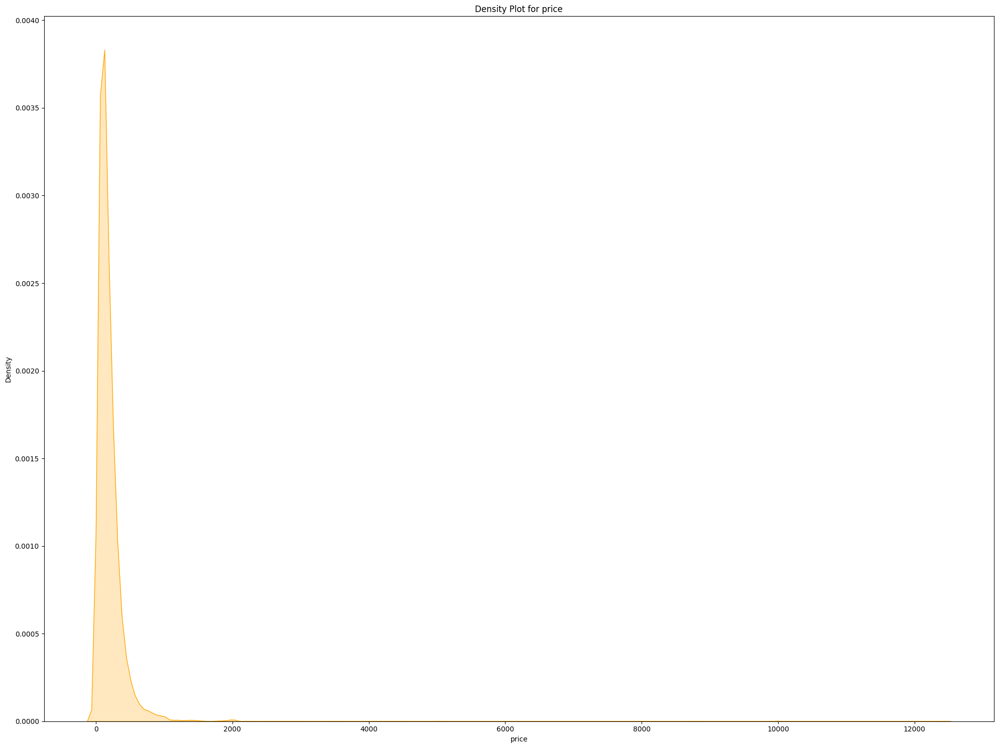

In [233]:
density_plots(listing_price_df,feature_one,city_data)


Density Plot for amsterdam:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


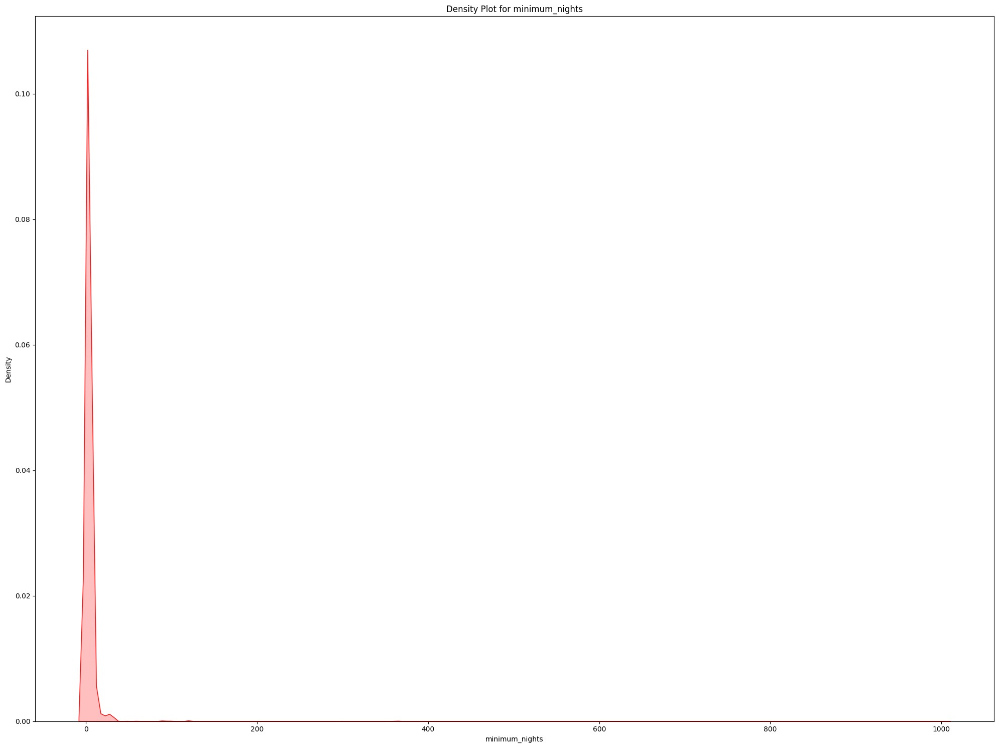

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


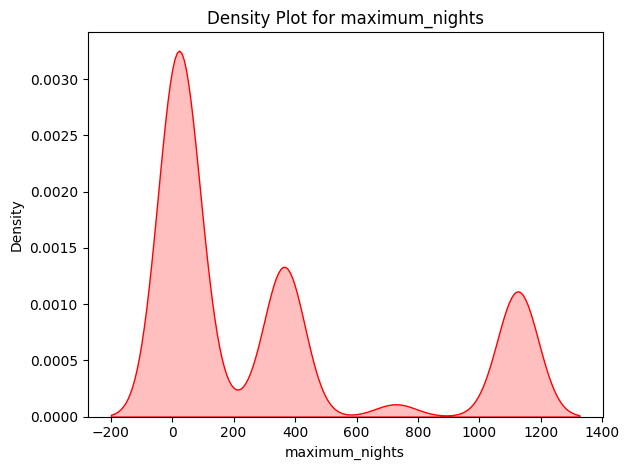

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


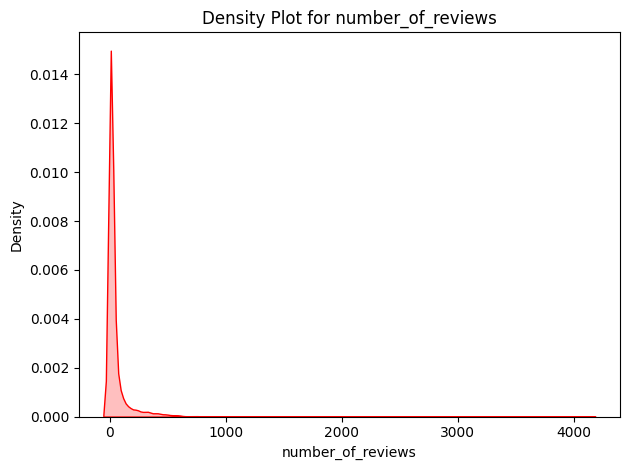

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)



Density Plot for newyork:


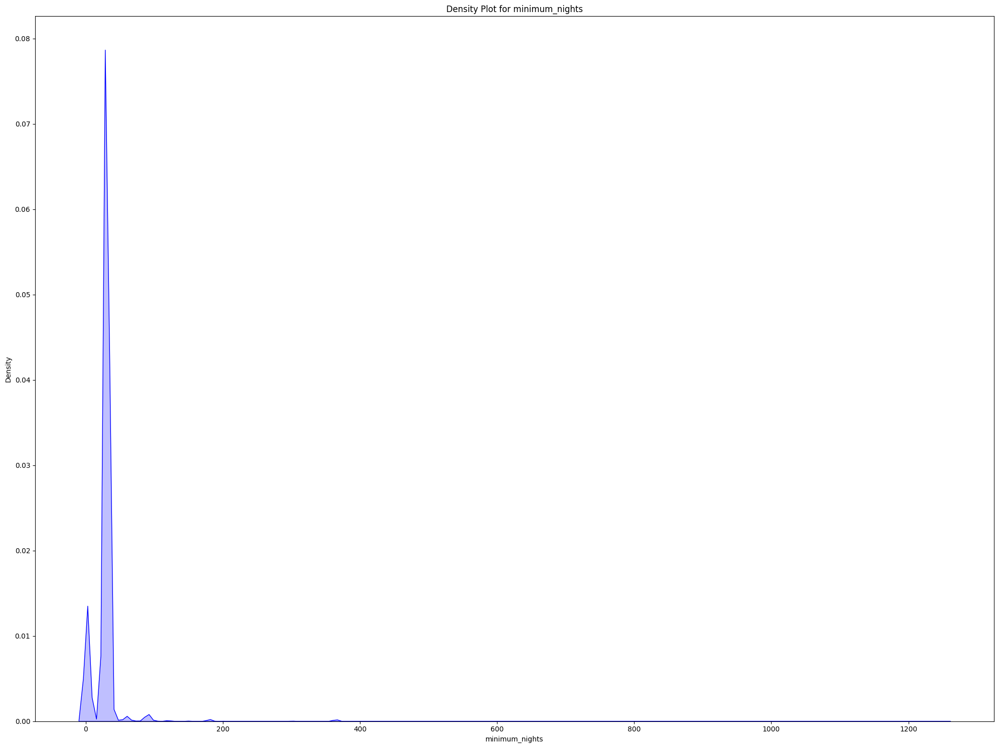

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


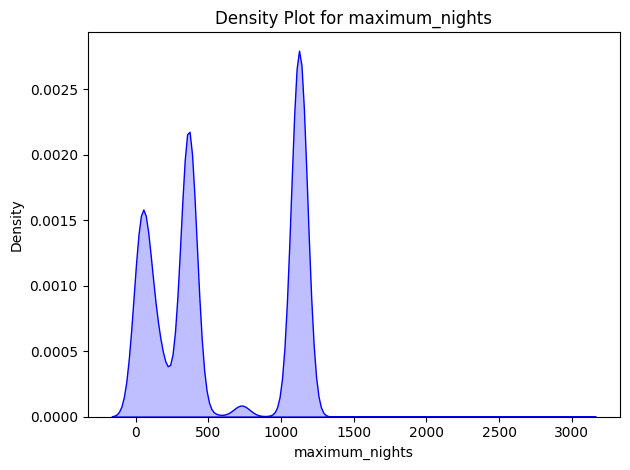

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


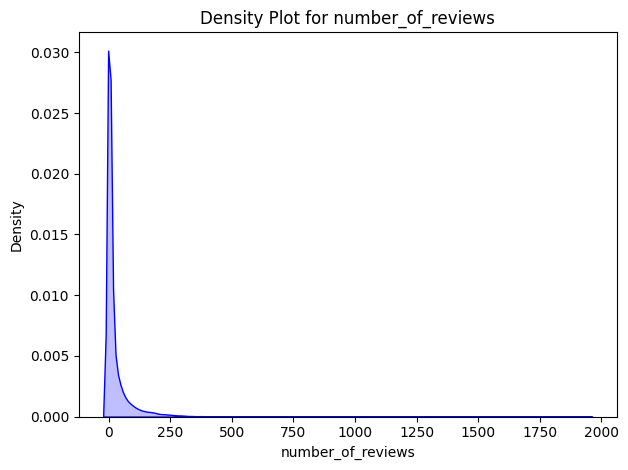


Density Plot for london:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


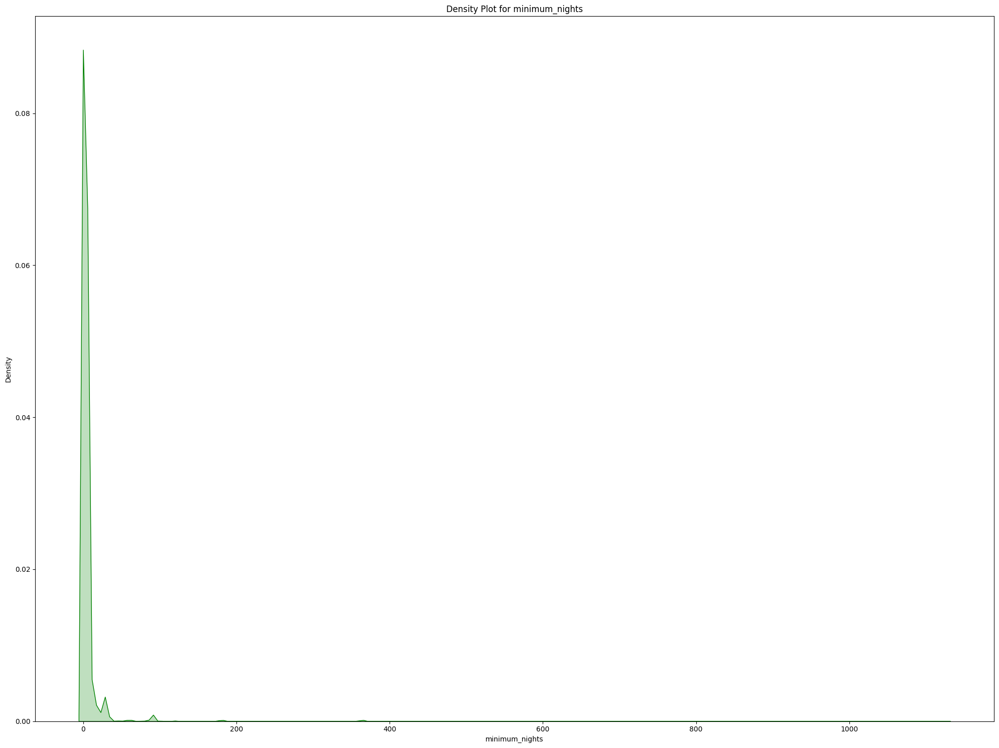

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


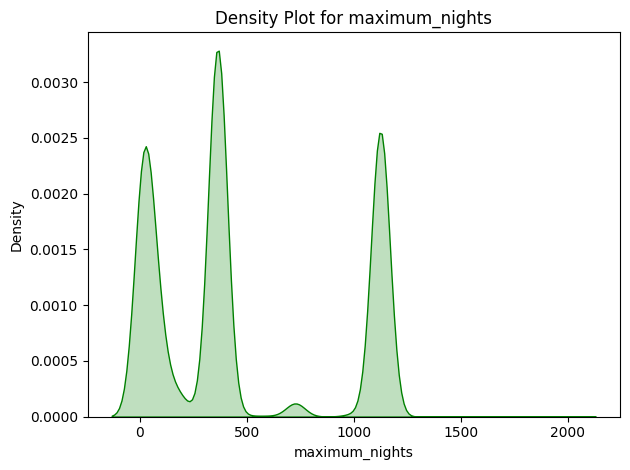

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


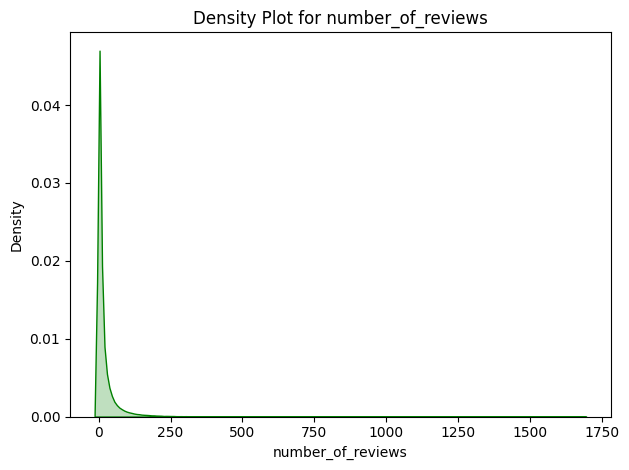


Density Plot for sanfrancisco:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


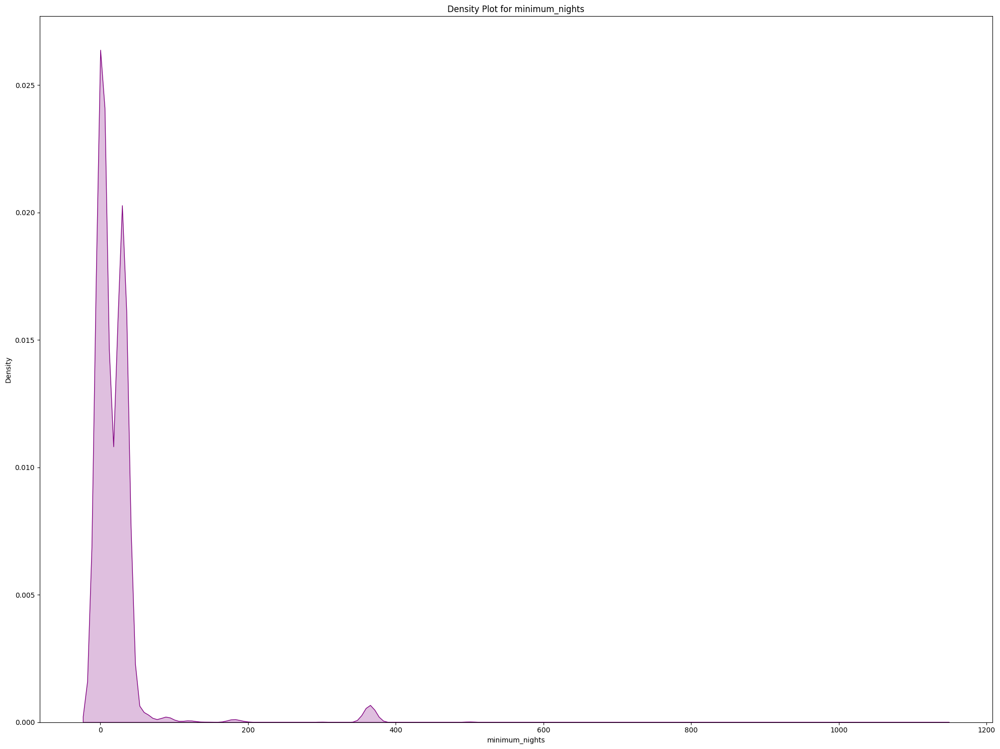

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


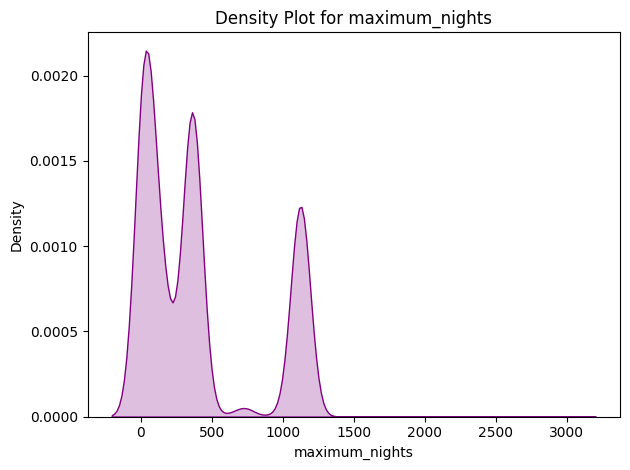

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


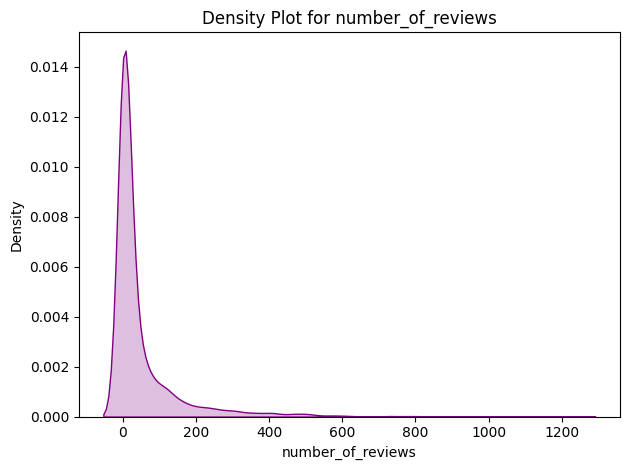


Density Plot for toronto:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


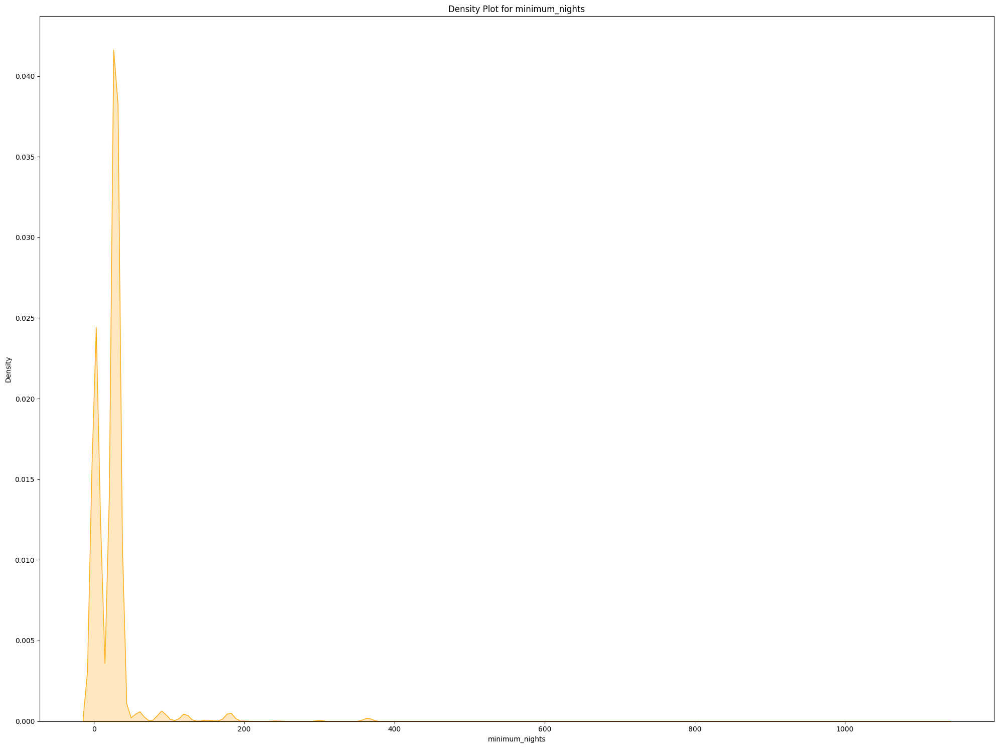

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


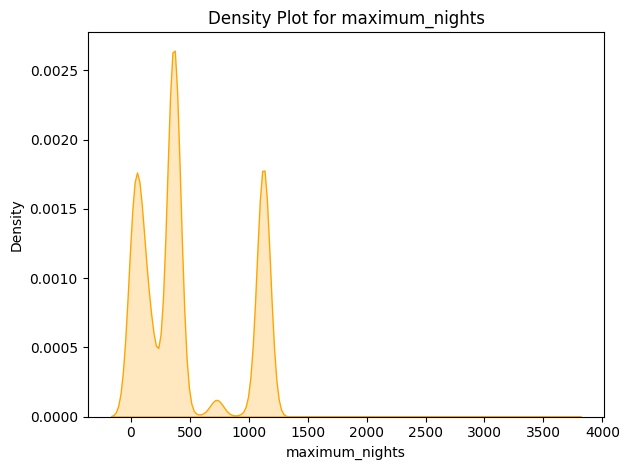

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


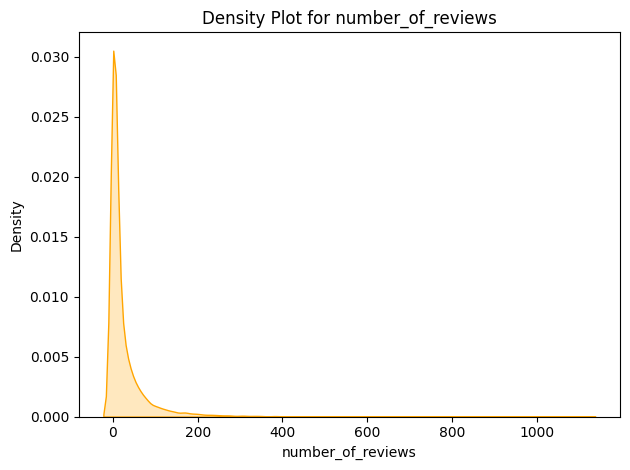

In [234]:
density_plots(listing_df,feature_two,city_data)


Density Plot for amsterdam:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


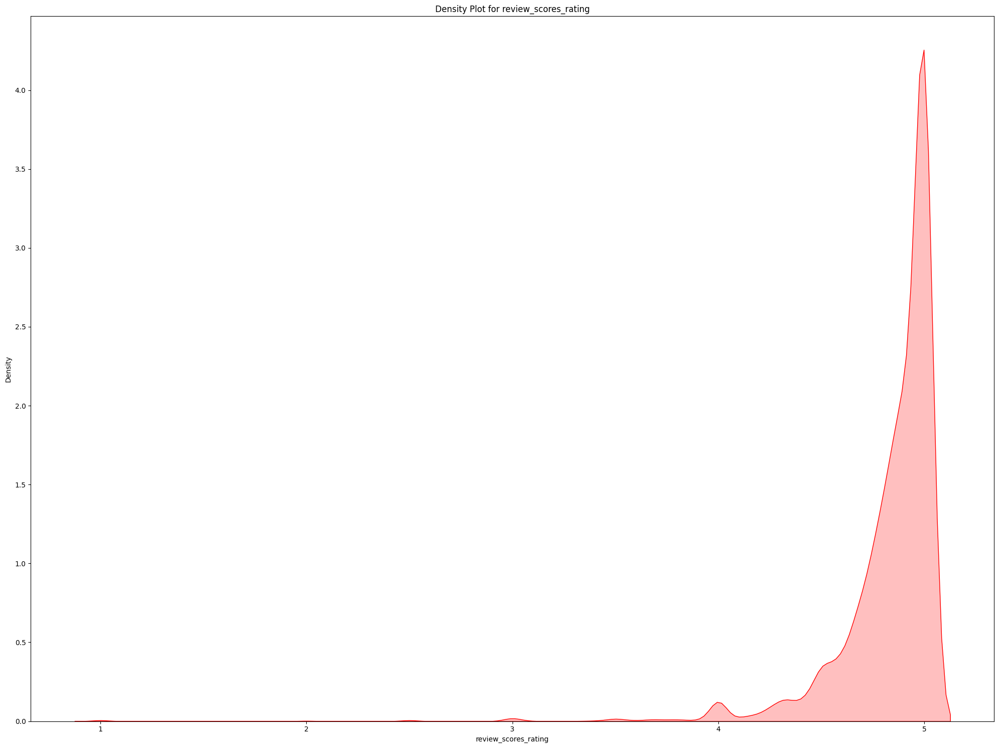


Density Plot for newyork:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


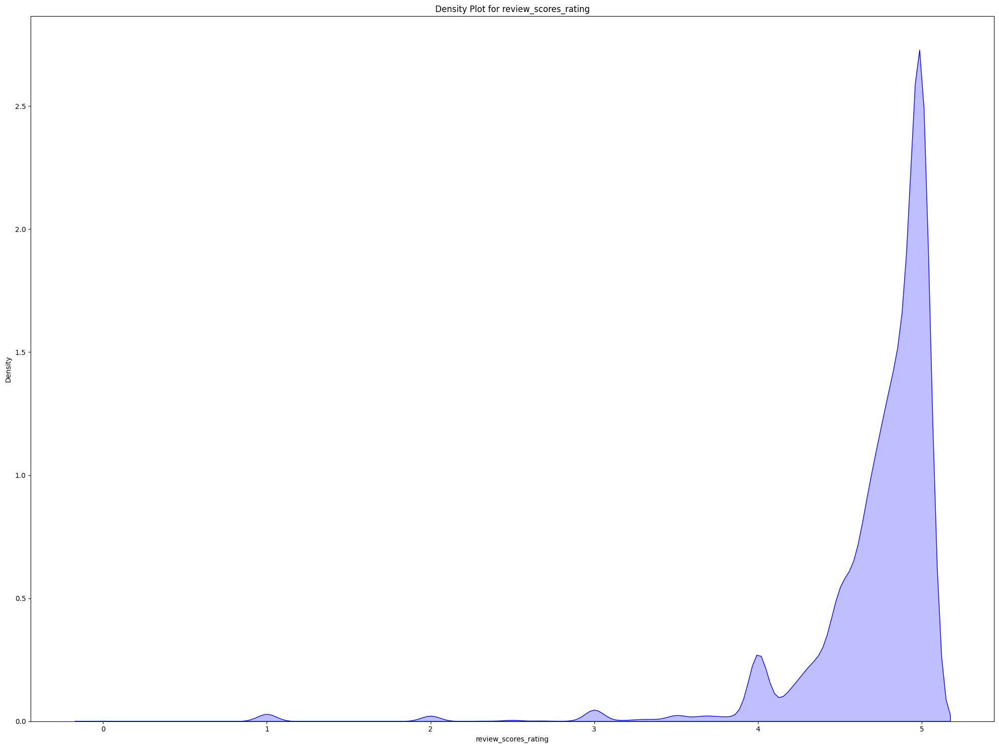


Density Plot for london:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


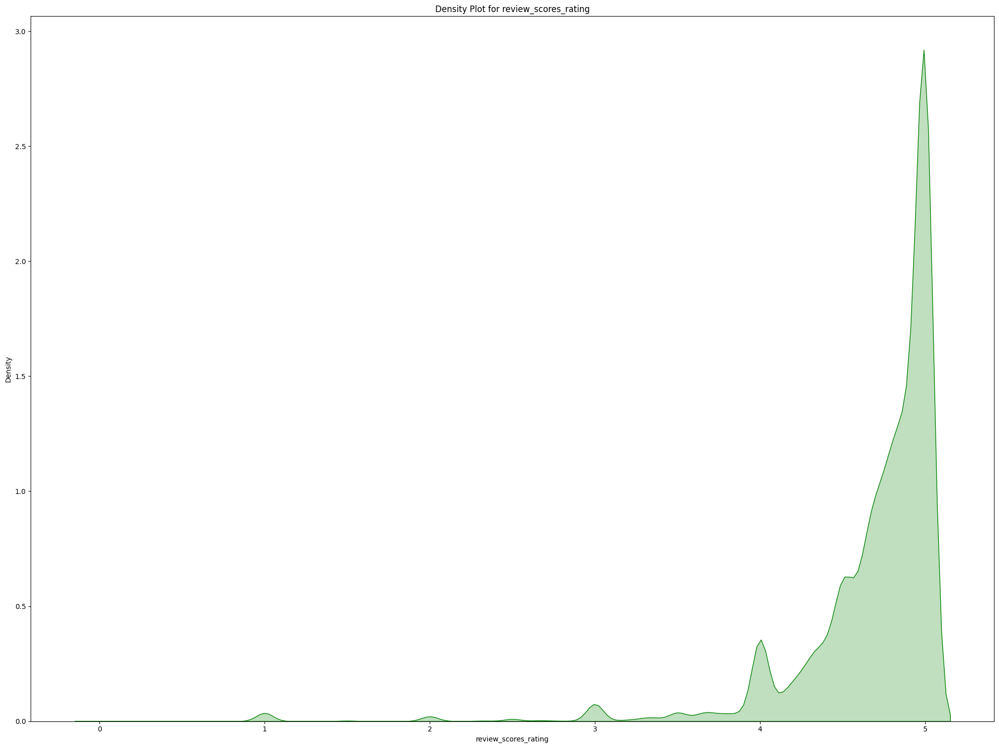


Density Plot for sanfrancisco:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


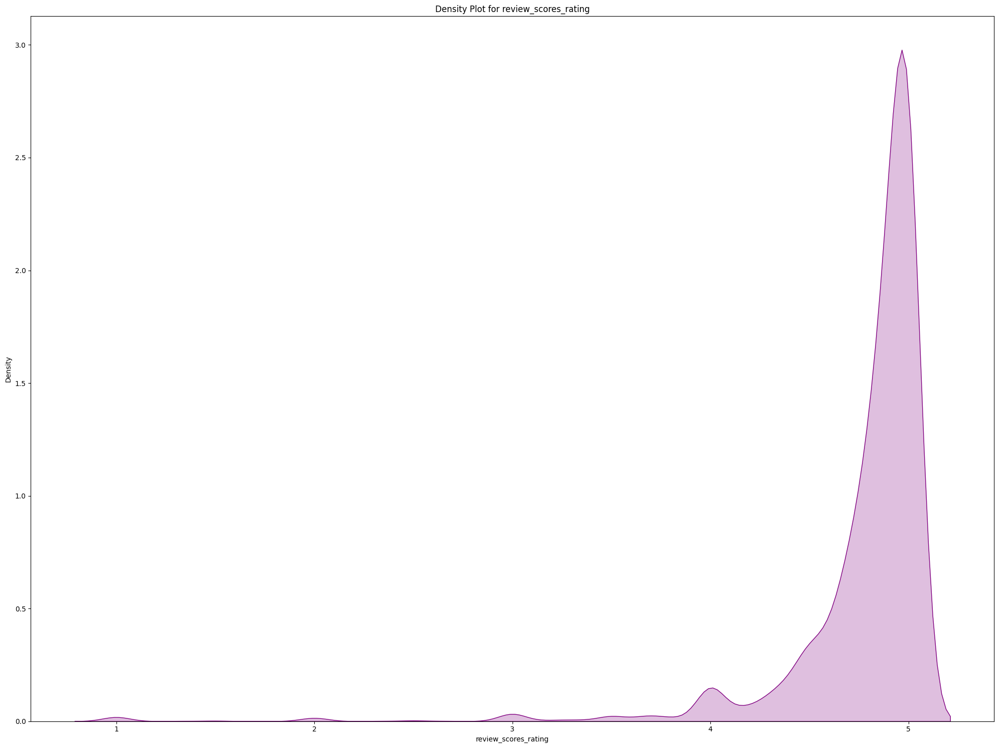


Density Plot for toronto:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


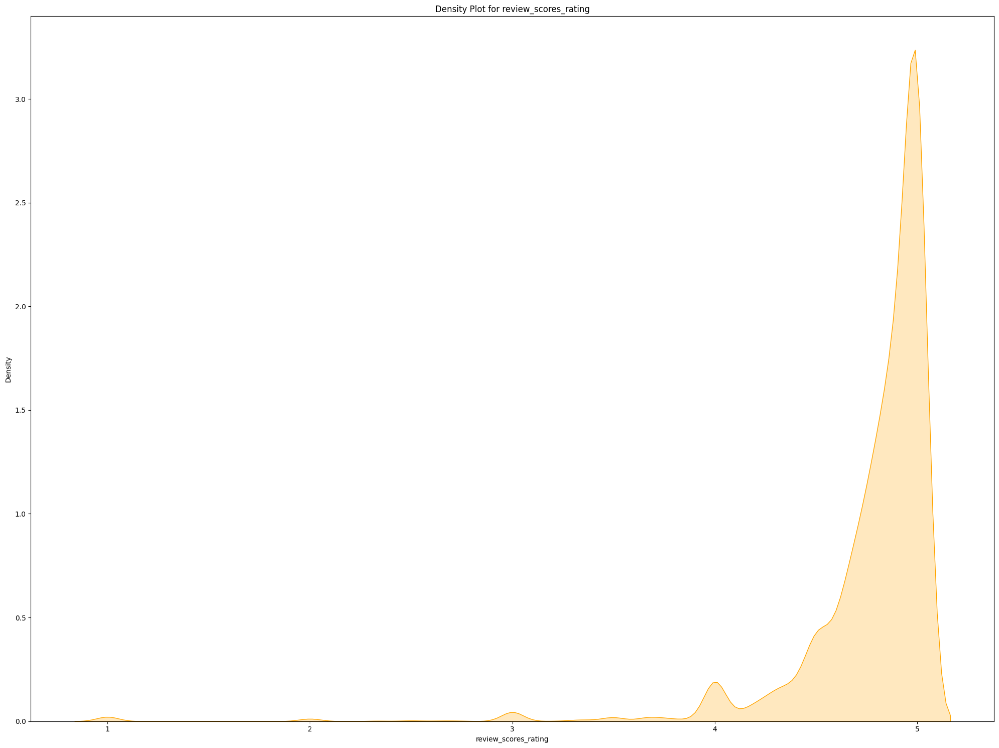

In [235]:
density_plots(listing_review_score_df,feature_three,city_data)

# Task 6 - Outlier Detection

# Technique 1 - Using Inter Quartile Range

In [105]:
def identify_outliers_iqr(df, feature):
    # Calculate Q1 (25th percentile) and Q3 (75th percentile)
    Q1 = df[feature].quantile(0.25)
    Q3 = df[feature].quantile(0.75)
    
    # Calculate IQR
    IQR = Q3 - Q1
    
    # Determine lower and upper bounds
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    # Identify outliers
    outliers = df[(df[feature] < lower_bound) | (df[feature] > upper_bound)]
    
    return outliers, lower_bound, upper_bound

def visualize_outliers_boxplot(df, features, city_data,limit,range):
    counter = 0
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        print(f"\nDensity Plot for {city_name}:")
        
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]

        color = colors[counter]
        counter = counter + 1 
        for i, feature in enumerate(features):
            # Identify outliers using IQR
            outliers, lower_bound, upper_bound = identify_outliers_iqr(city_df, feature)
            
            # Print the outliers and bounds
            print(f"Lower Bound: {lower_bound}, Upper Bound: {upper_bound}")
            print("Outliers:")
            print(outliers[feature])
            
            # Create a box plot
            plt.figure(figsize=(20, 6))
            sns.boxplot(x=df[feature], color=color)
            plt.title(f'Box Plot for {feature.capitalize()}')
            plt.xlabel(feature.capitalize())

            # Set x-axis limits to be in multiples of 500
            plt.xlim(0,limit)

            # Set x-ticks to be in multiples of 500
            ticks = np.arange(0, limit, range)
            plt.xticks(ticks)
            
            # Show the plot
            plt.show()


Density Plot for amsterdam:
Lower Bound: -71.5, Upper Bound: 556.5
Outliers:
34      599.0
161     650.0
223     900.0
262     653.0
323     850.0
        ...  
9589    585.0
9598    800.0
9610    625.0
9619    750.0
9639    581.0
Name: price, Length: 318, dtype: float64


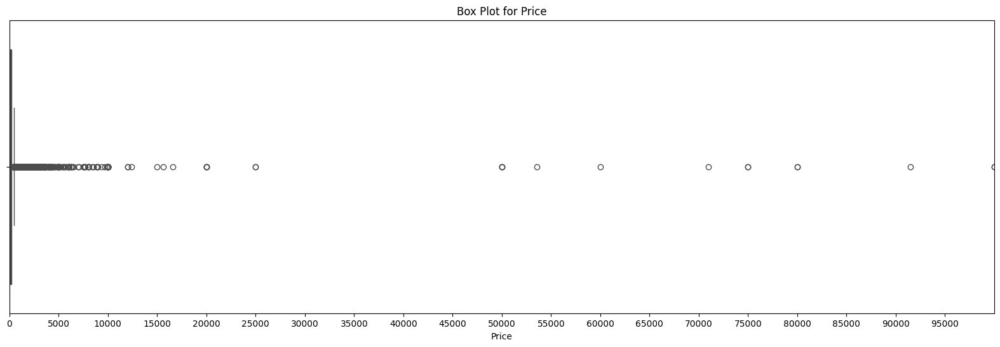


Density Plot for newyork:
Lower Bound: -162.5, Upper Bound: 497.5
Outliers:
9678      900.0
9685      602.0
9776      600.0
9878      600.0
9881      529.0
          ...  
46955     513.0
46969     646.0
47006    2000.0
47108     550.0
47175     700.0
Name: price, Length: 1771, dtype: float64


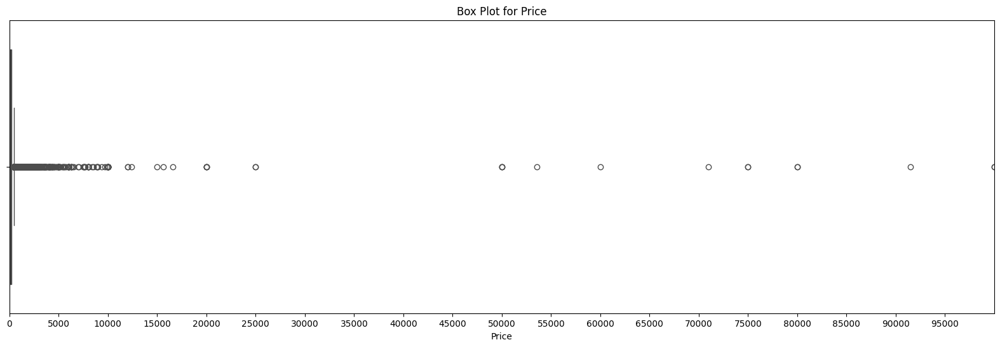


Density Plot for london:
Lower Bound: -126.5, Upper Bound: 413.5
Outliers:
47202      493.0
47242     1300.0
47283      543.0
47325      696.0
47372      476.0
           ...  
143193     450.0
143325    1000.0
143331    1070.0
143332     827.0
143342     457.0
Name: price, Length: 4158, dtype: float64


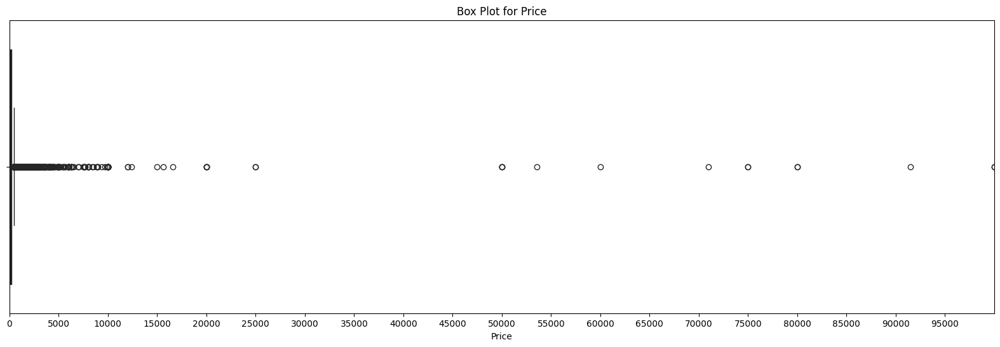


Density Plot for sanfrancisco:
Lower Bound: -114.5, Upper Bound: 457.5
Outliers:
143437     1500.0
143467      950.0
143474      500.0
143477     4950.0
143504      630.0
           ...   
151165      528.0
151176     1000.0
151178      545.0
151180      631.0
151185    10000.0
Name: price, Length: 459, dtype: float64


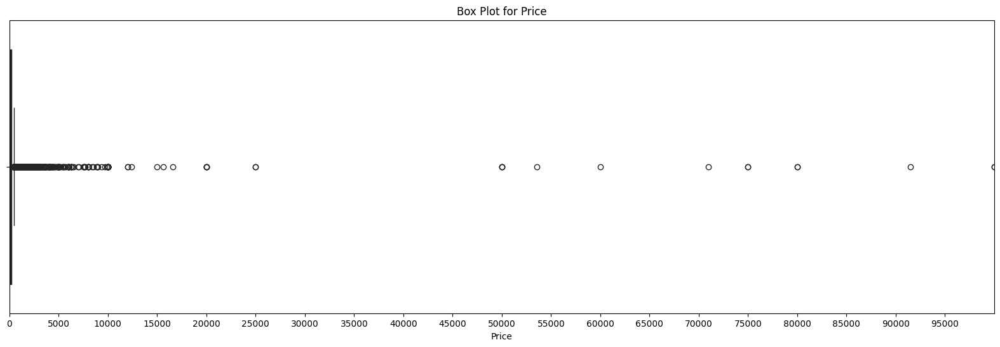


Density Plot for toronto:
Lower Bound: -152.5, Upper Bound: 467.5
Outliers:
151282     500.0
151298    1000.0
151306     475.0
151307     470.0
151397     499.0
           ...  
172934     800.0
172962     591.0
172963     611.0
172998     479.0
173002     999.0
Name: price, Length: 928, dtype: float64


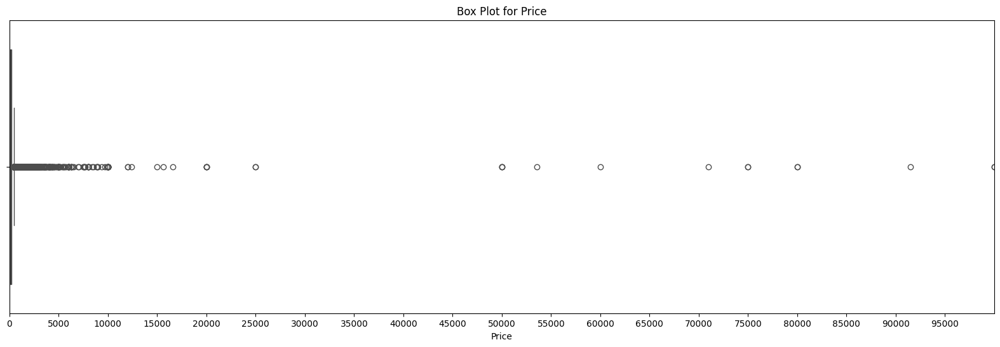

In [106]:
visualize_outliers_boxplot(listing_price_df, feature_one, city_data,100000,5000)


Density Plot for amsterdam:
Lower Bound: -1.0, Upper Bound: 7.0
Outliers:
14      21
60      25
93      10
136     15
150     22
        ..
9596    10
9599    10
9635    30
9643    28
9651    30
Name: minimum_nights, Length: 380, dtype: int64


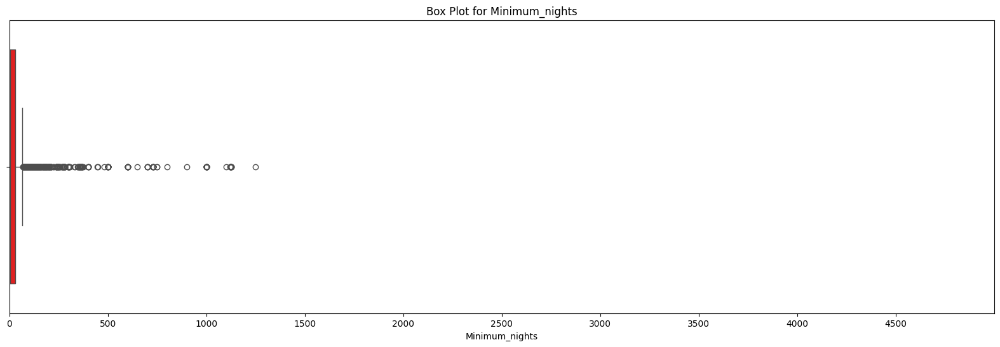

Lower Bound: -497.5, Upper Bound: 882.5
Outliers:
0       1125
1       1125
2       1125
4       1125
8       1125
        ... 
9597    1125
9610    1125
9611    1125
9624    1125
9656    1125
Name: maximum_nights, Length: 1811, dtype: int64


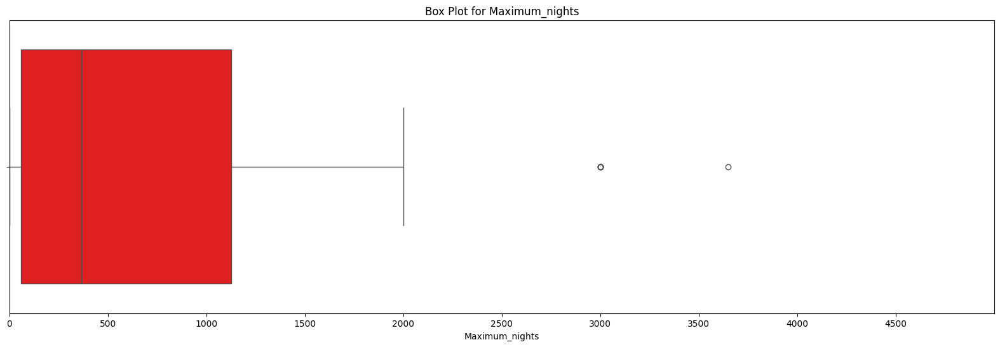


Density Plot for newyork:
Lower Bound: 30.0, Upper Bound: 30.0
Outliers:
9659      31
9662     120
9671       1
9675      60
9685       1
        ... 
47178    198
47183      5
47186     31
47196      2
47197      1
Name: minimum_nights, Length: 7405, dtype: int64


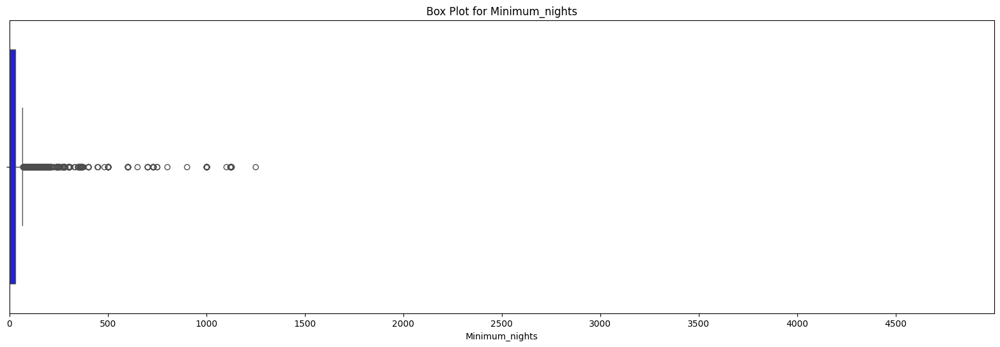

Lower Bound: -1312.5, Upper Bound: 2587.5
Outliers:
18320    3000
30134    3000
Name: maximum_nights, dtype: int64


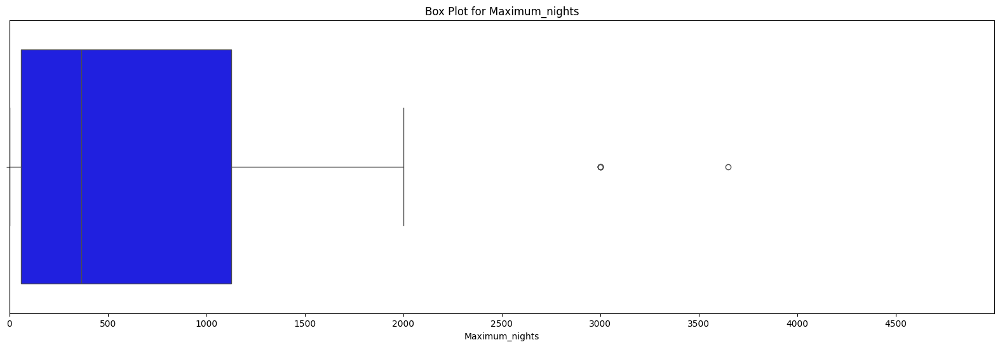


Density Plot for london:
Lower Bound: -3.5, Upper Bound: 8.5
Outliers:
47209      30
47235      30
47242      14
47252     180
47257      14
         ... 
143357    360
143359     28
143361    277
143362    277
143368     14
Name: minimum_nights, Length: 7238, dtype: int64


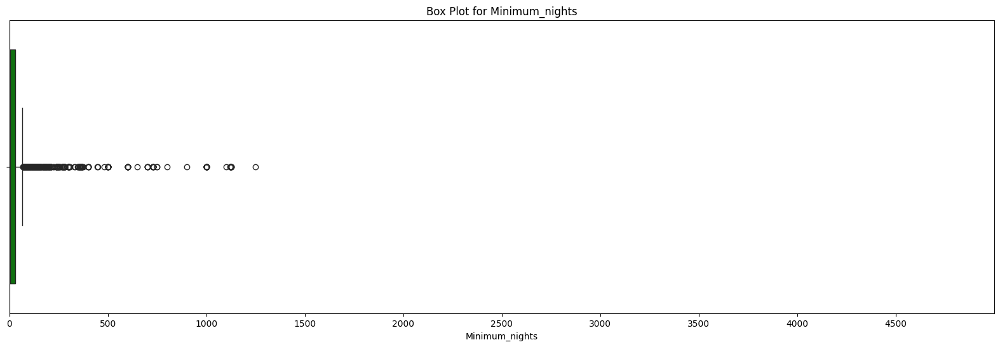

Lower Bound: -1537.5, Upper Bound: 2722.5
Outliers:
Series([], Name: maximum_nights, dtype: int64)


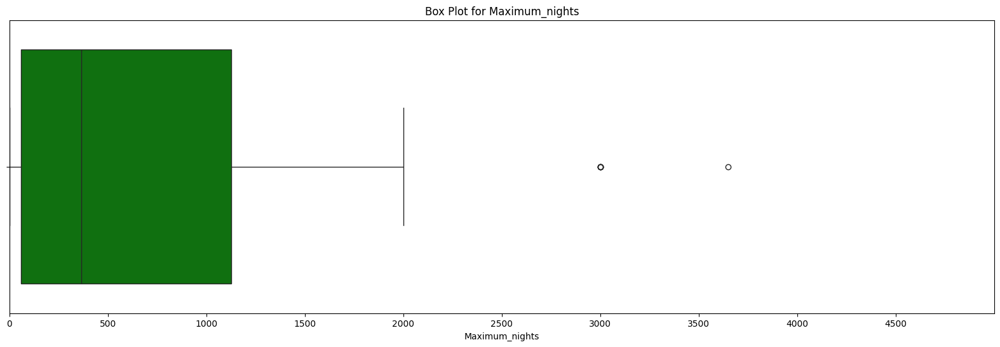


Density Plot for sanfrancisco:
Lower Bound: -40.0, Upper Bound: 72.0
Outliers:
143423    180
143495    365
143823    180
143824    365
143827    365
         ... 
150970     90
151038    365
151044    365
151144    360
151145    365
Name: minimum_nights, Length: 182, dtype: int64


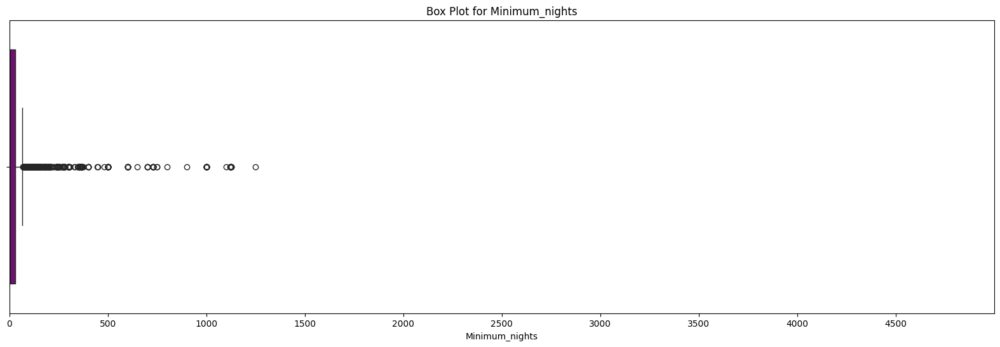

Lower Bound: -472.5, Upper Bound: 867.5
Outliers:
143388    1125
143389    1125
143390    1125
143391    1125
143392    1125
          ... 
151134    1125
151170    1125
151183    1110
151184    1125
151187    1125
Name: maximum_nights, Length: 1684, dtype: int64


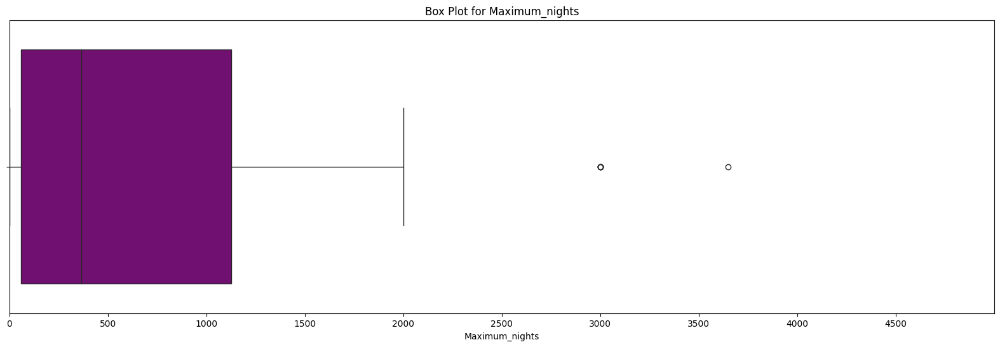


Density Plot for toronto:
Lower Bound: -37.0, Upper Bound: 67.0
Outliers:
151190    180
151192     90
151193    180
151194    750
151200     91
         ... 
172661    200
172669    200
172920     90
172921     90
172981    180
Name: minimum_nights, Length: 676, dtype: int64


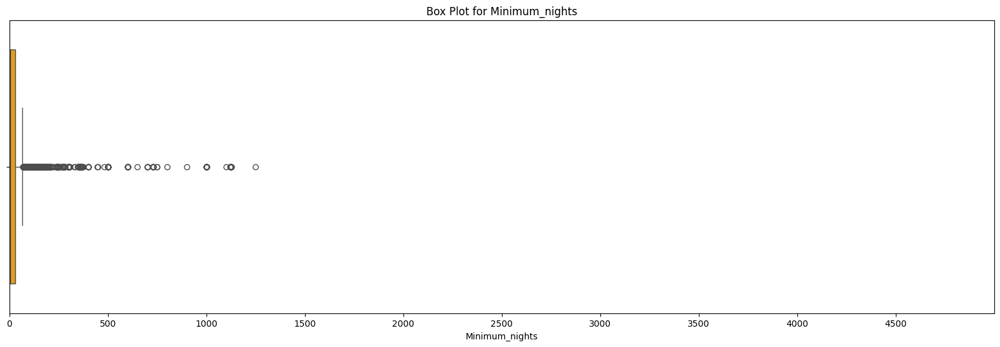

Lower Bound: -1461.0, Upper Bound: 2675.0
Outliers:
151653    3000
152627    3000
153337    3650
Name: maximum_nights, dtype: int64


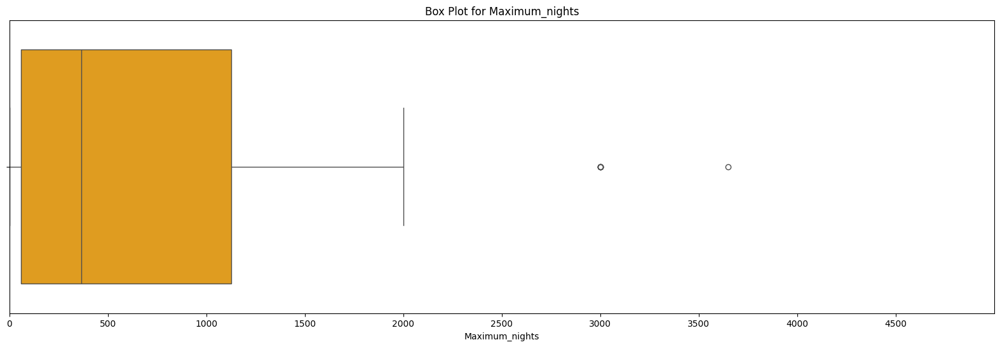

In [107]:
feature_two_updated = ['minimum_nights','maximum_nights']
visualize_outliers_boxplot(listing_df, feature_two_updated, city_data,5000,500)


Density Plot for amsterdam:
Lower Bound: 4.450000000000001, Upper Bound: 5.33
Outliers:
13      4.00
16      4.33
24      4.43
109     4.26
127     4.20
        ... 
9575    4.00
9587    4.00
9609    4.27
9615    4.00
9650    3.67
Name: review_scores_rating, Length: 486, dtype: float64


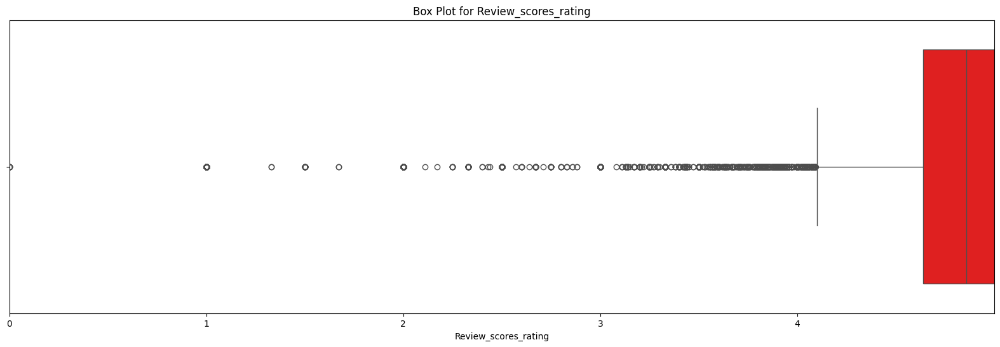


Density Plot for newyork:
Lower Bound: 4.1, Upper Bound: 5.540000000000001
Outliers:
9667     4.0
9698     4.0
9709     2.0
9729     3.0
9738     4.0
        ... 
47132    4.0
47147    3.0
47152    4.0
47159    4.0
47195    3.8
Name: review_scores_rating, Length: 1754, dtype: float64


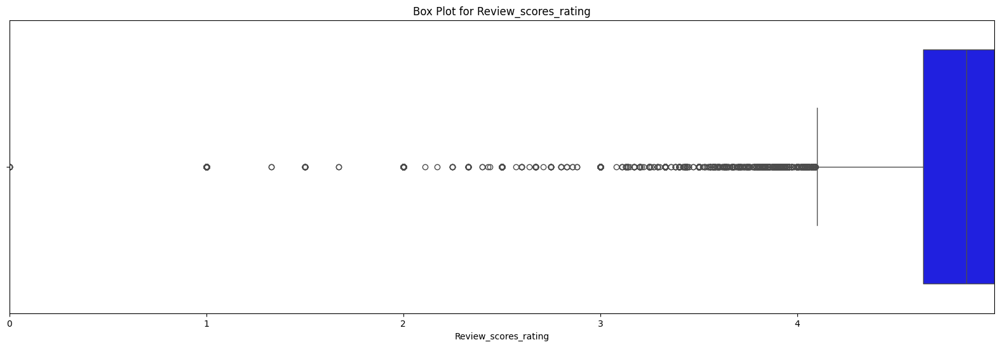


Density Plot for london:
Lower Bound: 3.9250000000000007, Upper Bound: 5.645
Outliers:
47342     3.88
47728     0.00
47895     3.90
47964     0.00
48055     3.67
          ... 
141546    3.50
141649    3.00
142038    3.00
142086    2.50
142167    2.00
Name: review_scores_rating, Length: 2780, dtype: float64


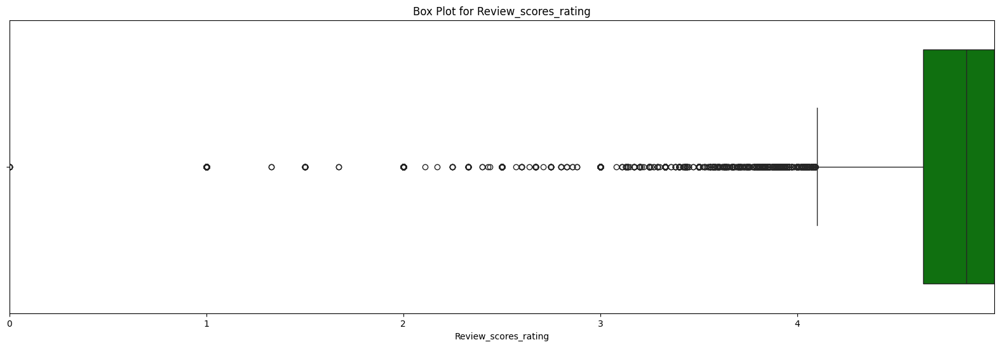


Density Plot for sanfrancisco:
Lower Bound: 4.375, Upper Bound: 5.375
Outliers:
143388    4.20
143389    4.11
143415    4.33
143417    4.36
143419    4.00
          ... 
151147    4.00
151148    1.00
151163    3.00
151171    3.67
151172    4.00
Name: review_scores_rating, Length: 460, dtype: float64


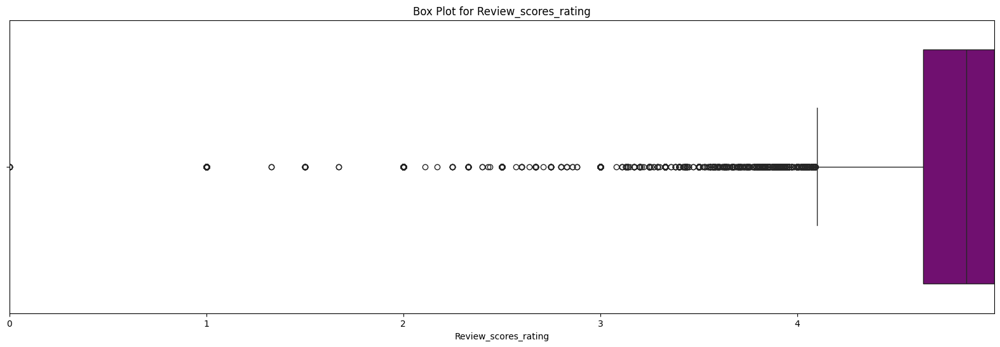


Density Plot for toronto:
Lower Bound: 4.325000000000001, Upper Bound: 5.404999999999999
Outliers:
151196    4.18
151197    4.17
151221    4.12
151242    4.21
151253    3.80
          ... 
172653    4.00
172682    3.50
172702    4.00
172718    4.00
172783    3.50
Name: review_scores_rating, Length: 1096, dtype: float64


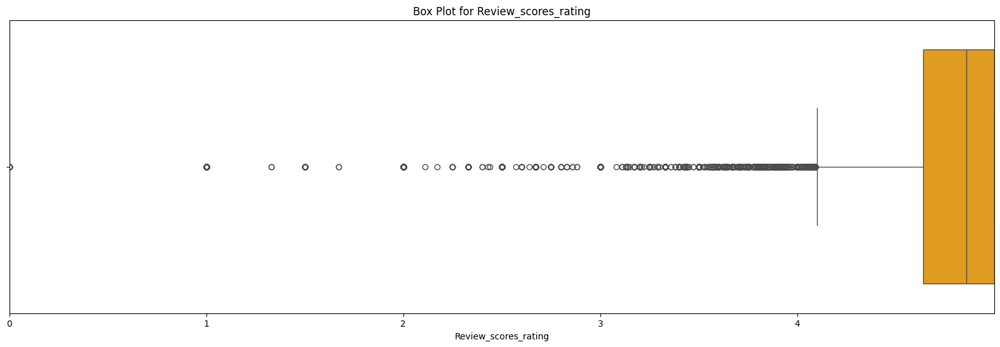

In [108]:
visualize_outliers_boxplot(listing_review_score_df, feature_three, city_data,5,1)

# Task 6 - Outlier Detection

# Technique 2 - Z-Score

In [123]:

def calculate_z_score(df,features):
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        print(f"\nZ-score for {city_name}:")
        
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]

        for i, feature in enumerate(features):
            # Calculate Z-scores for the price column
            city_df['zscore'] = stats.zscore(city_df[feature])

            # Identify outliers based on Z-scores
            outlier_city_df = city_df[(city_df['zscore'] > 3) | (city_df['zscore'] < -3)]

            # Display the outliers
            print(outlier_city_df[[feature,'zscore']])

In [124]:
calculate_z_score(listing_price_df,feature_one)


Z-score for amsterdam:
        price     zscore
2963  10000.0   7.981024
4534  91466.0  74.938588
4940   5000.0   3.871484
7809   7051.0   5.557217

Z-score for newyork:
          price     zscore
10830    9999.0   9.577073
11611    4320.0   4.007996
11869   10000.0   9.578054
11896    8403.0   8.011966
12039    4000.0   3.694190
12104    6000.0   5.655478
12799    3600.0   3.301933
13995    3300.0   3.007740
17792  100000.0  97.836009
18449  100000.0  97.836009
18900   10000.0   9.578054
19042   20000.0  19.384493
19048    3300.0   3.007740
19329   20000.0  19.384493
19358   20000.0  19.384493
22898    7500.0   7.126444
23166    3600.0   3.301933
23438   10000.0   9.578054
23882    3804.0   3.501984
24093    5000.0   4.674834
24600    3600.0   3.301933
24648   10000.0   9.578054
26724    3780.0   3.478449
26833    7600.0   7.224509
27057    8550.0   8.156120
27096    8000.0   7.616766
27195    3600.0   3.301933
32462    4100.0   3.792255
35481    5000.0   4.674834
37549    3600.0   3

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_df['zscore'] = stats.zscore(city_df[feature])
/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_df['zscore'] = stats.zscore(city_df[feature])
/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

In [125]:
calculate_z_score(listing_df,feature_two_updated)


Z-score for amsterdam:
      minimum_nights     zscore
334              364  18.130630
951              100   4.826877
1216             299  14.855085
1389             363  18.080237
1851             100   4.826877
2351             800  40.101980
2783             444  22.162070
3024             364  18.130630
3536             363  18.080237
3649             150   7.346527
3794             120   5.834737
3904             365  18.181023
3905             120   5.834737
4036             100   4.826877
4094             356  17.727486
4242              90   4.322947
4706              90   4.322947
5091            1001  50.230974
5575              90   4.322947
6097              91   4.373340
6152              90   4.322947
6211              90   4.322947
6228              75   3.567052
6425             300  14.905478
7011             240  11.881897
7356              84   4.020589
7750             120   5.834737
7751             120   5.834737
8466             729  36.524077
8673            

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_df['zscore'] = stats.zscore(city_df[feature])
/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_df['zscore'] = stats.zscore(city_df[feature])
/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

In [126]:
calculate_z_score(listing_review_score_df,feature_three)


Z-score for amsterdam:
      review_scores_rating     zscore
13                    4.00  -3.270390
174                   1.00 -14.951418
206                   3.00  -7.164066
208                   4.00  -3.270390
248                   4.00  -3.270390
...                    ...        ...
9535                  3.80  -4.049125
9575                  4.00  -3.270390
9587                  4.00  -3.270390
9615                  4.00  -3.270390
9650                  3.67  -4.555303

[184 rows x 2 columns]

Z-score for newyork:
       review_scores_rating    zscore
9709                   2.00 -6.154248
9729                   3.00 -3.895985
9880                   1.00 -8.412511
10168                  2.67 -4.641212
10347                  2.50 -5.025116
...                     ...       ...
46375                  3.00 -3.895985
46457                  2.50 -5.025116
46763                  1.00 -8.412511
46766                  1.00 -8.412511
47147                  3.00 -3.895985

[449 rows x 2 col

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_df['zscore'] = stats.zscore(city_df[feature])
/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  city_df['zscore'] = stats.zscore(city_df[feature])
/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/4098063341.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a s

# Task 6 - Outlier Detection

# Technique 3 - Filtering values within 5th - 95th percentile

In [150]:
def eliminate_outliers(df,features,city_data):
    filtered_data = []
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]
        print(f'Detecting outliers for {city_name}:')
        for i, feature in enumerate(features):
            feature_column = city_df[feature]

            # Calculate the 5th and 95th percentiles
            fifth_percentile = feature_column.quantile(0.05)
            ninety_fifth_percentile = feature_column.quantile(0.95)

            print(f'Lower Bound for {feature}:',fifth_percentile)
            print(f'Upper Bound for {feature}:',ninety_fifth_percentile)

            city_df = city_df[(feature_column >= fifth_percentile) & (feature_column <= ninety_fifth_percentile)]

            print('Filtered Data:')
            print(city_df[feature])
            print(city_df.shape)

            filtered_data.append(city_df)

    return pd.concat(filtered_data, ignore_index=True)

In [151]:
filtered_listing_price_df = eliminate_outliers(listing_price_df,feature_one,city_data)

Detecting outliers for amsterdam:
Lower Bound for price: 92.40000000000003
Upper Bound for price: 585.5999999999995
Filtered Data:
10      269.0
31      254.0
32      203.0
33      375.0
36      109.0
        ...  
9654    125.0
9655    196.0
9656    409.0
9657    349.0
9658    395.0
Name: price, Length: 5281, dtype: float64
(5281, 61)
Detecting outliers for newyork:
Lower Bound for price: 44.0
Upper Bound for price: 614.0
Filtered Data:
9659      89.0
9660      45.0
9661     107.0
9662     140.0
9663     340.0
         ...  
47194    110.0
47195     65.0
47196    367.0
47197     89.0
47198    185.0
Name: price, Length: 20538, dtype: float64
(20538, 61)
Detecting outliers for london:
Lower Bound for price: 40.0
Upper Bound for price: 481.0
Filtered Data:
47200      59.0
47201     120.0
47203     190.0
47204     140.0
47205      40.0
          ...  
143377    243.0
143378    140.0
143379    103.0
143380    140.0
143381    129.0
Name: price, Length: 57482, dtype: float64
(57482, 61)
Dete

In [152]:
filtered_listing_df = eliminate_outliers(listing_df,feature_two_updated,city_data)

Detecting outliers for amsterdam:
Lower Bound for minimum_nights: 1.0
Upper Bound for minimum_nights: 7.0
Filtered Data:
0       2
1       2
2       3
3       3
4       1
       ..
9654    1
9655    2
9656    3
9657    4
9658    1
Name: minimum_nights, Length: 9279, dtype: int64
(9279, 61)
Lower Bound for maximum_nights: 5.0
Upper Bound for maximum_nights: 1125.0
Filtered Data:
0       1125
1       1125
2       1125
3         21
4       1125
        ... 
9654     365
9655      15
9656    1125
9657     365
9658     365
Name: maximum_nights, Length: 8956, dtype: int64
(8956, 61)
Detecting outliers for newyork:
Lower Bound for minimum_nights: 1.0
Upper Bound for minimum_nights: 31.0
Filtered Data:
9659     31
9660     30
9661     30
9663     30
9664     30
         ..
47195    30
47196     2
47197     1
47198    30
47199    30
Name: minimum_nights, Length: 36512, dtype: int64
(36512, 61)
Lower Bound for maximum_nights: 30.0
Upper Bound for maximum_nights: 1125.0
Filtered Data:
9659       

In [153]:
filtered_listing_review_score_df = eliminate_outliers(listing_review_score_df,feature_three,city_data)

Detecting outliers for amsterdam:
Lower Bound for review_scores_rating: 4.42
Upper Bound for review_scores_rating: 5.0
Filtered Data:
0       4.84
2       4.71
3       5.00
4       4.61
5       4.97
        ... 
9646    5.00
9649    4.83
9651    5.00
9653    4.62
9656    5.00
Name: review_scores_rating, Length: 8206, dtype: float64
(8206, 61)
Detecting outliers for newyork:
Lower Bound for review_scores_rating: 4.0
Upper Bound for review_scores_rating: 5.0
Filtered Data:
9660     4.83
9667     4.00
9670     5.00
9671     4.26
9672     5.00
         ... 
47192    5.00
47194    4.85
47196    4.88
47197    4.32
47199    4.21
Name: review_scores_rating, Length: 25275, dtype: float64
(25275, 61)
Detecting outliers for london:
Lower Bound for review_scores_rating: 4.0
Upper Bound for review_scores_rating: 5.0
Filtered Data:
47200     4.82
47201     4.80
47202     4.77
47203     4.90
47204     4.37
          ... 
143081    5.00
143164    5.00
143225    5.00
143276    5.00
143306    5.00
Name:

# Task 1 - After Outlier Detection

In [219]:
summarize_city_statistics(filtered_listing_price_df,feature_one,city_data)


Summary Statistics for amsterdam:
price Summary Statistics:
count    5281.0000
mean      249.5338
std       104.8712
min        93.0000
25%       171.0000
50%       225.0000
75%       300.0000
max       585.0000
Name: price, dtype: float64

Summary Statistics for newyork:
price Summary Statistics:
count    20538.000000
mean       181.306651
std        123.499060
min         44.000000
25%         90.000000
50%        147.000000
75%        238.000000
max        614.000000
Name: price, dtype: float64

Summary Statistics for london:
price Summary Statistics:
count    57482.000000
mean       152.946836
std         93.442019
min         40.000000
25%         80.000000
50%        130.000000
75%        200.000000
max        481.000000
Name: price, dtype: float64

Summary Statistics for sanfrancisco:
price Summary Statistics:
count    5557.000000
mean      180.255354
std       104.926268
min        55.000000
25%       105.000000
50%       150.000000
75%       229.000000
max       575.000000
Na

In [220]:
summarize_city_statistics(filtered_listing_df,feature_two,city_data)


Summary Statistics for amsterdam:
minimum_nights Summary Statistics:
count    18235.00000
mean         2.77620
std          1.43866
min          1.00000
25%          2.00000
50%          3.00000
75%          3.00000
max          7.00000
Name: minimum_nights, dtype: float64
maximum_nights Summary Statistics:
count    18235.000000
mean       328.565122
std        421.663082
min          1.000000
25%         20.000000
50%         31.000000
75%        365.000000
max       1125.000000
Name: maximum_nights, dtype: float64
number_of_reviews Summary Statistics:
count    18235.000000
mean        47.167370
std        121.285082
min          0.000000
25%          3.000000
50%         10.000000
75%         33.000000
max       4130.000000
Name: number_of_reviews, dtype: float64

Summary Statistics for newyork:
minimum_nights Summary Statistics:
count    71626.000000
mean        26.512984
std          9.324882
min          1.000000
25%         30.000000
50%         30.000000
75%         30.000000
m

In [221]:
summarize_city_statistics(filtered_listing_review_score_df,feature_three,city_data)


Summary Statistics for amsterdam:
review_scores_rating Summary Statistics:
count    8206.000000
mean        4.882083
std         0.141367
min         4.420000
25%         4.800000
50%         4.930000
75%         5.000000
max         5.000000
Name: review_scores_rating, dtype: float64

Summary Statistics for newyork:
review_scores_rating Summary Statistics:
count    25275.000000
mean         4.779998
std          0.258520
min          4.000000
25%          4.670000
50%          4.860000
75%          5.000000
max          5.000000
Name: review_scores_rating, dtype: float64

Summary Statistics for london:
review_scores_rating Summary Statistics:
count    68801.000000
mean         4.759880
std          0.275524
min          4.000000
25%          4.630000
50%          4.850000
75%          5.000000
max          5.000000
Name: review_scores_rating, dtype: float64

Summary Statistics for sanfrancisco:
review_scores_rating Summary Statistics:
count    5731.000000
mean        4.857569
std    

# Task 2 - Plotting Histogram After Outlier Detetion


Histogram for amsterdam:


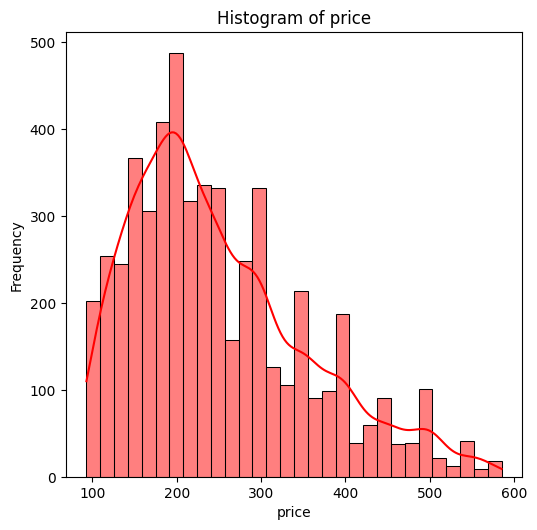


Histogram for newyork:


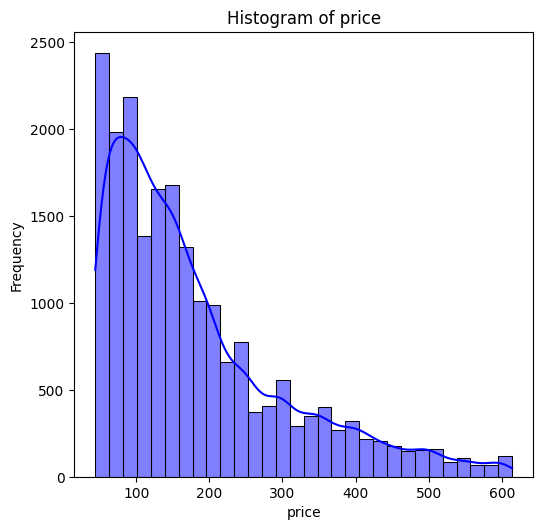


Histogram for london:


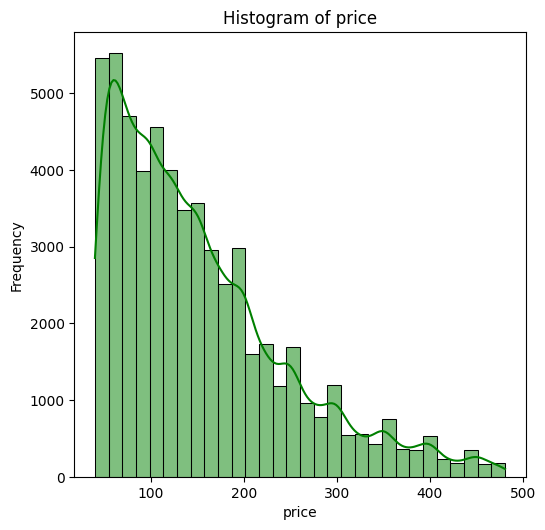


Histogram for sanfrancisco:


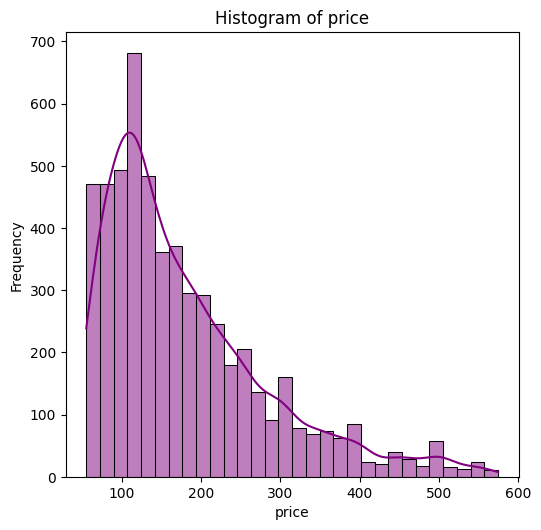


Histogram for toronto:


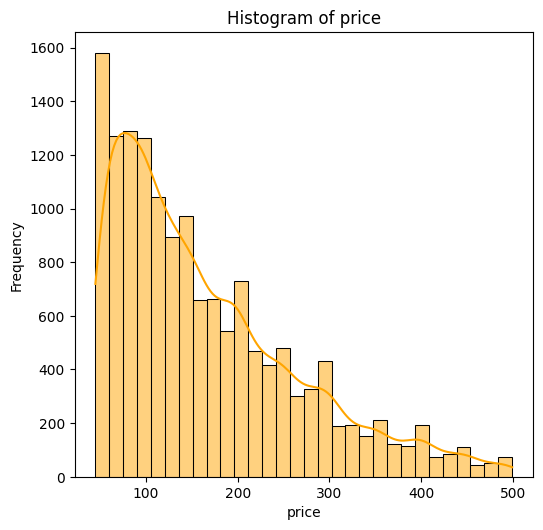

In [222]:
plotting_histogram(filtered_listing_price_df,feature_one,city_data)


Histogram for amsterdam:


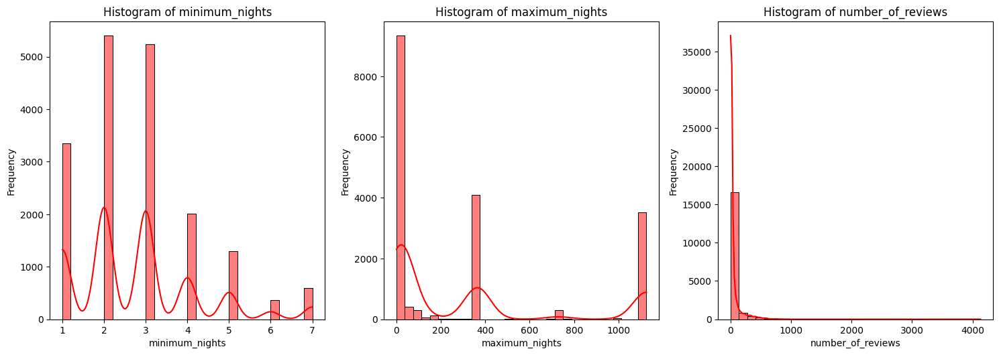


Histogram for newyork:


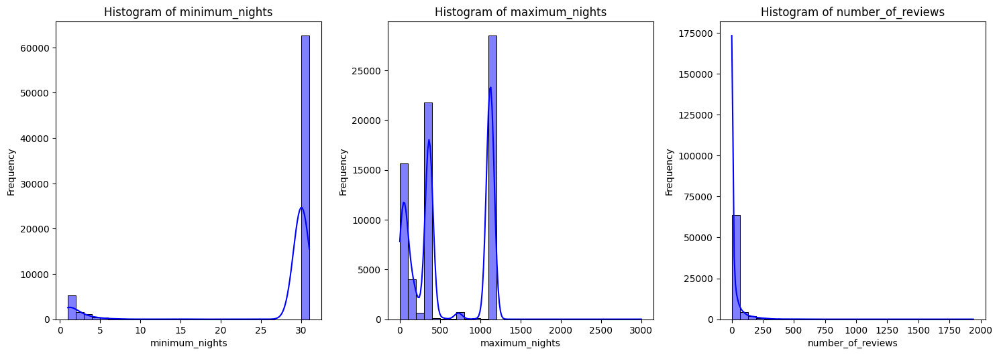


Histogram for london:


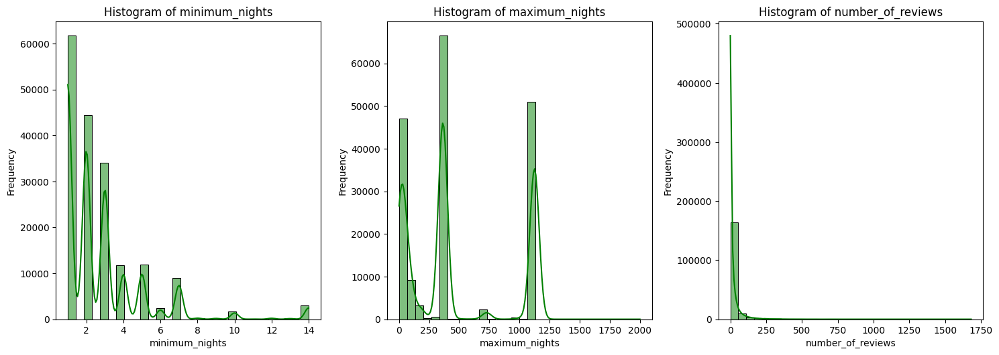


Histogram for sanfrancisco:


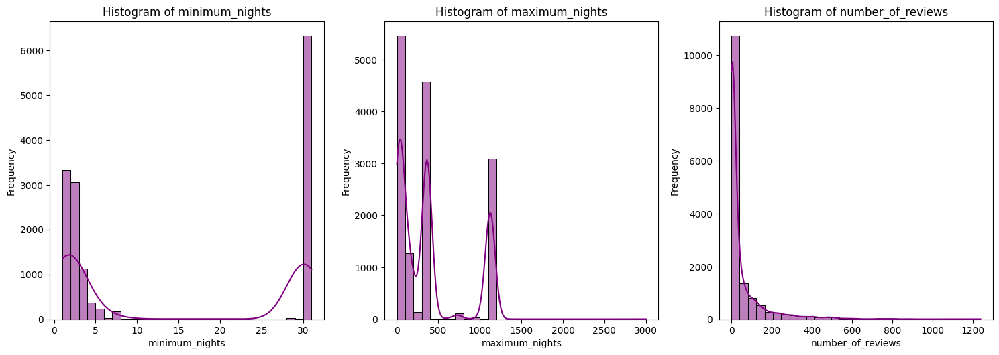


Histogram for toronto:


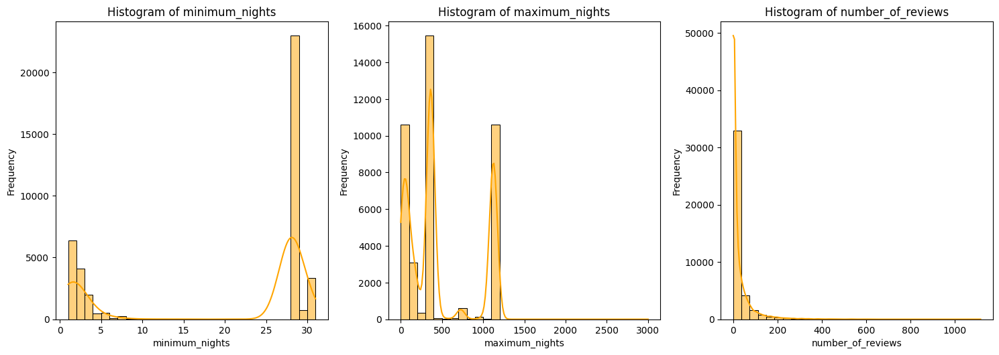

In [225]:
plotting_histogram(filtered_listing_df,feature_two,city_data)


Histogram for amsterdam:


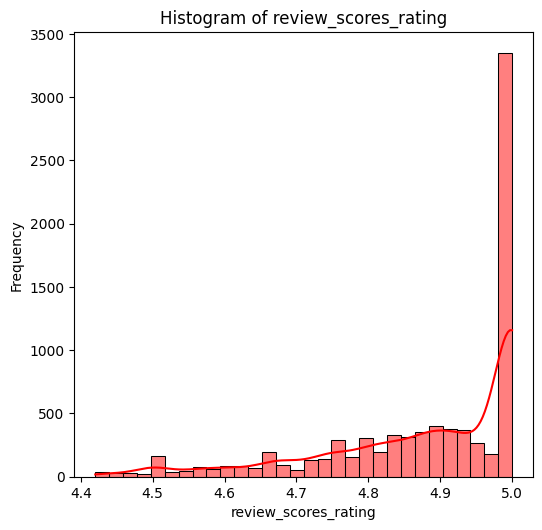


Histogram for newyork:


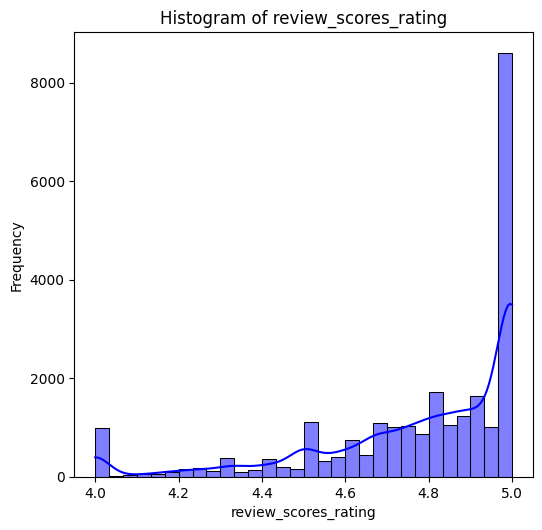


Histogram for london:


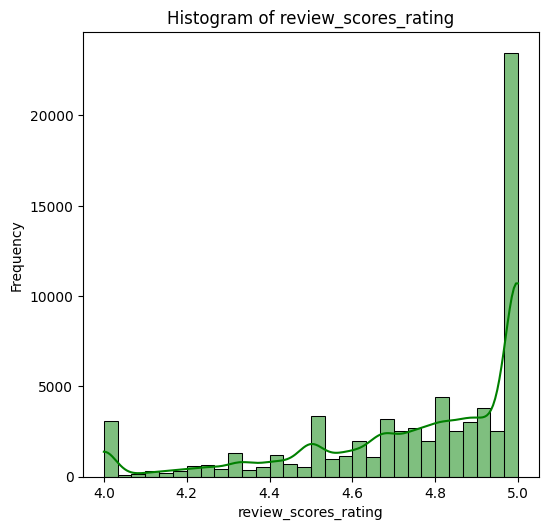


Histogram for sanfrancisco:


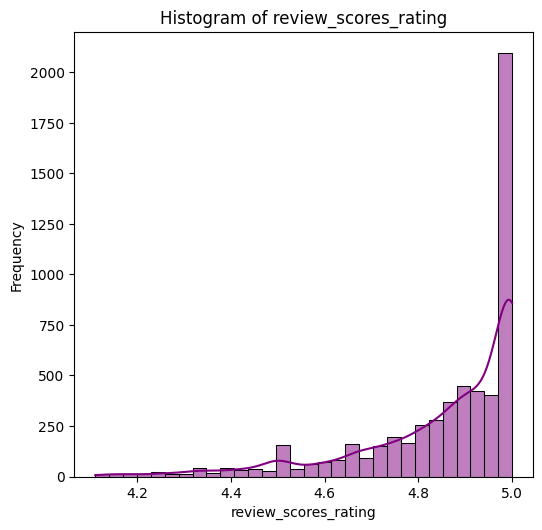


Histogram for toronto:


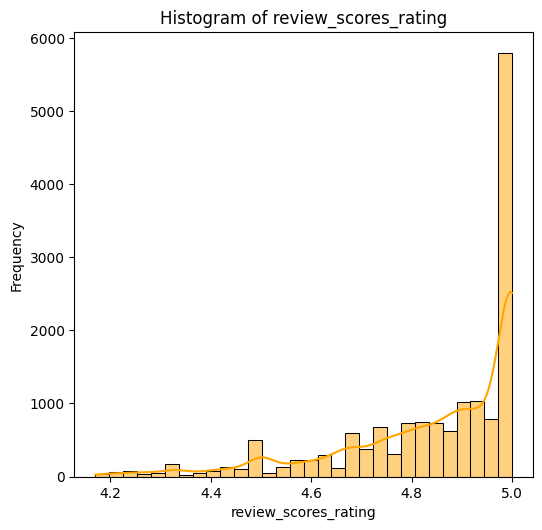

In [226]:
plotting_histogram(filtered_listing_review_score_df,feature_three,city_data)


Density Plot for amsterdam:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


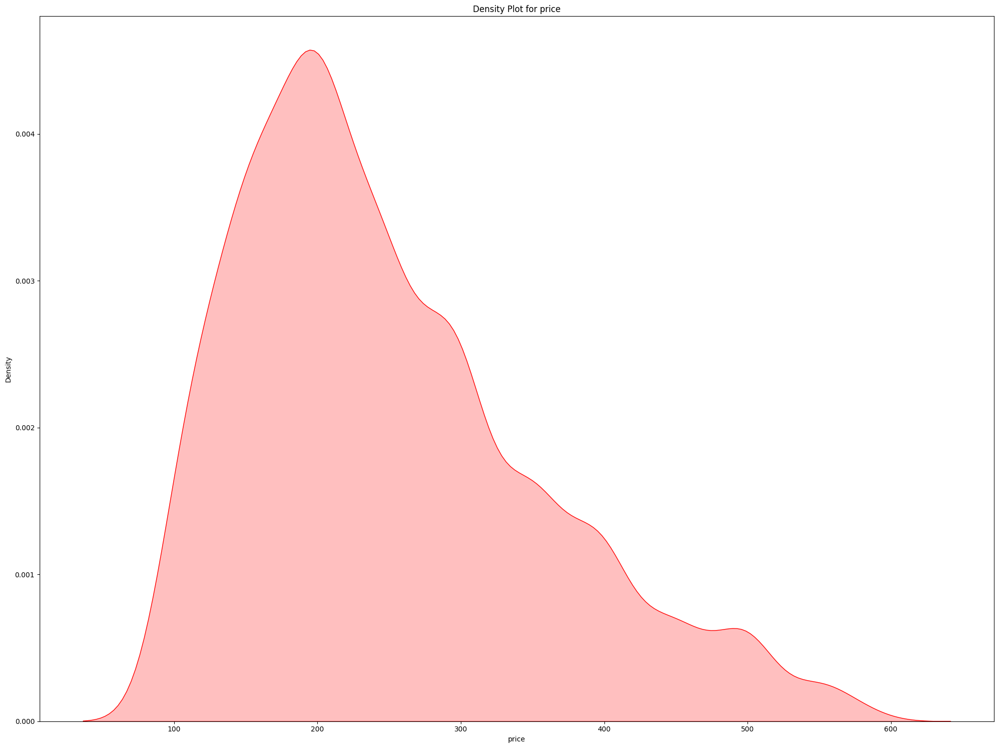


Density Plot for newyork:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


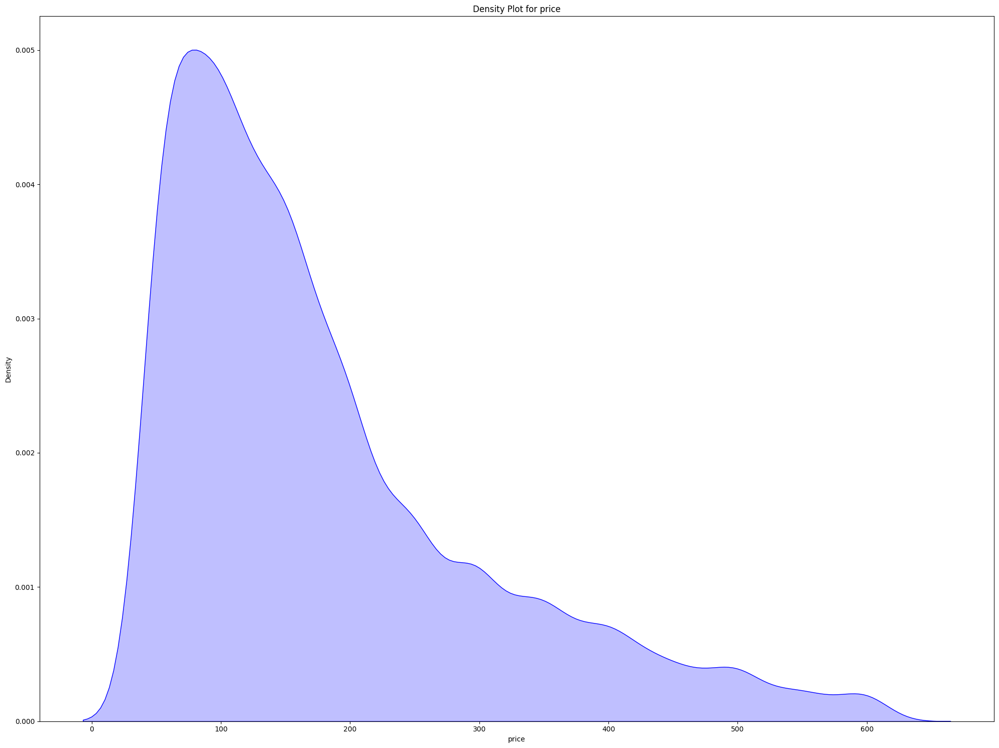


Density Plot for london:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


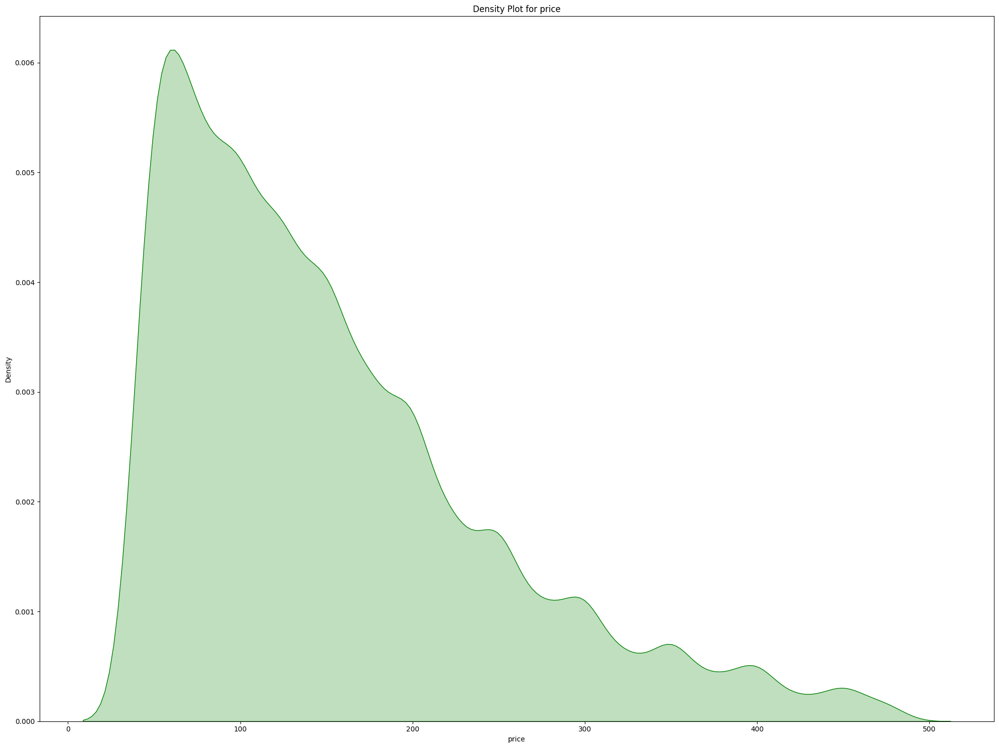


Density Plot for sanfrancisco:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


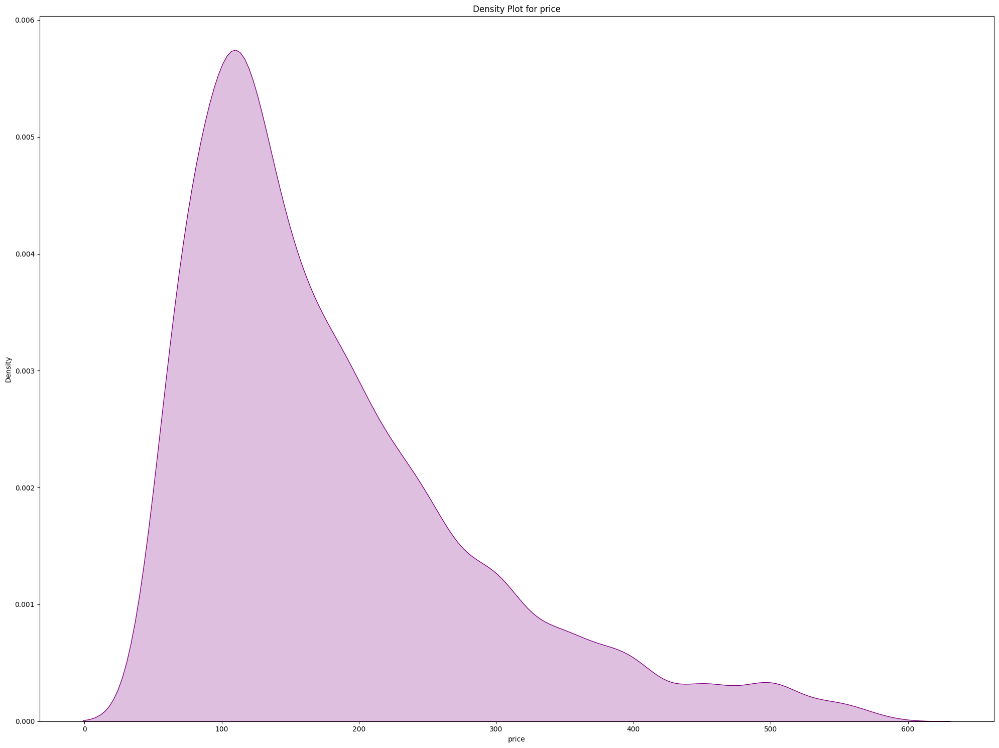


Density Plot for toronto:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


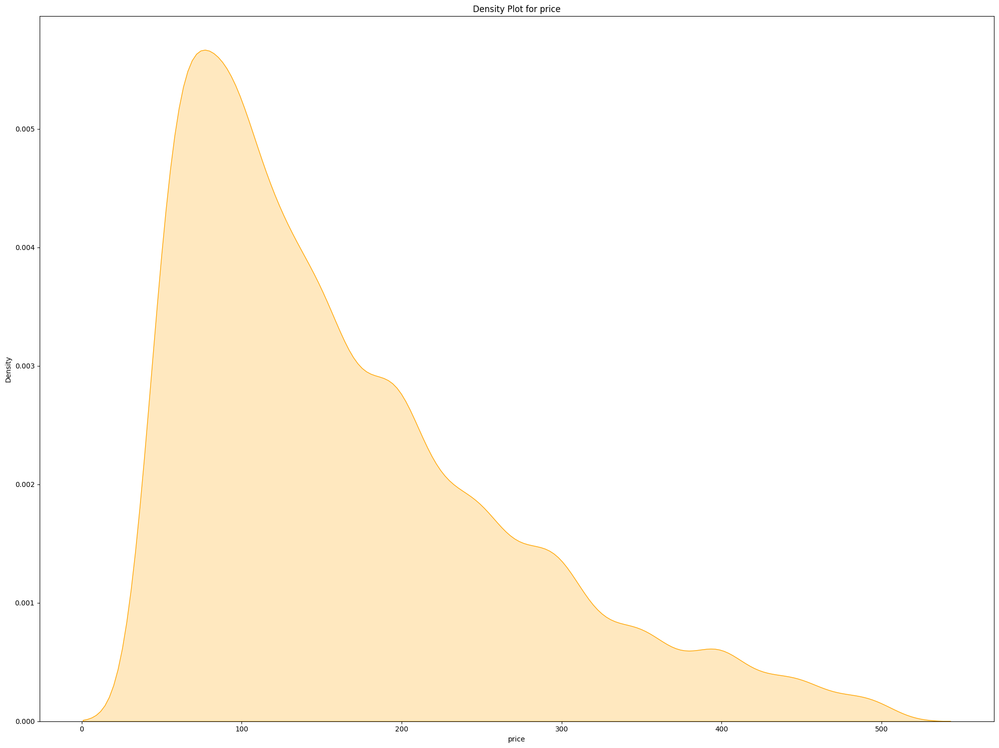

In [236]:
density_plots(filtered_listing_price_df,feature_one,city_data)

# Task 2 - Constructing Density plots after Outlier Detection


Density Plot for amsterdam:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


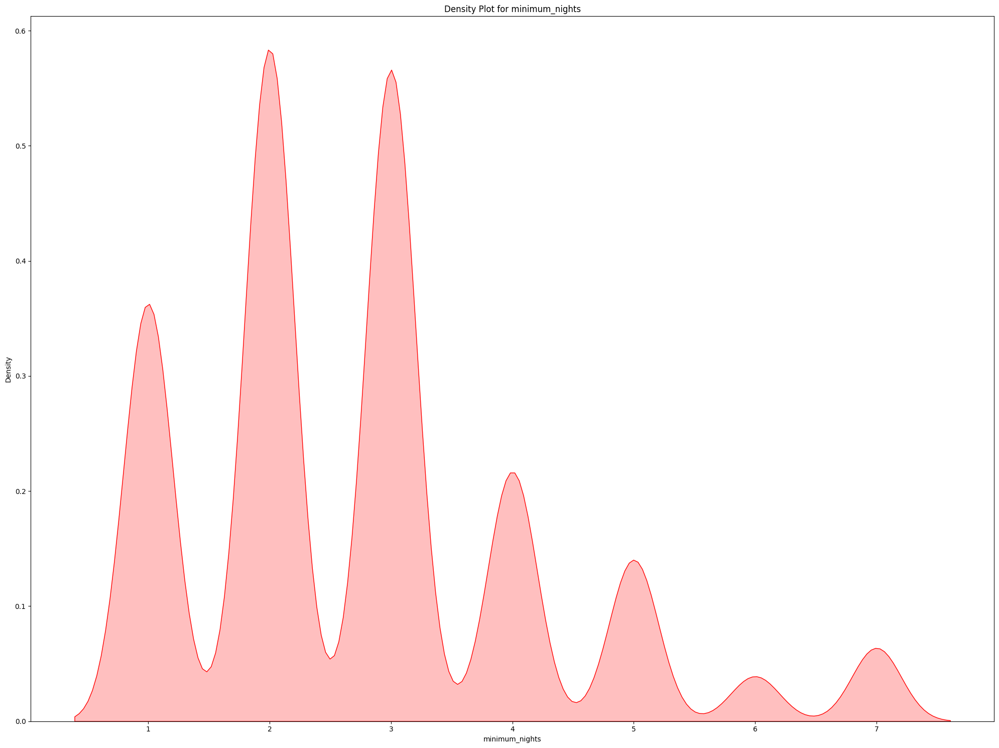

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


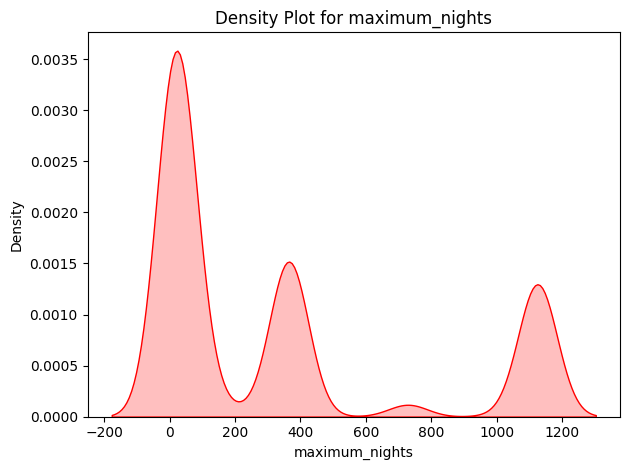

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


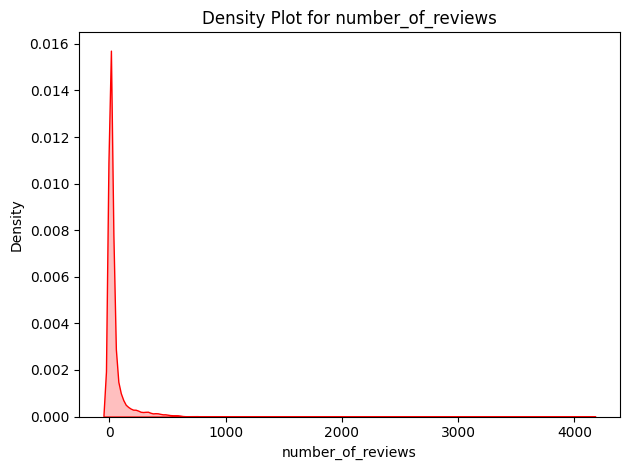


Density Plot for newyork:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


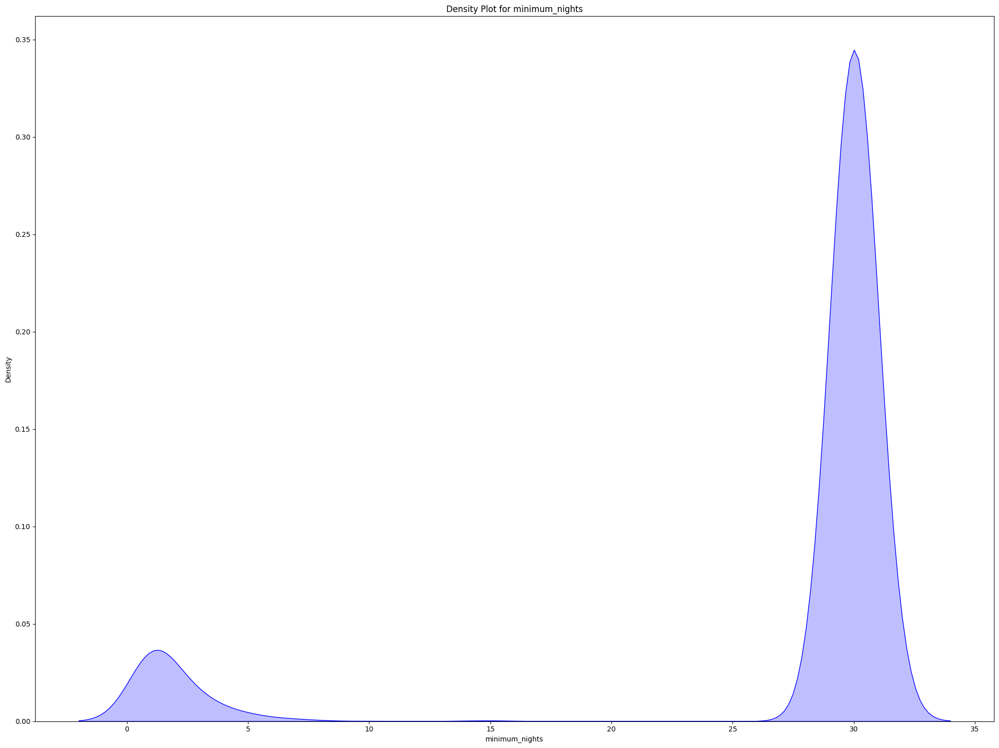

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


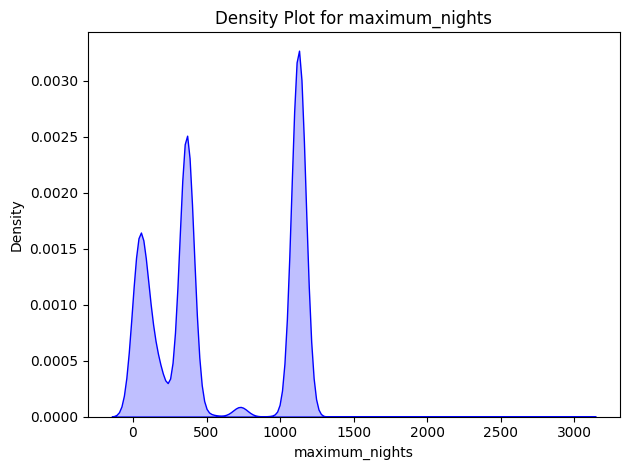

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


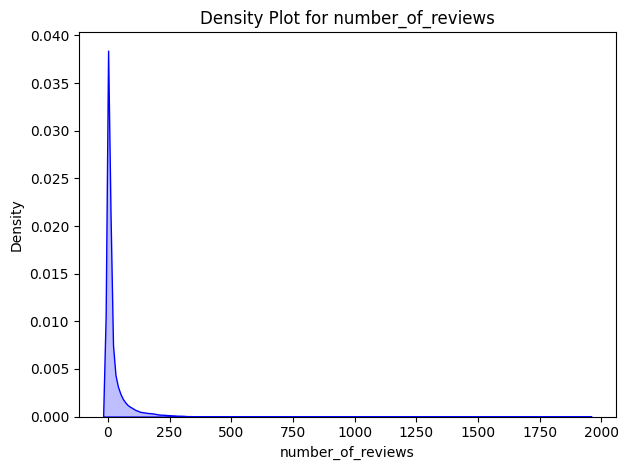


Density Plot for london:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


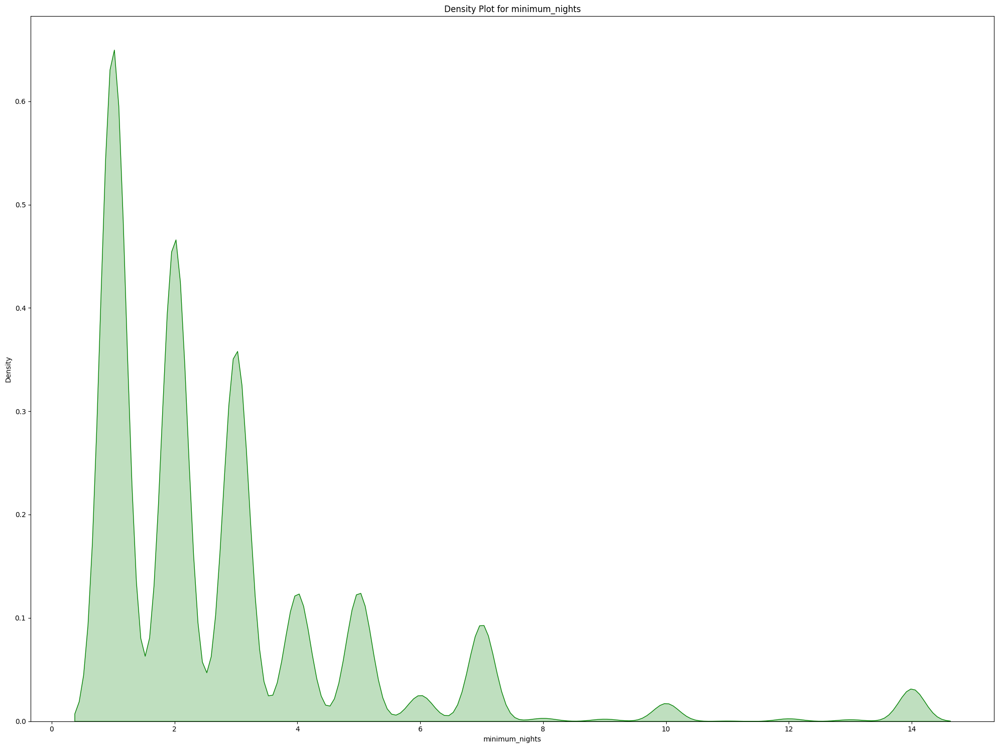

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


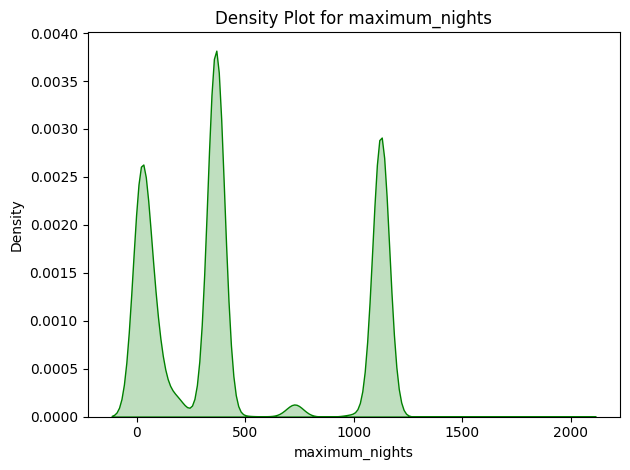

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


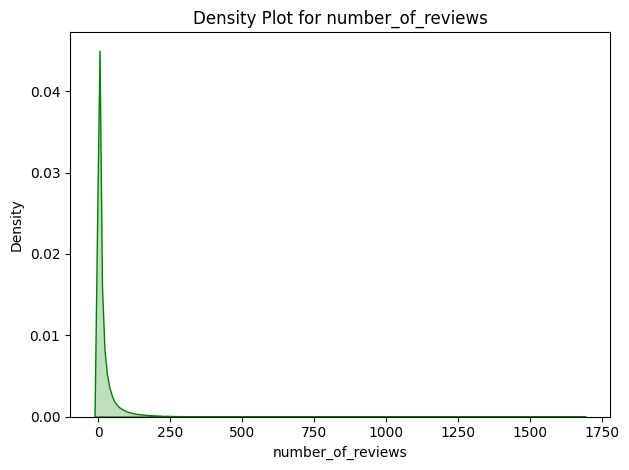


Density Plot for sanfrancisco:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


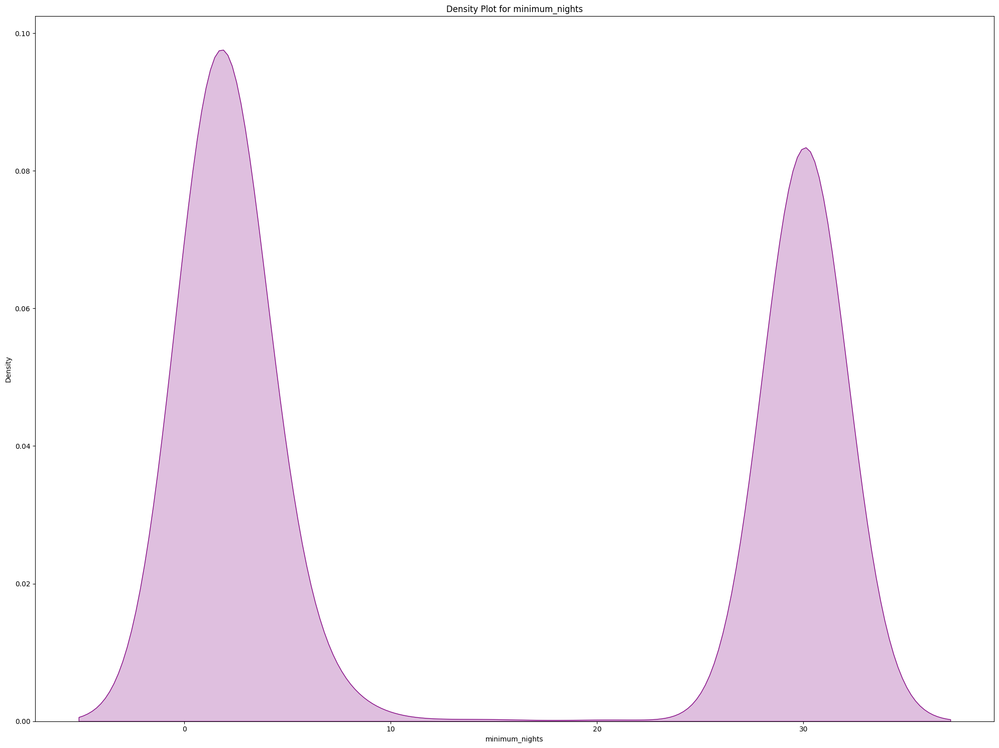

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


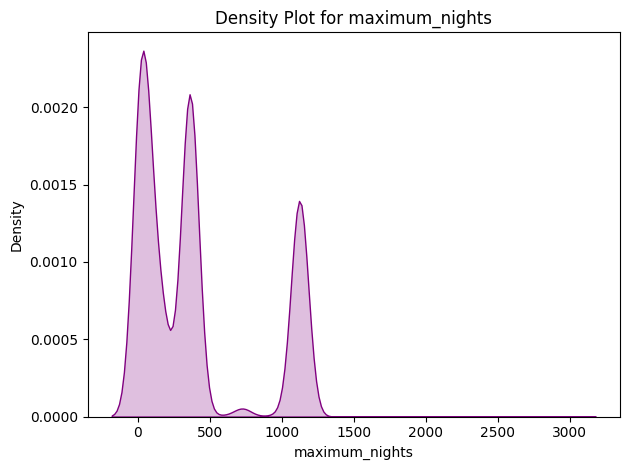

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


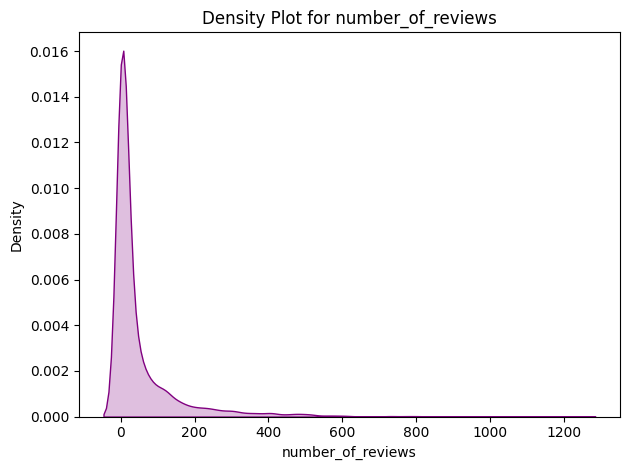


Density Plot for toronto:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


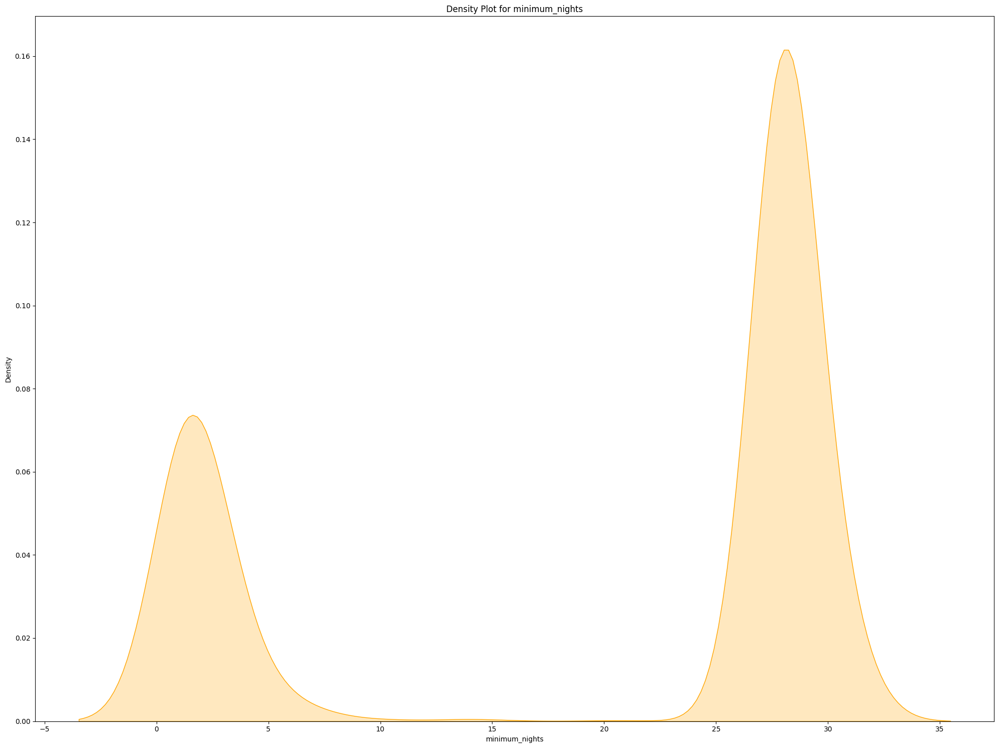

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


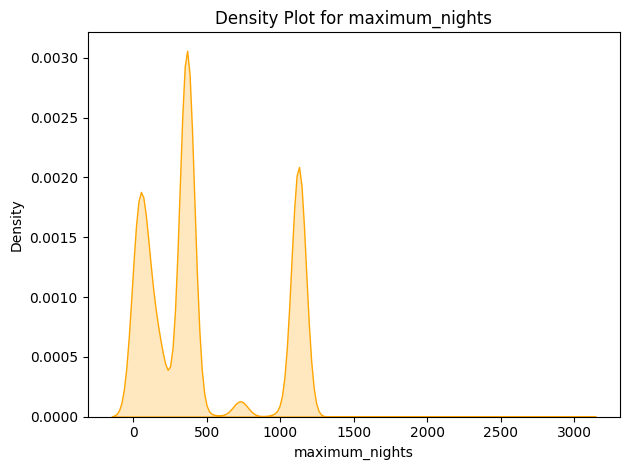

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


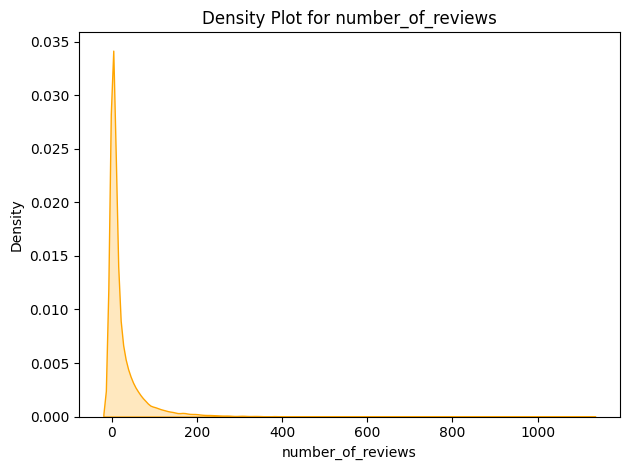

In [237]:
density_plots(filtered_listing_df,feature_two,city_data)


Density Plot for amsterdam:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


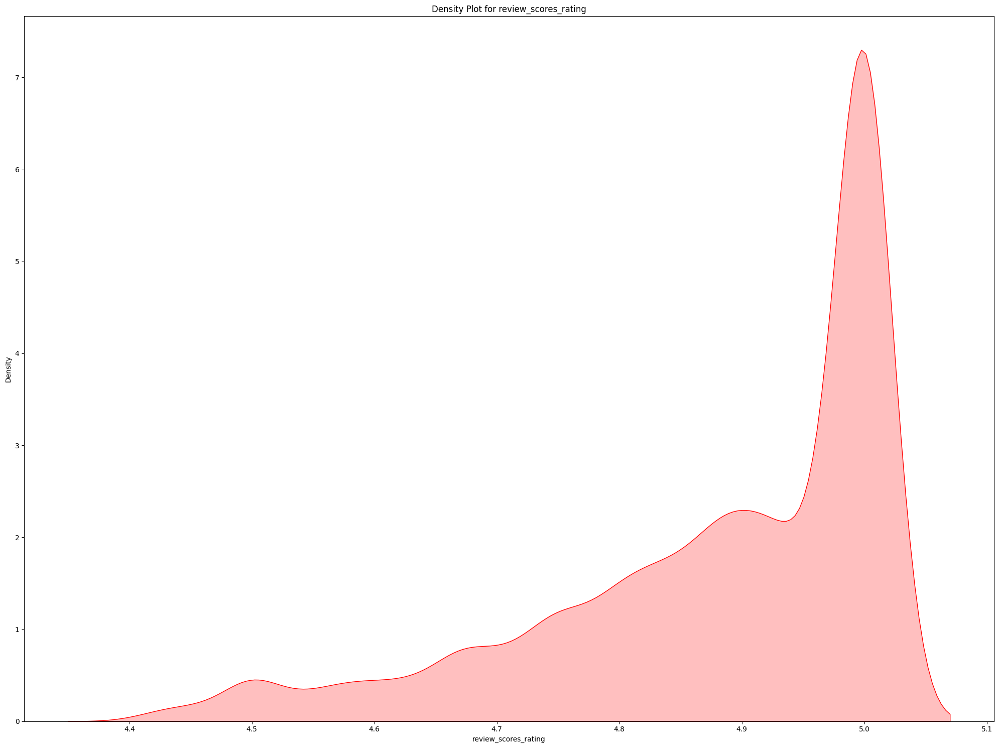


Density Plot for newyork:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


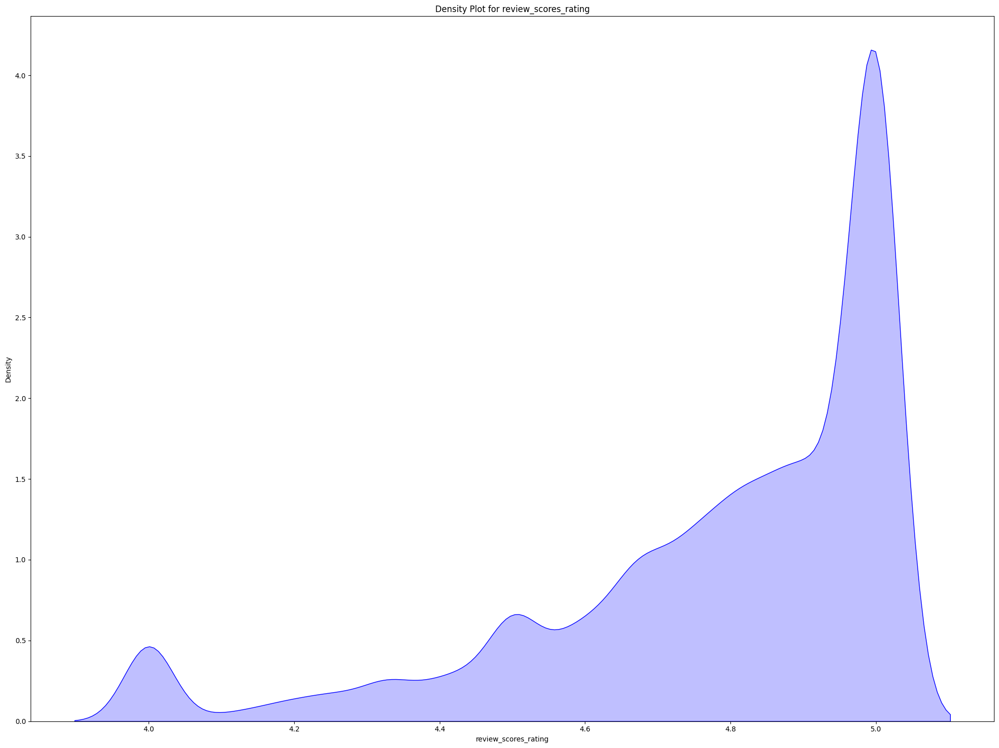


Density Plot for london:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


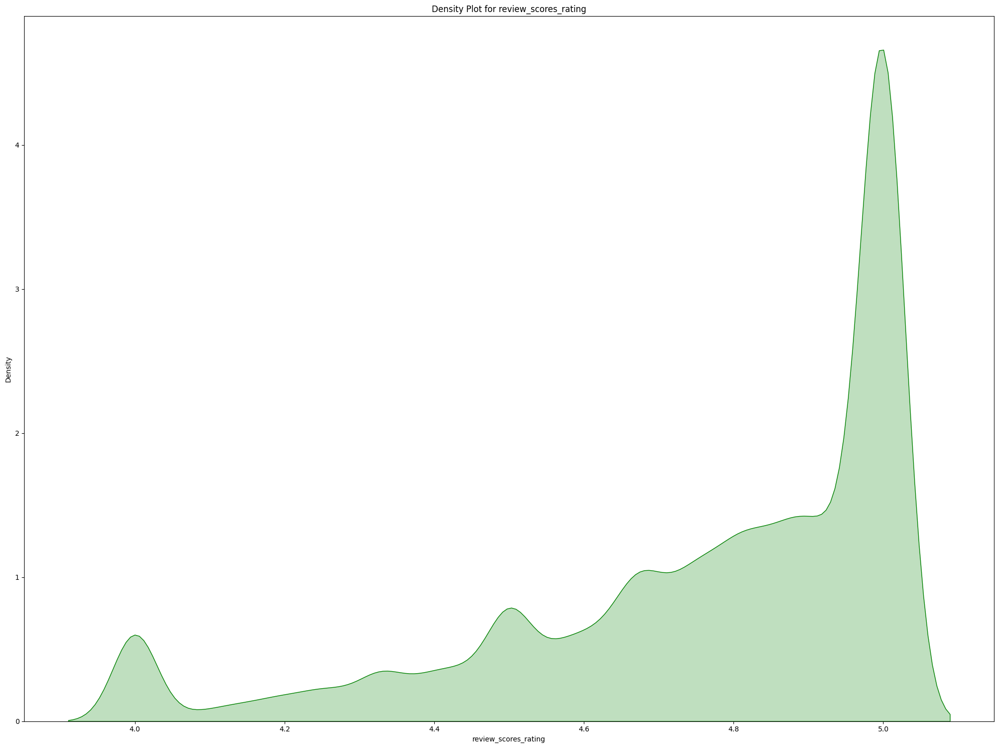


Density Plot for sanfrancisco:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


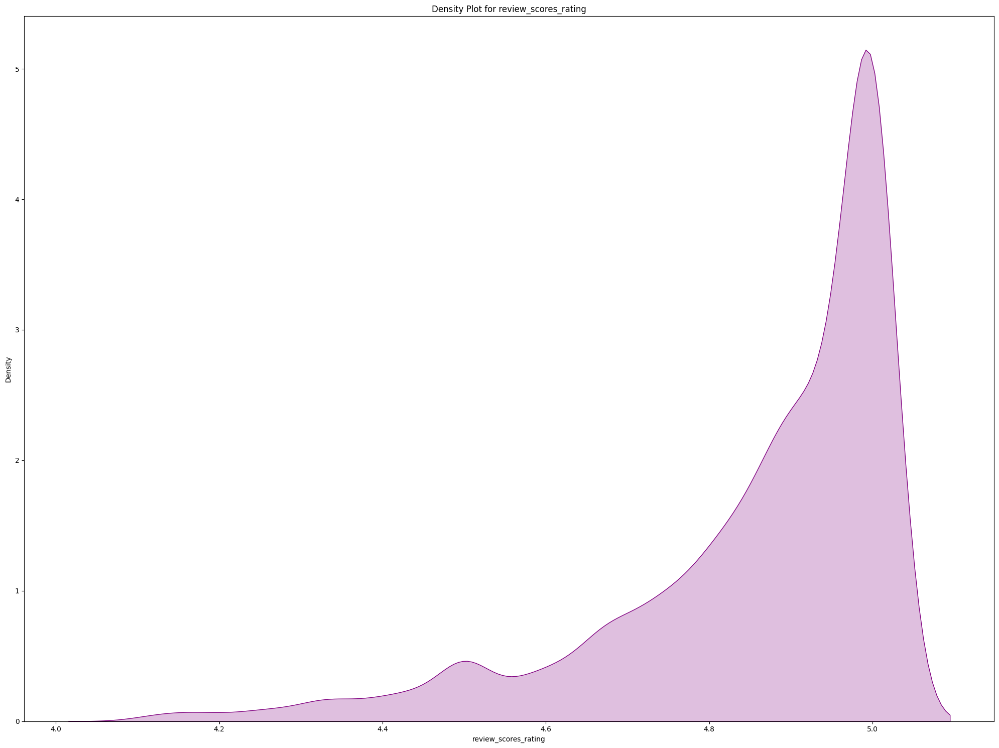


Density Plot for toronto:


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/3744239631.py:22: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  sns.kdeplot(city_df[feature], shade=True, color=color)


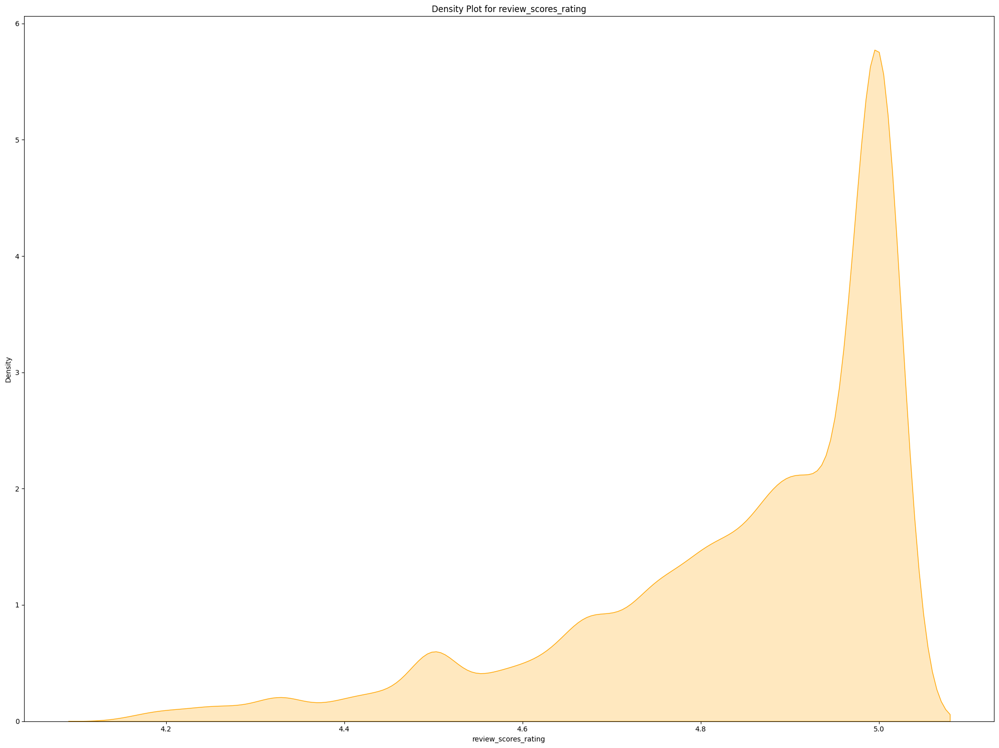

In [238]:
density_plots(filtered_listing_review_score_df,feature_three,city_data)

# Task 3 - Analyzing Correlation 

In [188]:
def find_correlation(df,features,city_data):
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]
        print(f'Correlation Analysis for {city_name}:')

        corr_matrix = city_df[features].corr()

        # Print the correlation matrix
        print(corr_matrix)

        print(f'Scatter Plot for {city_name}:')
        sns.pairplot(city_df[features])

        # Display the plots
        plt.show()

        plt.figure(figsize=(8, 6))
        sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=0.5)

        # Show the plot
        plt.title(f'Correlation Matrix for {city_name}')
        plt.show()

Correlation Analysis for amsterdam:
                         price  number_of_reviews  availability_365  \
price                 1.000000          -0.242996          0.034868   
number_of_reviews    -0.242996           1.000000          0.115539   
availability_365      0.034868           0.115539          1.000000   
review_scores_rating  0.135983          -0.044641         -0.105473   

                      review_scores_rating  
price                             0.135983  
number_of_reviews                -0.044641  
availability_365                 -0.105473  
review_scores_rating              1.000000  
Scatter Plot for amsterdam:


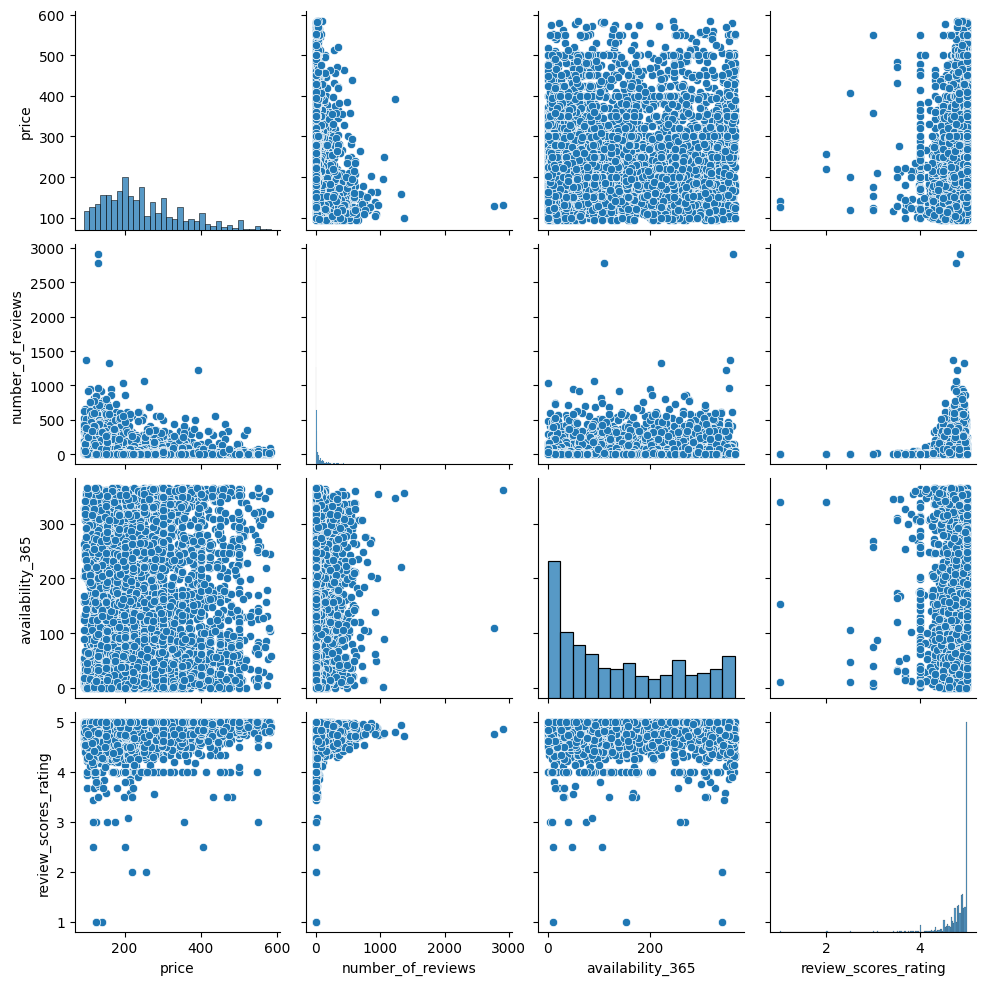

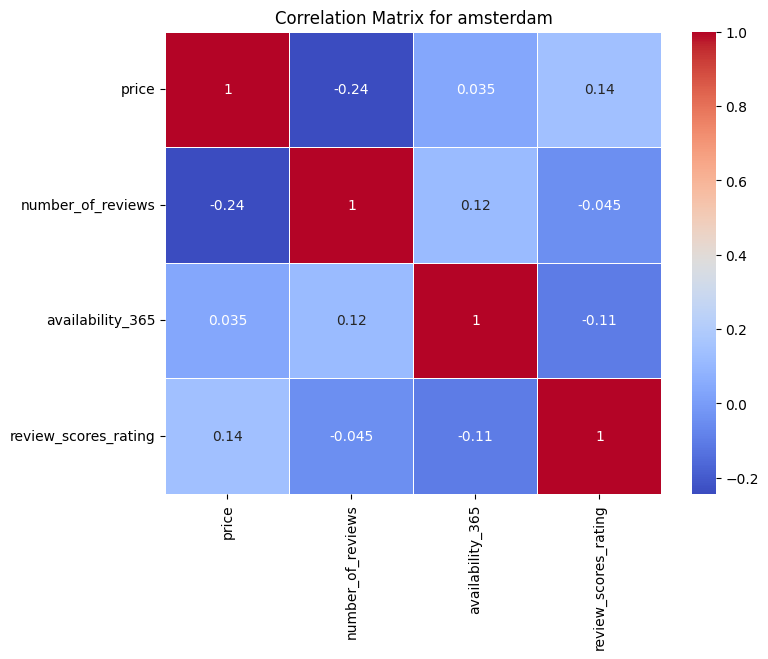

Correlation Analysis for newyork:
                         price  number_of_reviews  availability_365  \
price                 1.000000          -0.033578          0.011818   
number_of_reviews    -0.033578           1.000000         -0.091458   
availability_365      0.011818          -0.091458          1.000000   
review_scores_rating  0.022942           0.072918         -0.082676   

                      review_scores_rating  
price                             0.022942  
number_of_reviews                 0.072918  
availability_365                 -0.082676  
review_scores_rating              1.000000  
Scatter Plot for newyork:


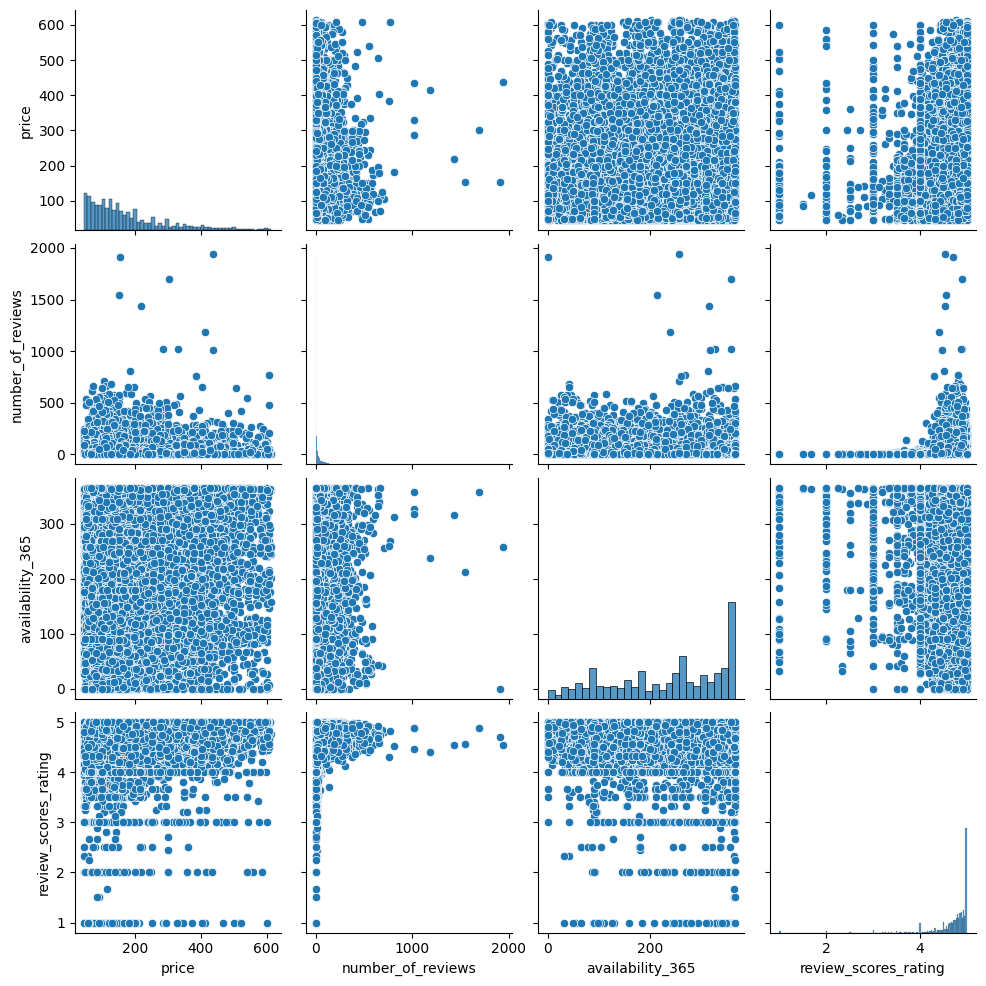

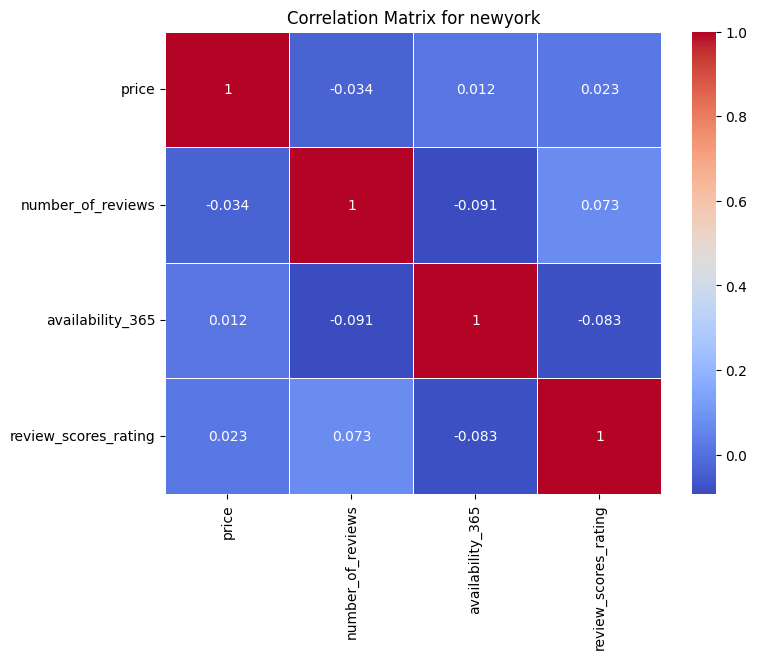

Correlation Analysis for london:
                         price  number_of_reviews  availability_365  \
price                 1.000000          -0.108523          0.050362   
number_of_reviews    -0.108523           1.000000         -0.058458   
availability_365      0.050362          -0.058458          1.000000   
review_scores_rating  0.019374           0.074378         -0.082454   

                      review_scores_rating  
price                             0.019374  
number_of_reviews                 0.074378  
availability_365                 -0.082454  
review_scores_rating              1.000000  
Scatter Plot for london:


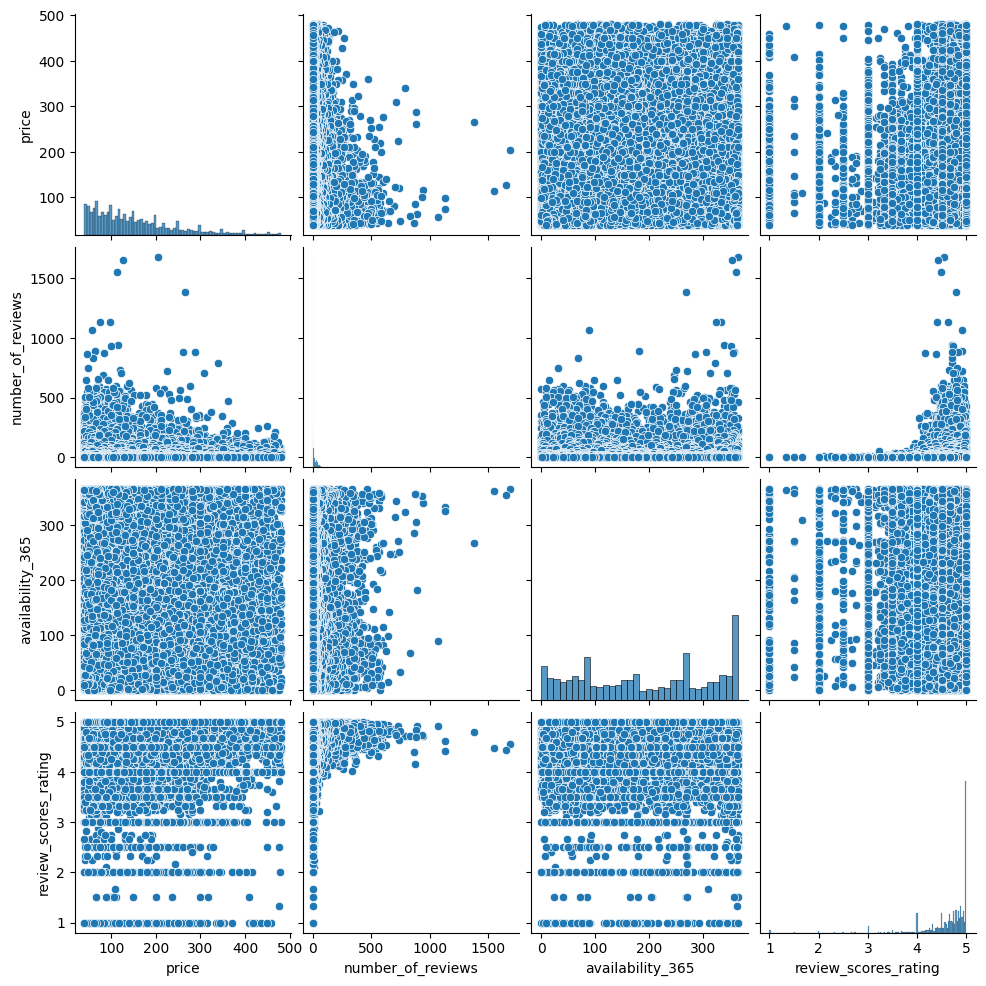

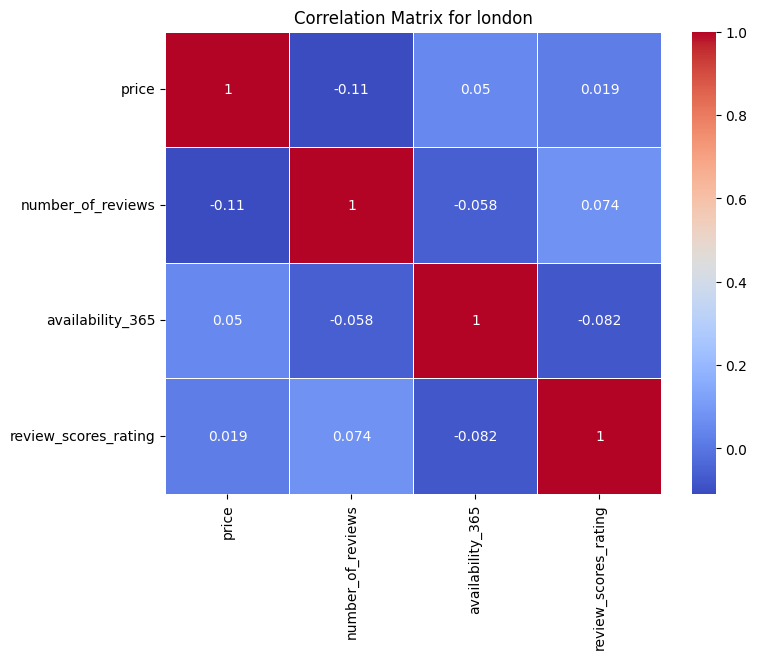

Correlation Analysis for sanfrancisco:
                         price  number_of_reviews  availability_365  \
price                 1.000000          -0.086589         -0.060538   
number_of_reviews    -0.086589           1.000000         -0.124058   
availability_365     -0.060538          -0.124058          1.000000   
review_scores_rating  0.171285           0.079608         -0.166664   

                      review_scores_rating  
price                             0.171285  
number_of_reviews                 0.079608  
availability_365                 -0.166664  
review_scores_rating              1.000000  
Scatter Plot for sanfrancisco:


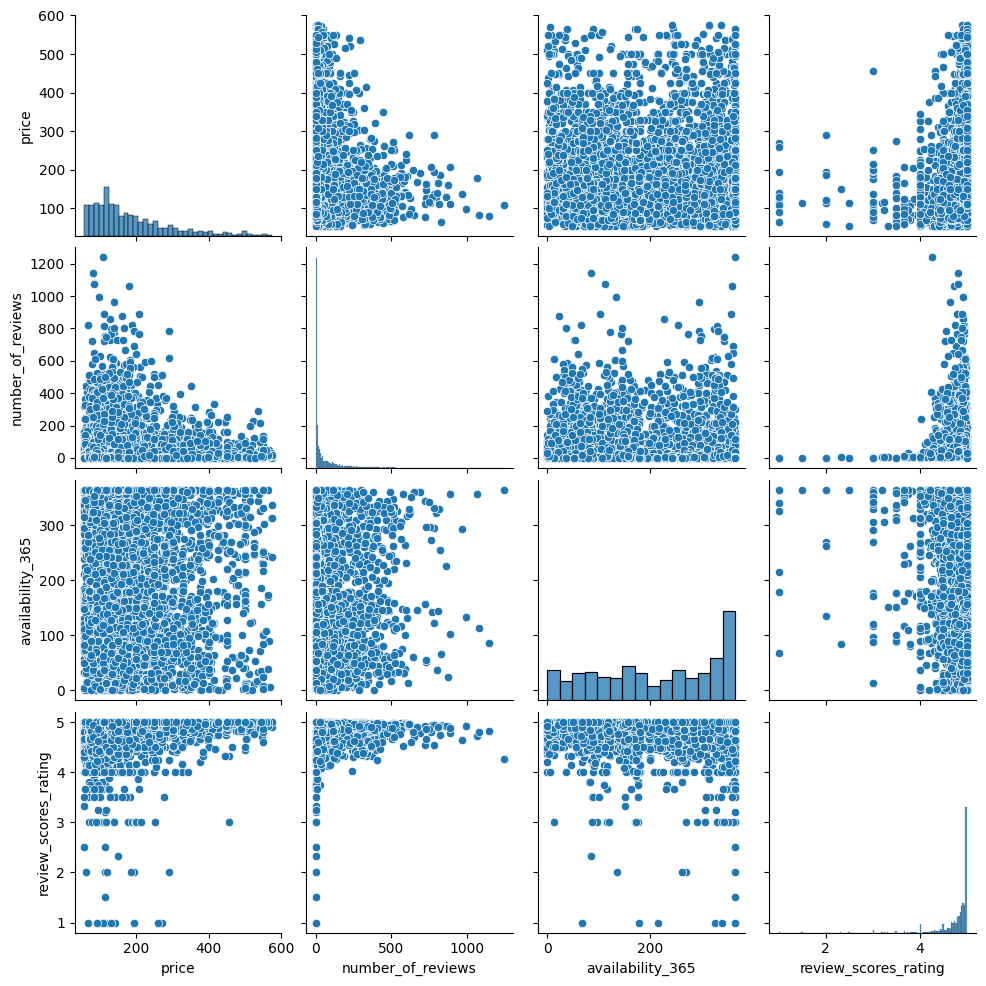

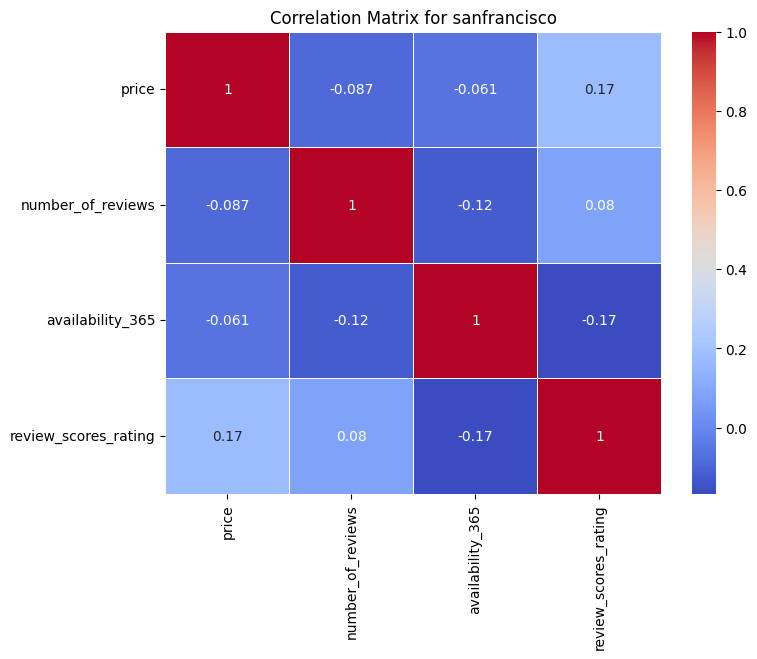

Correlation Analysis for toronto:
                         price  number_of_reviews  availability_365  \
price                 1.000000           0.011596         -0.030378   
number_of_reviews     0.011596           1.000000         -0.117975   
availability_365     -0.030378          -0.117975          1.000000   
review_scores_rating  0.088351           0.059333         -0.055746   

                      review_scores_rating  
price                             0.088351  
number_of_reviews                 0.059333  
availability_365                 -0.055746  
review_scores_rating              1.000000  
Scatter Plot for toronto:


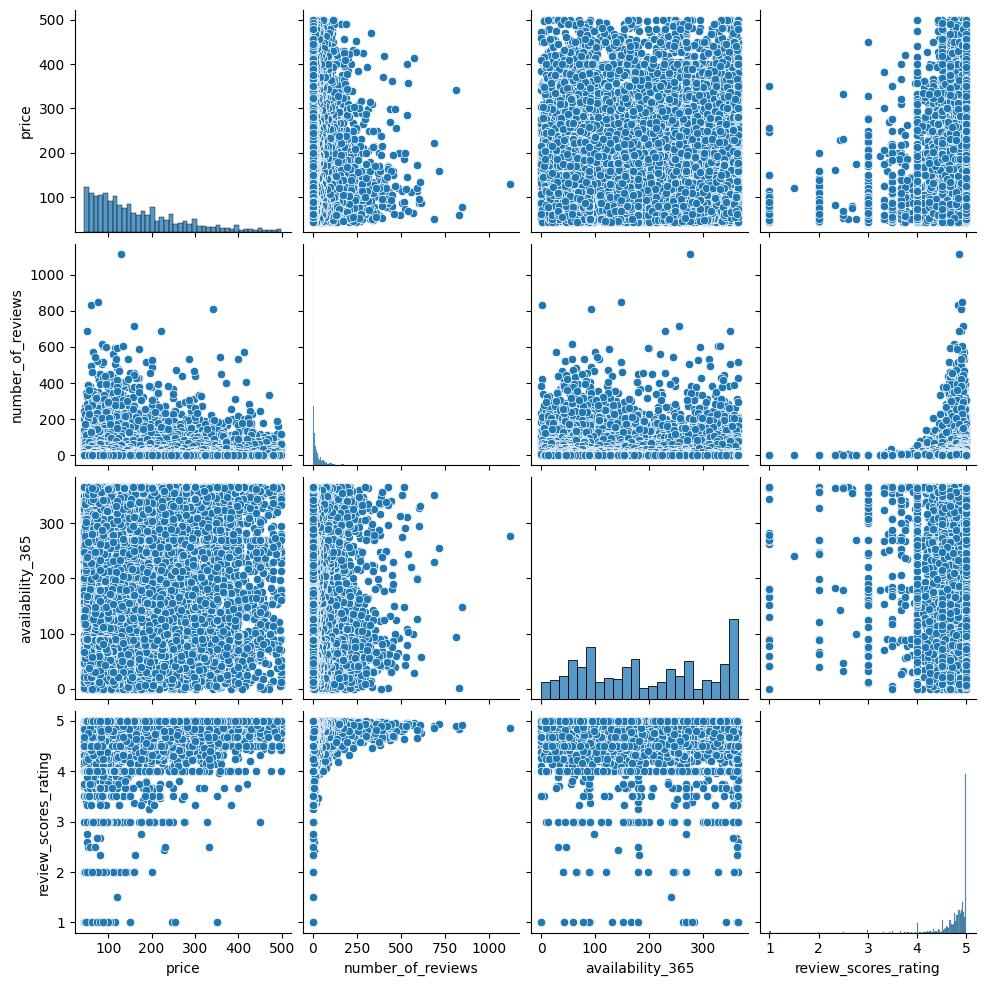

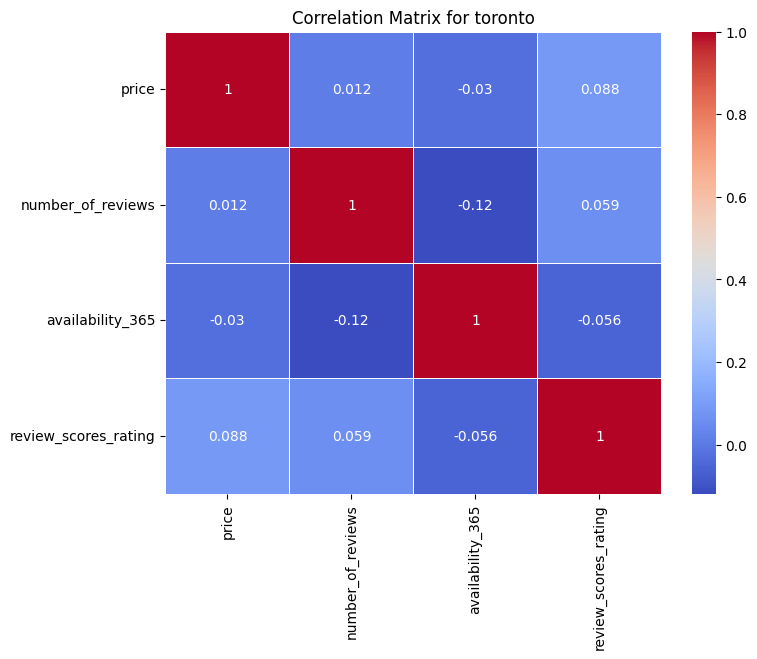

In [189]:
corr_features = ['price','number_of_reviews','availability_365','review_scores_rating']
find_correlation(filtered_listing_price_df,corr_features,city_data)

# Analyzing Correlation with additional features like 'accommodates' and 'bedrooms'

Correlation Analysis for amsterdam:
                         price  accommodates  bedrooms  number_of_reviews  \
price                 1.000000      0.450909  0.451183          -0.242996   
accommodates          0.450909      1.000000  0.682794          -0.059211   
bedrooms              0.451183      0.682794  1.000000          -0.157943   
number_of_reviews    -0.242996     -0.059211 -0.157943           1.000000   
availability_365      0.034868     -0.025003 -0.106543           0.115539   
review_scores_rating  0.135983     -0.073001  0.040667          -0.044641   

                      availability_365  review_scores_rating  
price                         0.034868              0.135983  
accommodates                 -0.025003             -0.073001  
bedrooms                     -0.106543              0.040667  
number_of_reviews             0.115539             -0.044641  
availability_365              1.000000             -0.105473  
review_scores_rating         -0.105473        

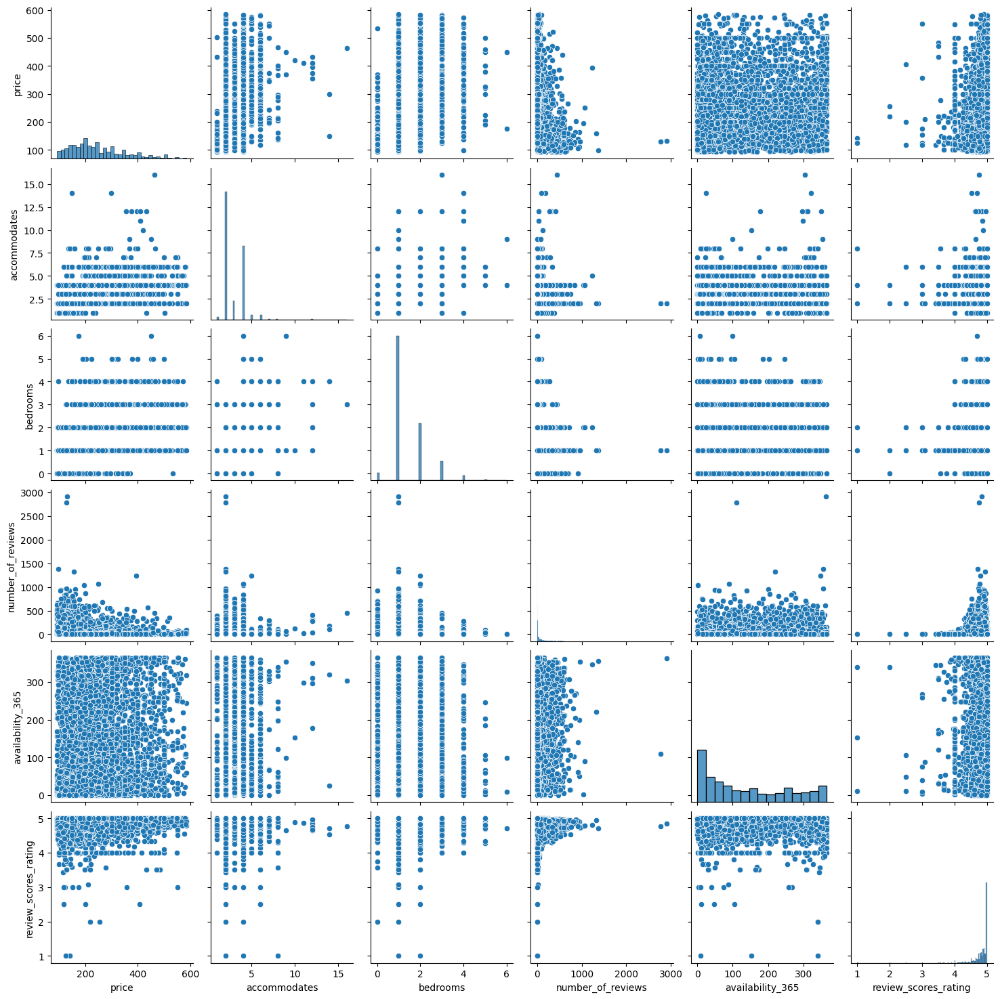

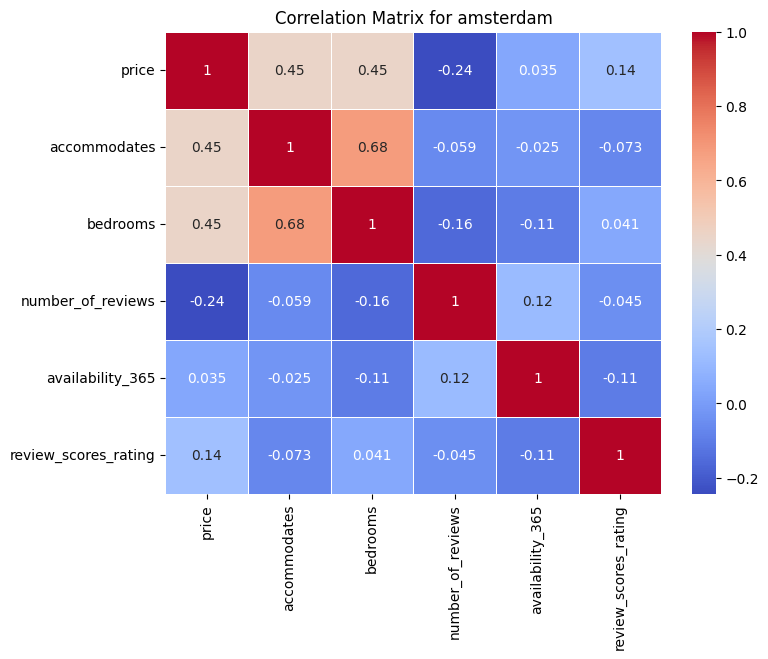

Correlation Analysis for newyork:
                         price  accommodates  bedrooms  number_of_reviews  \
price                 1.000000      0.401678  0.185254          -0.033578   
accommodates          0.401678      1.000000  0.488343           0.016404   
bedrooms              0.185254      0.488343  1.000000          -0.044114   
number_of_reviews    -0.033578      0.016404 -0.044114           1.000000   
availability_365      0.011818      0.047300  0.052876          -0.091458   
review_scores_rating  0.022942     -0.014503  0.021741           0.072918   

                      availability_365  review_scores_rating  
price                         0.011818              0.022942  
accommodates                  0.047300             -0.014503  
bedrooms                      0.052876              0.021741  
number_of_reviews            -0.091458              0.072918  
availability_365              1.000000             -0.082676  
review_scores_rating         -0.082676          

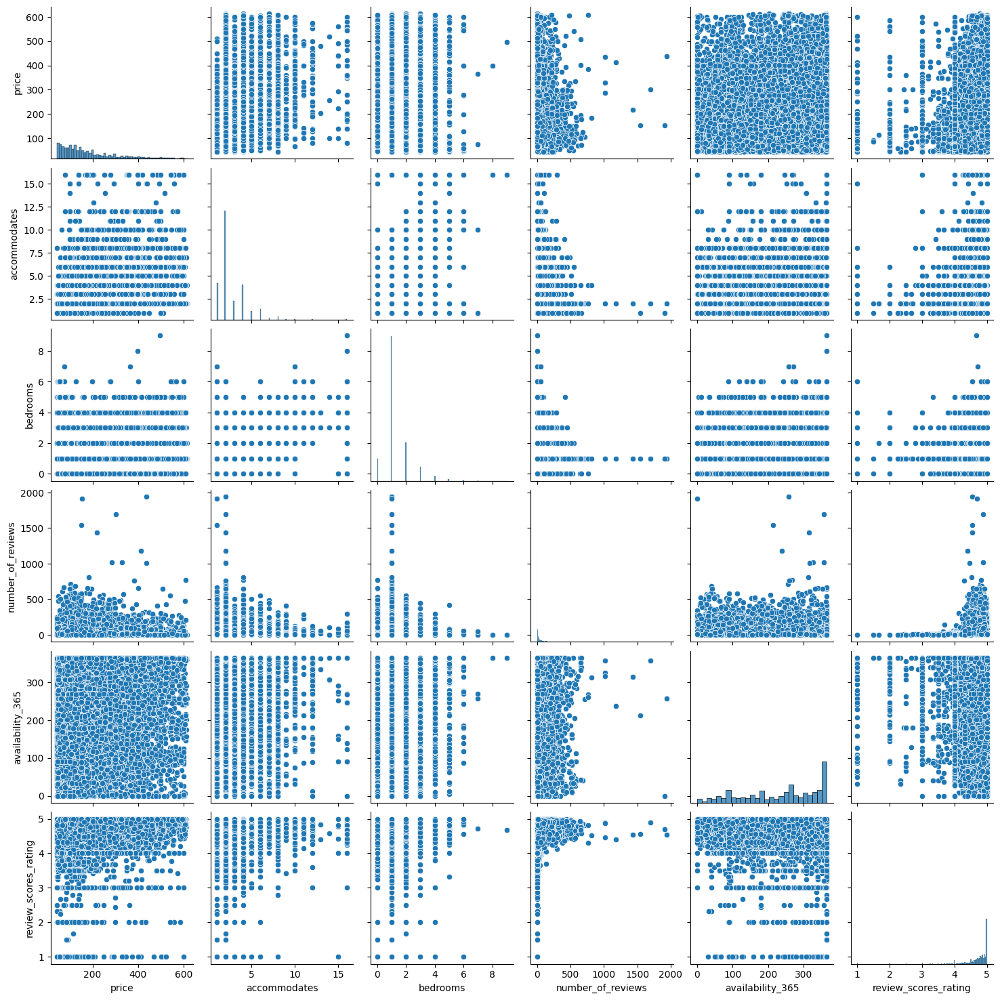

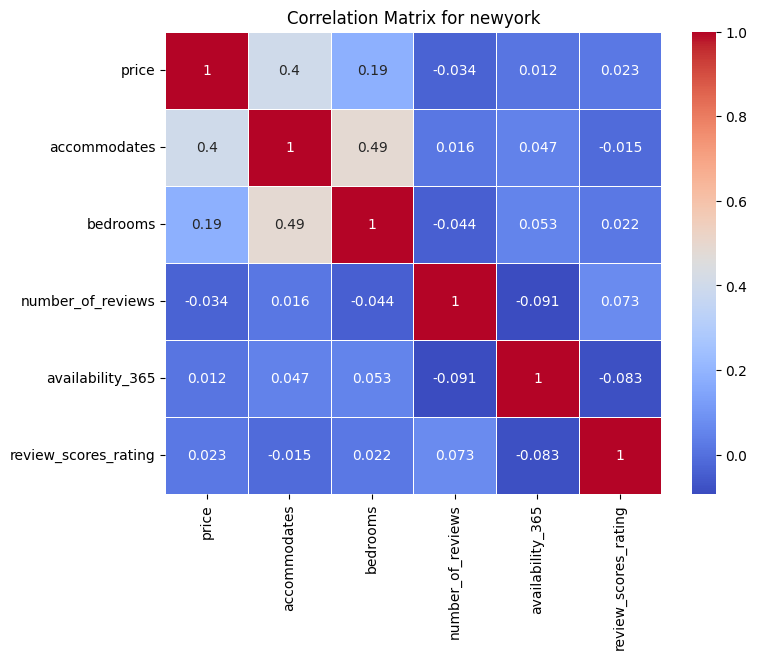

Correlation Analysis for london:
                         price  accommodates  bedrooms  number_of_reviews  \
price                 1.000000      0.580305  0.495223          -0.108523   
accommodates          0.580305      1.000000  0.734400          -0.066117   
bedrooms              0.495223      0.734400  1.000000          -0.087928   
number_of_reviews    -0.108523     -0.066117 -0.087928           1.000000   
availability_365      0.050362      0.021613  0.008850          -0.058458   
review_scores_rating  0.019374     -0.061507  0.003285           0.074378   

                      availability_365  review_scores_rating  
price                         0.050362              0.019374  
accommodates                  0.021613             -0.061507  
bedrooms                      0.008850              0.003285  
number_of_reviews            -0.058458              0.074378  
availability_365              1.000000             -0.082454  
review_scores_rating         -0.082454           

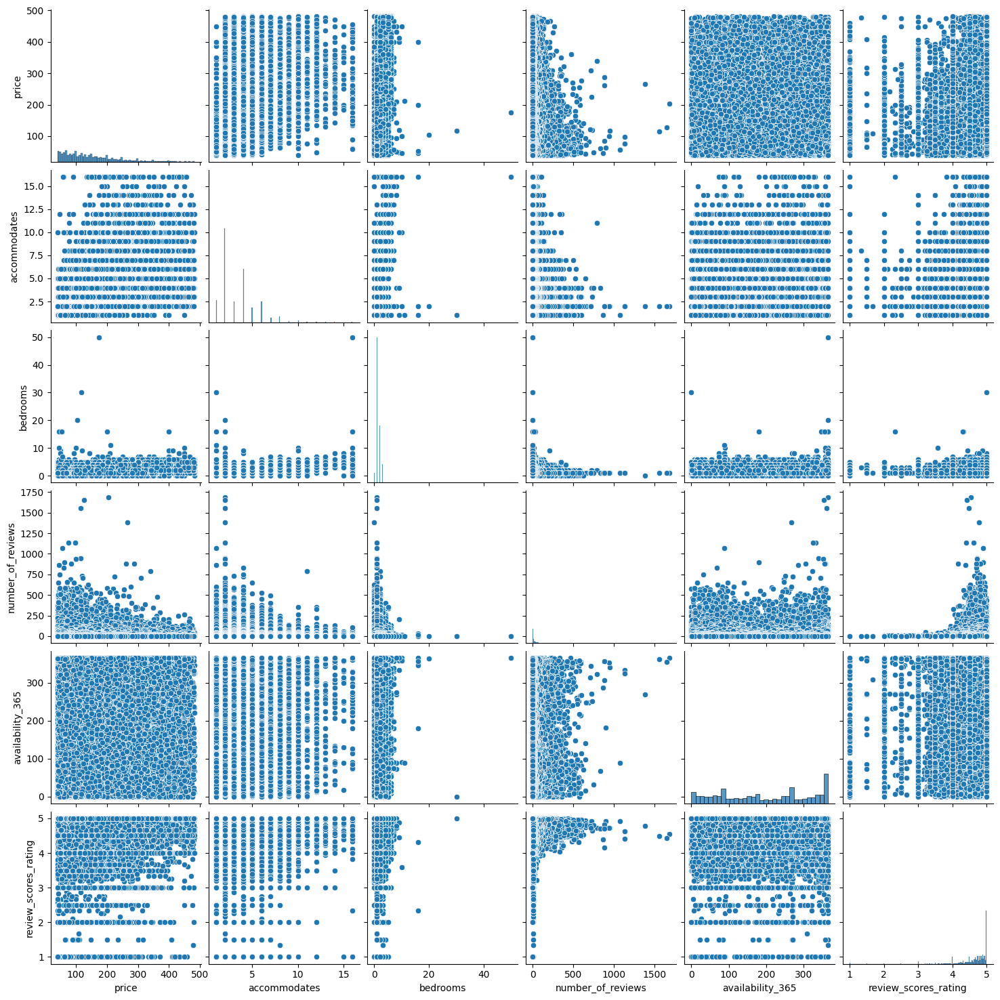

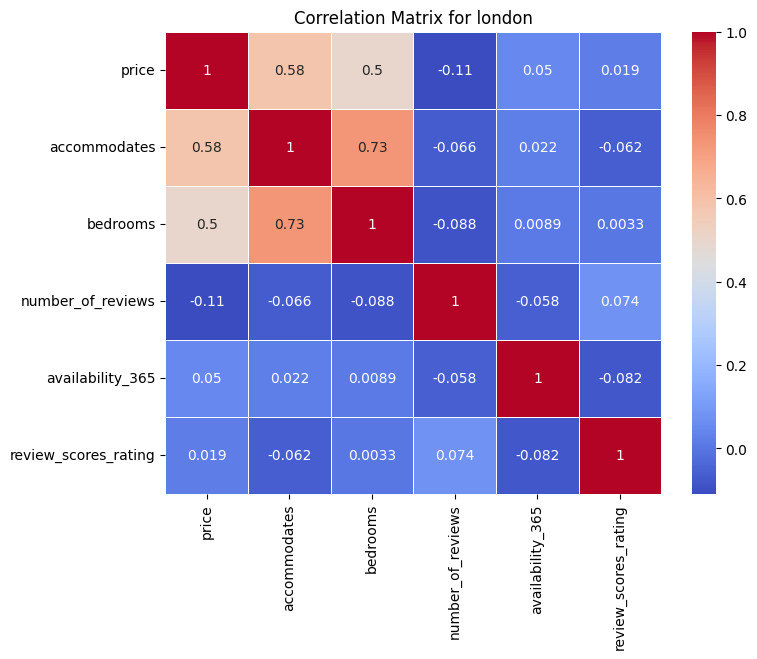

Correlation Analysis for sanfrancisco:
                         price  accommodates  bedrooms  number_of_reviews  \
price                 1.000000      0.572651  0.467289          -0.086589   
accommodates          0.572651      1.000000  0.701108          -0.019202   
bedrooms              0.467289      0.701108  1.000000          -0.054260   
number_of_reviews    -0.086589     -0.019202 -0.054260           1.000000   
availability_365     -0.060538     -0.048932 -0.017921          -0.124058   
review_scores_rating  0.171285      0.084917  0.084476           0.079608   

                      availability_365  review_scores_rating  
price                        -0.060538              0.171285  
accommodates                 -0.048932              0.084917  
bedrooms                     -0.017921              0.084476  
number_of_reviews            -0.124058              0.079608  
availability_365              1.000000             -0.166664  
review_scores_rating         -0.166664     

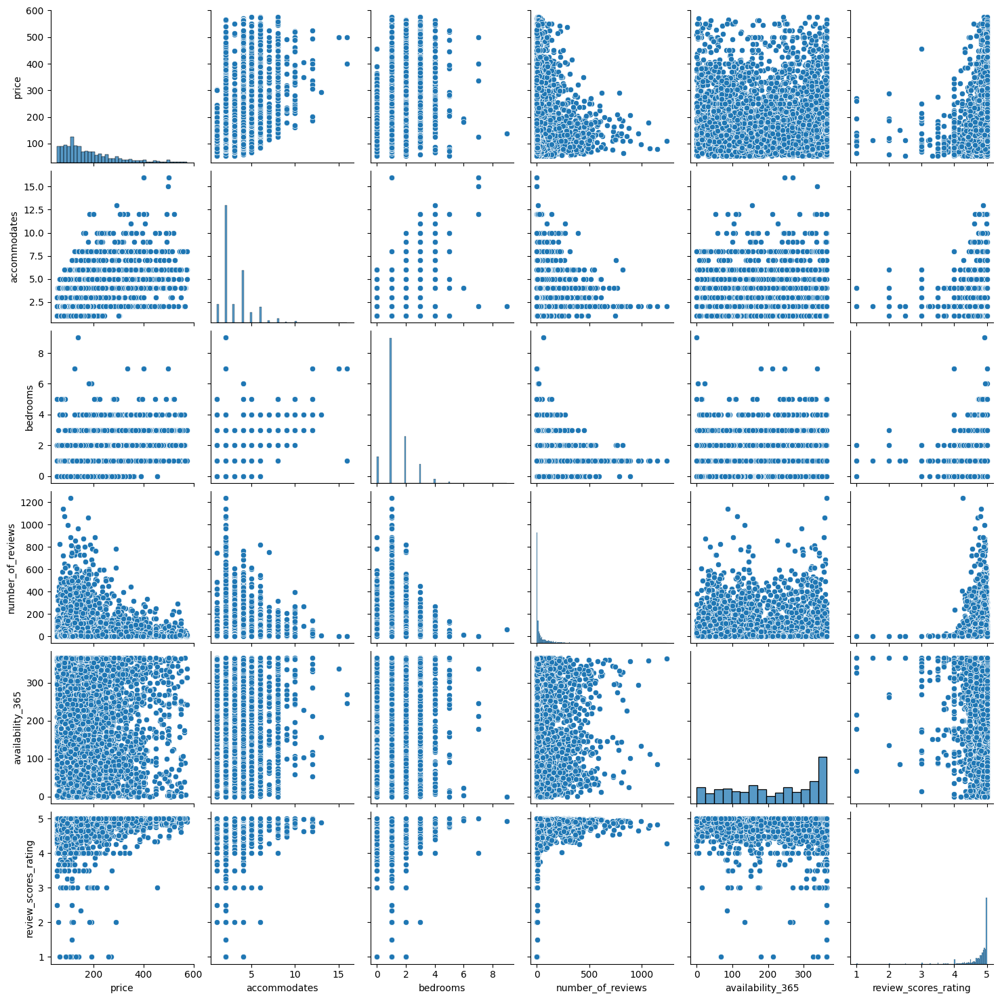

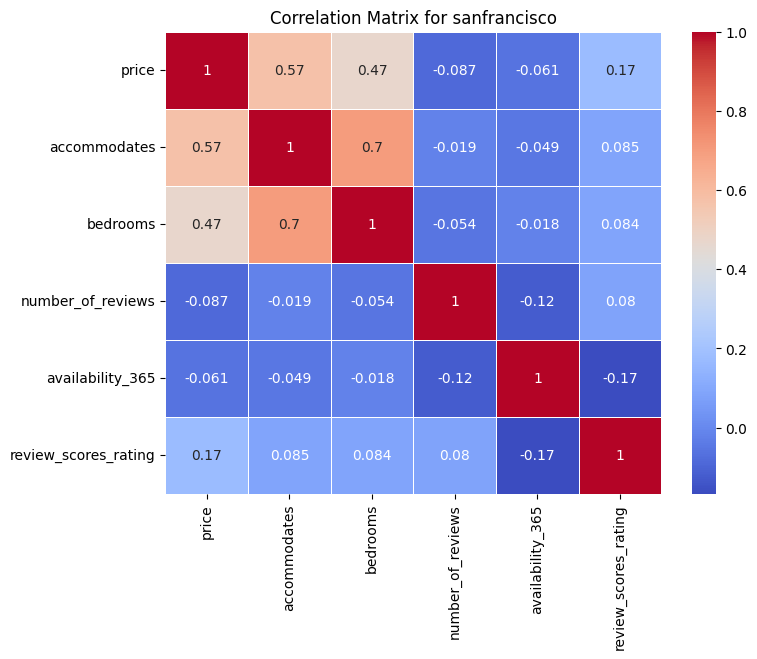

Correlation Analysis for toronto:
                         price  accommodates  bedrooms  number_of_reviews  \
price                 1.000000      0.571784  0.460141           0.011596   
accommodates          0.571784      1.000000  0.746255          -0.026431   
bedrooms              0.460141      0.746255  1.000000          -0.079763   
number_of_reviews     0.011596     -0.026431 -0.079763           1.000000   
availability_365     -0.030378      0.006640  0.036983          -0.117975   
review_scores_rating  0.088351      0.015970  0.013706           0.059333   

                      availability_365  review_scores_rating  
price                        -0.030378              0.088351  
accommodates                  0.006640              0.015970  
bedrooms                      0.036983              0.013706  
number_of_reviews            -0.117975              0.059333  
availability_365              1.000000             -0.055746  
review_scores_rating         -0.055746          

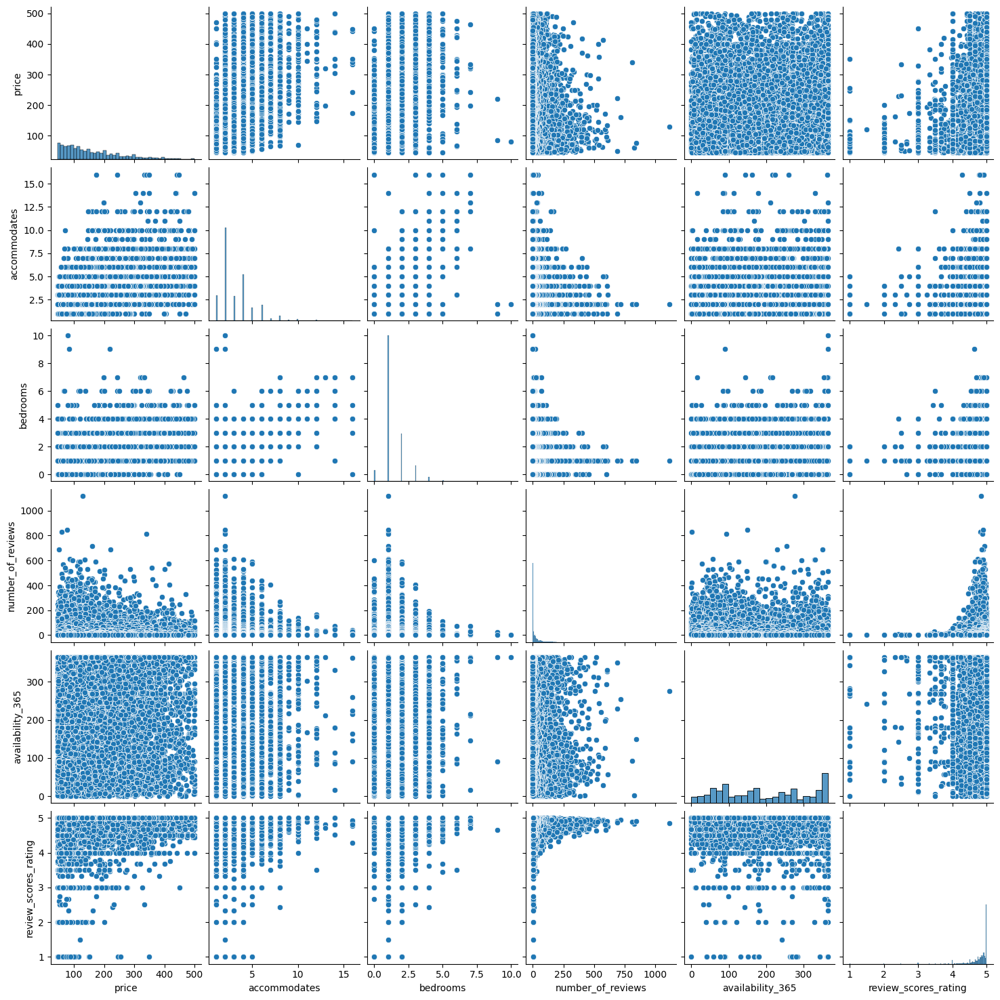

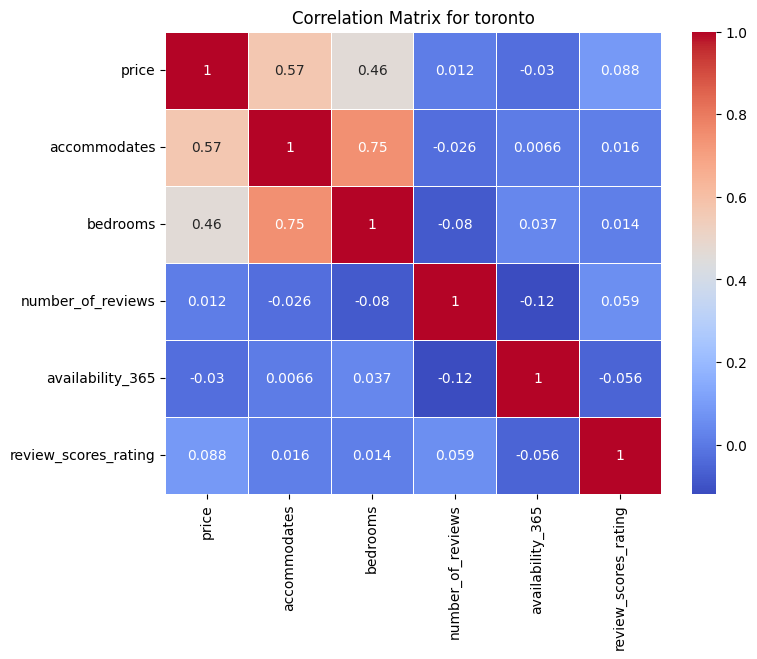

In [165]:
updated_corr_features = ['price','accommodates','bedrooms','number_of_reviews','availability_365','review_scores_rating']
find_correlation(filtered_listing_price_df,updated_corr_features,city_data)

# Task 4 - Price, Long-Term and Short-Term stay Analysis

In [198]:
def price_analysis(df,features_list_one,features_list_two,city_data):
    counter = 0
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]
        print(f'Analysis for {city_name}:')
        color = colors[counter]
        counter = counter + 1
        for i, feature1 in enumerate(features_list_one):
            for j, feature2 in enumerate(features_list_two):
                feature_analysis_1 = city_df.groupby(feature1)[feature2].mean().sort_values()

                plt.figure(figsize=(60, 120))
                if(feature1 == 'room_type'):
                    plt.figure(figsize=(10, 10))
                feature_analysis_1.plot(kind='barh', color=color)
                plt.title(f'Average {feature2} by {feature1}')
                plt.xlabel(f'Average {feature2}')
                plt.ylabel(f'{feature1}')
                plt.show()
                if((feature1 == 'room_type') and (feature2 == 'maximum_nights')):
                    feature_analysis_2 = city_df
                    feature_analysis_2['stay_type'] = city_df['minimum_nights'].apply(lambda x: 'Short-term' if x < 30 else 'Long-term')

                    stay_distribution = city_df['stay_type'].value_counts()

                    plt.figure(figsize=(6, 4))
                    stay_distribution.plot(kind='pie', autopct='%1.1f%%', colors=['lightgreen', 'lightcoral'])
                    plt.title('Distribution of Stay Types')
                    plt.ylabel('')
                    plt.show()

Analysis for amsterdam:


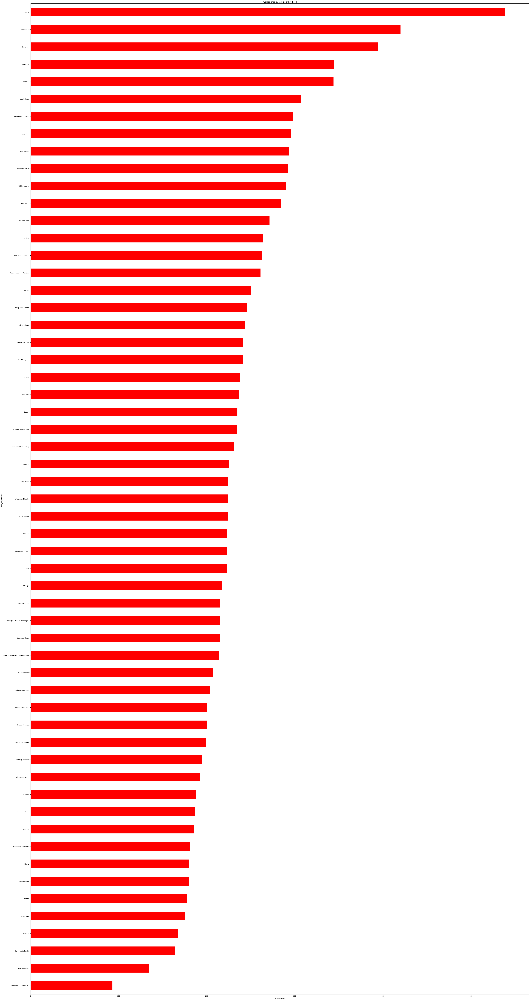

<Figure size 6000x12000 with 0 Axes>

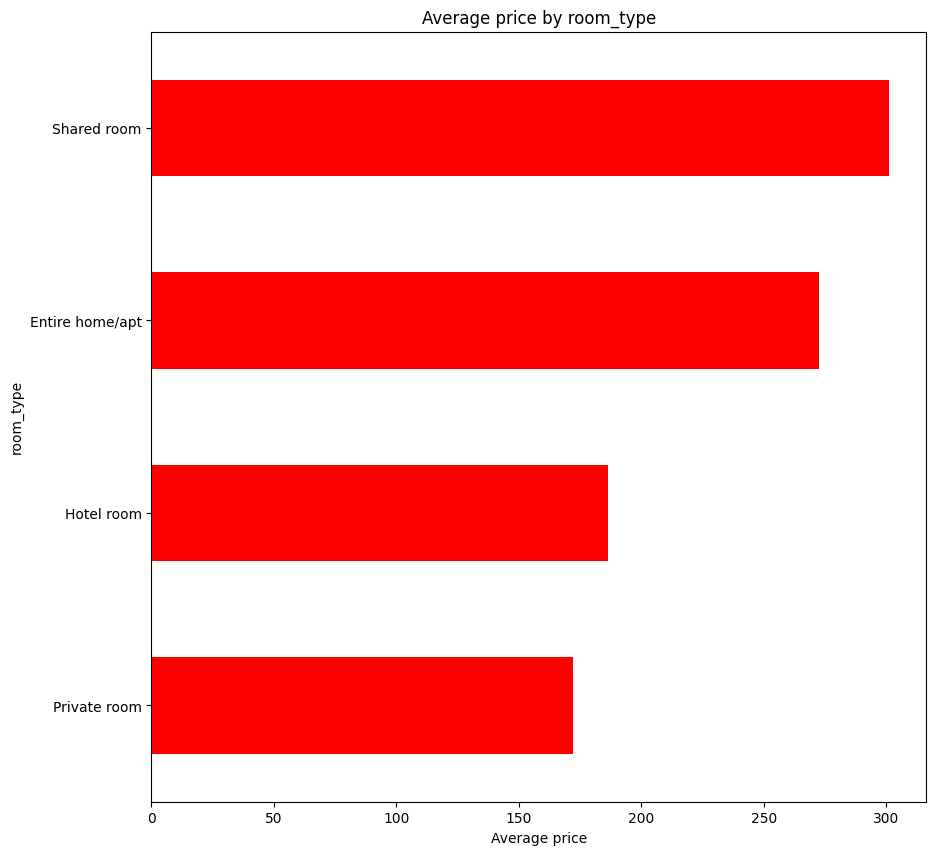

Analysis for newyork:


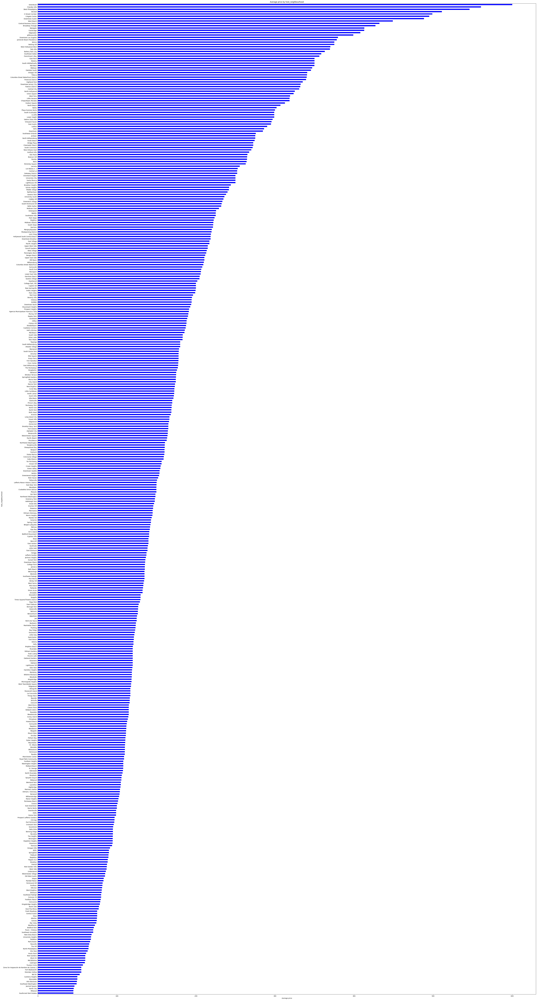

<Figure size 6000x12000 with 0 Axes>

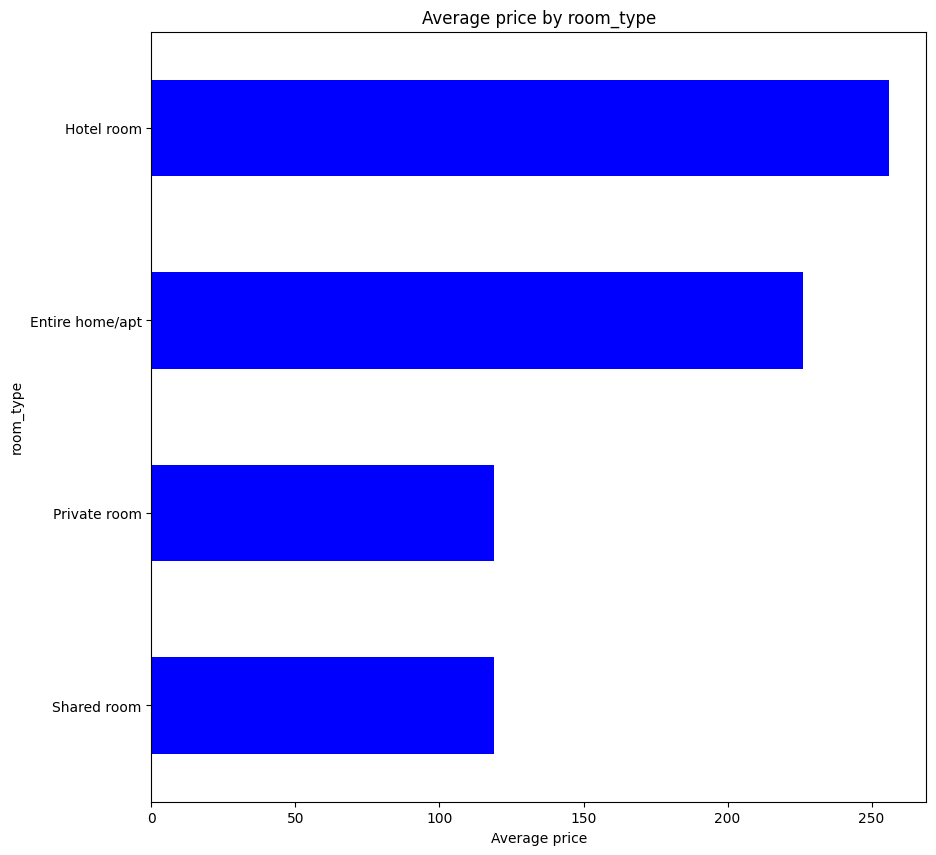

Analysis for london:


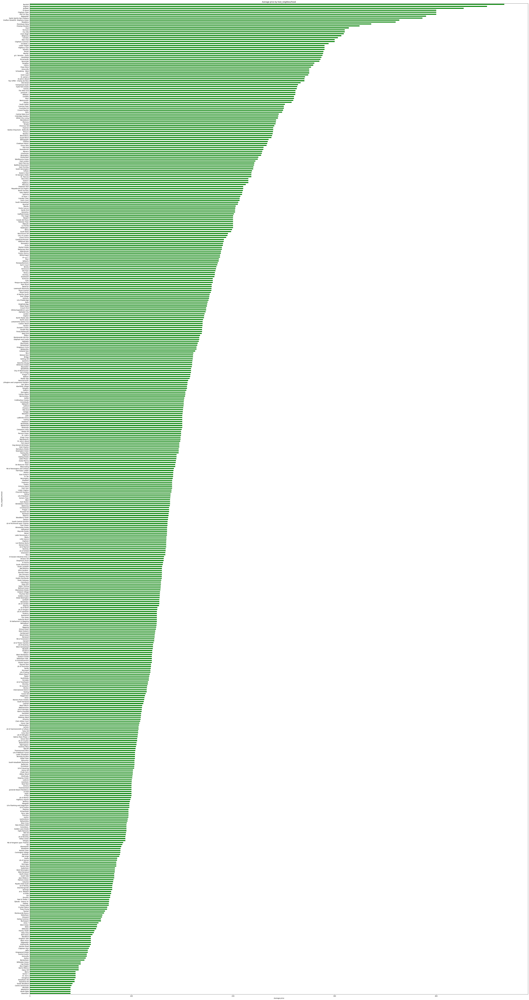

<Figure size 6000x12000 with 0 Axes>

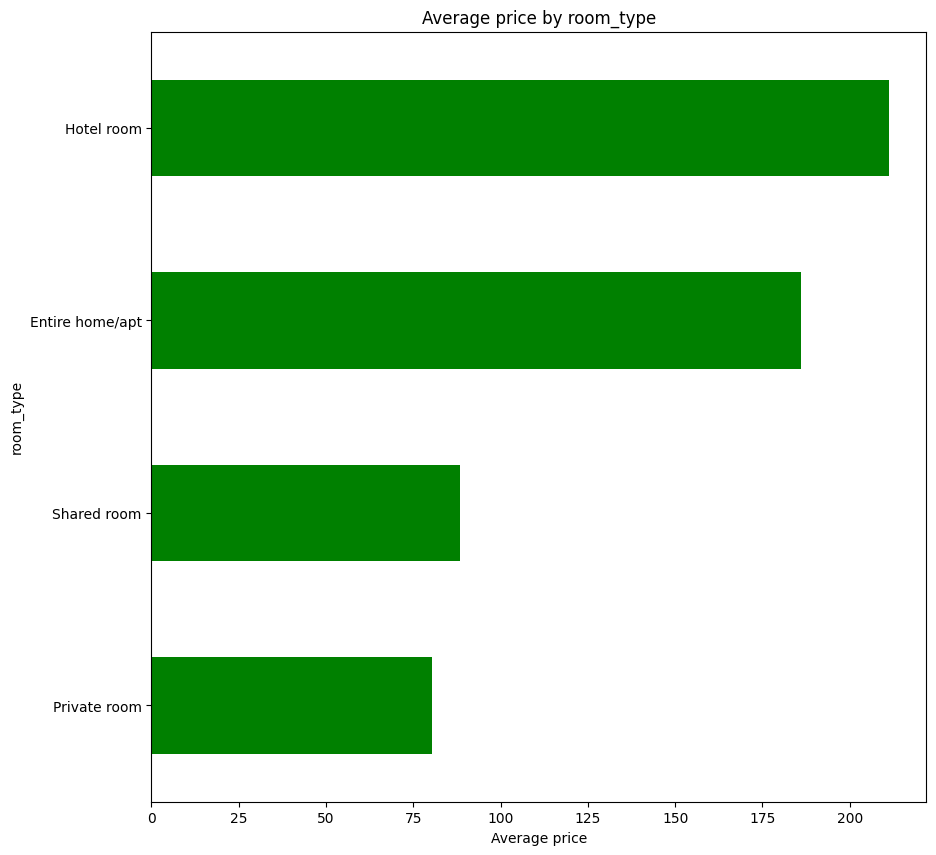

Analysis for sanfrancisco:


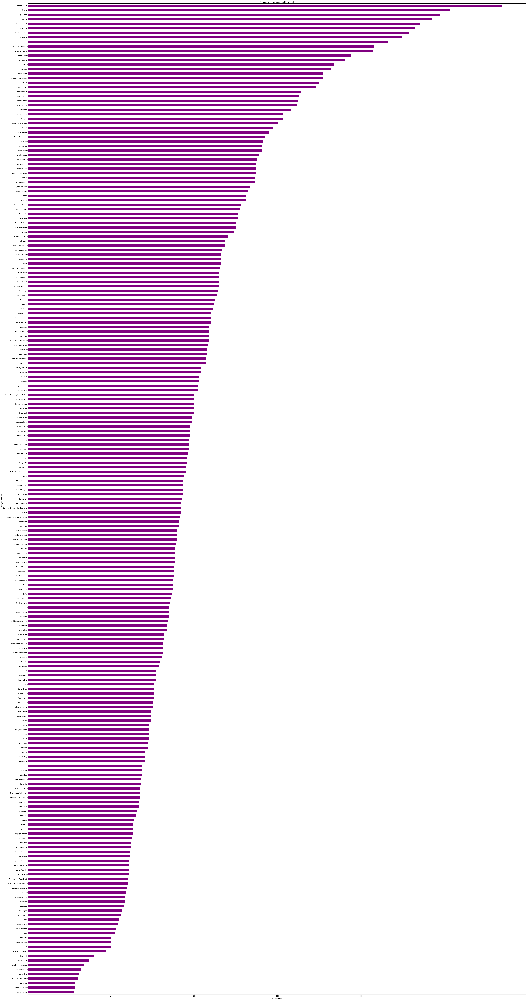

<Figure size 6000x12000 with 0 Axes>

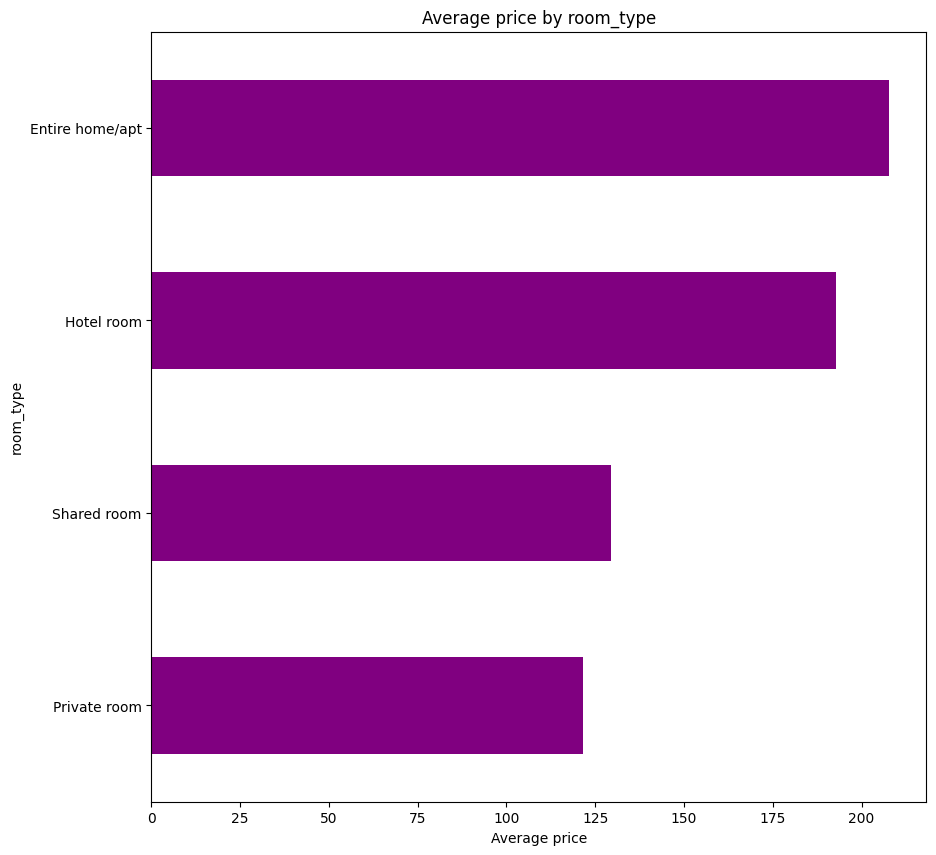

Analysis for toronto:


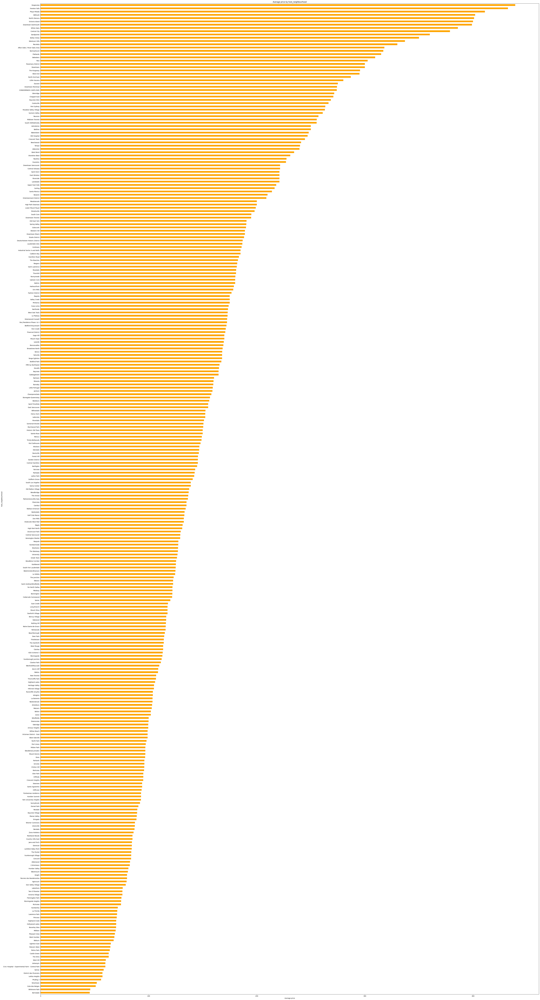

<Figure size 6000x12000 with 0 Axes>

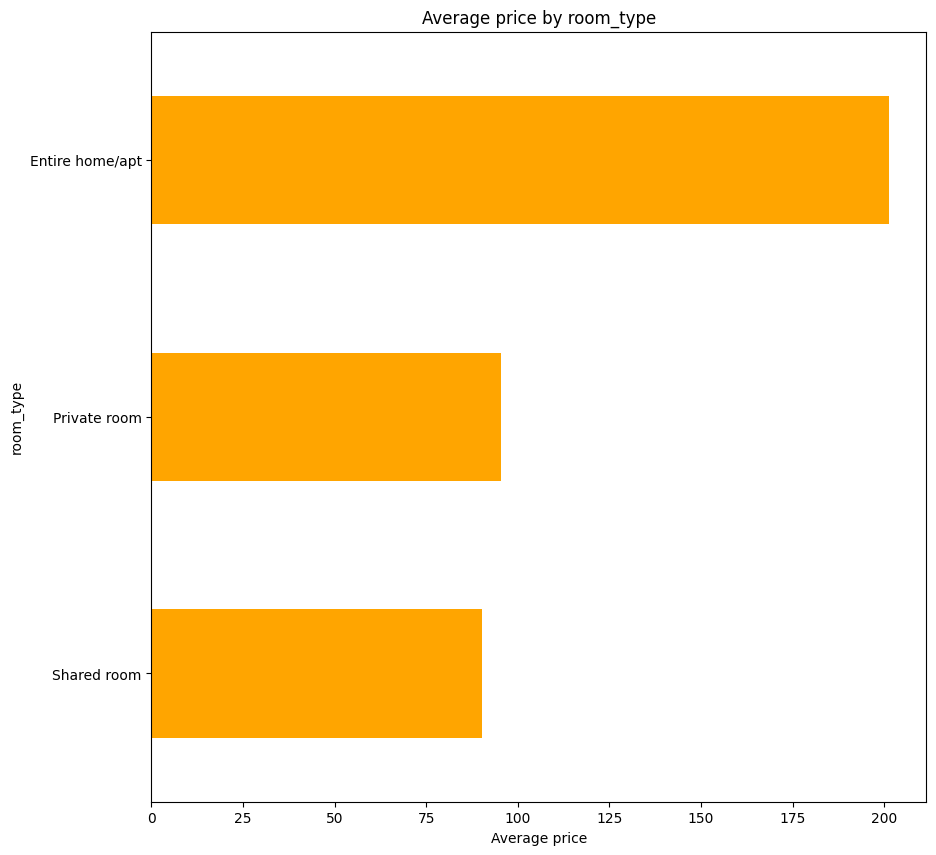

In [200]:
analysis_features = ['host_neighbourhood','room_type']
price_analysis(filtered_listing_price_df,analysis_features,feature_one,city_data)

Analysis for amsterdam:


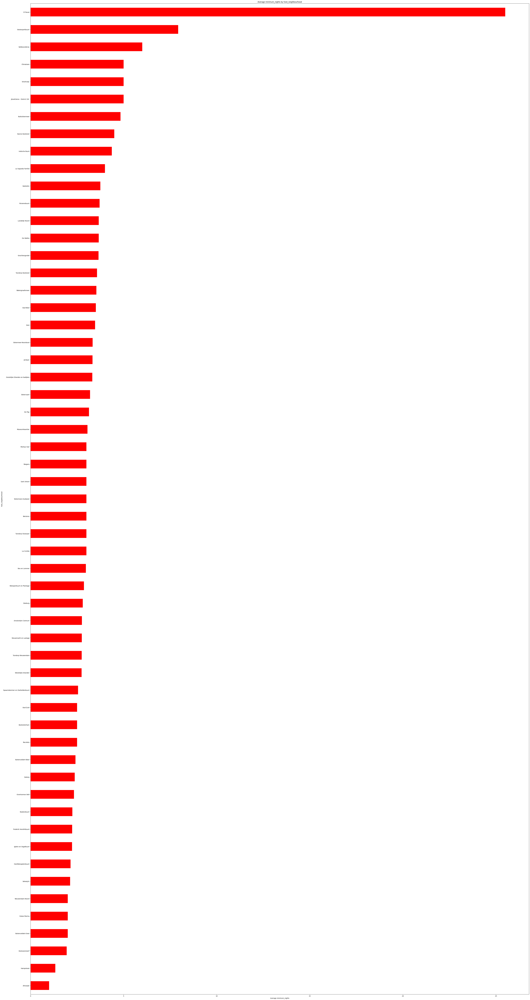

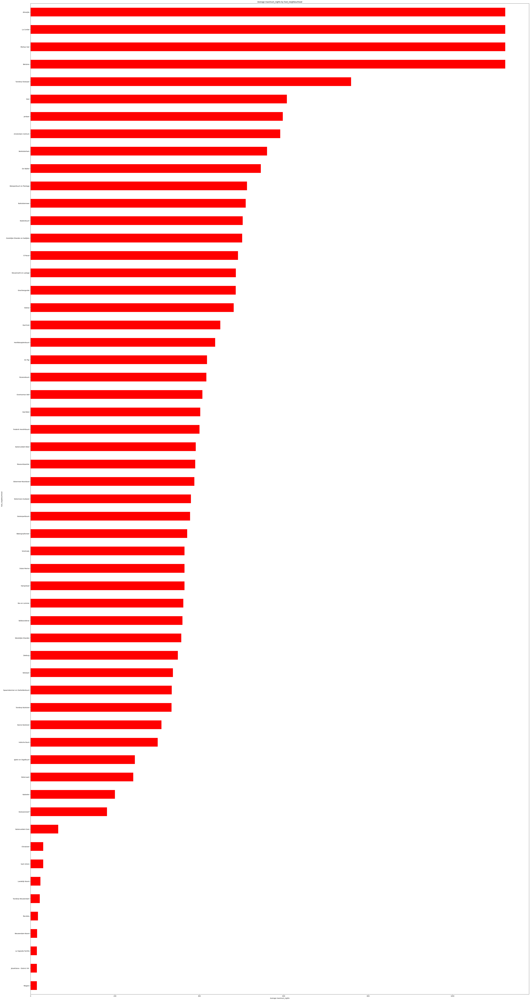

<Figure size 6000x12000 with 0 Axes>

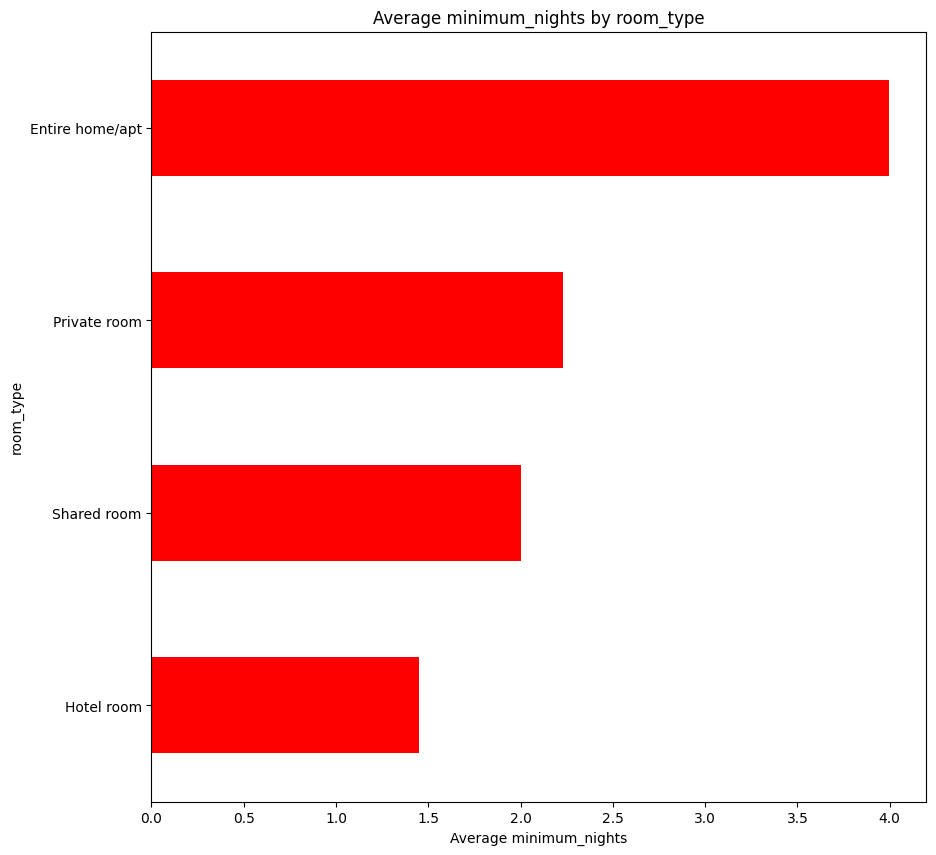

<Figure size 6000x12000 with 0 Axes>

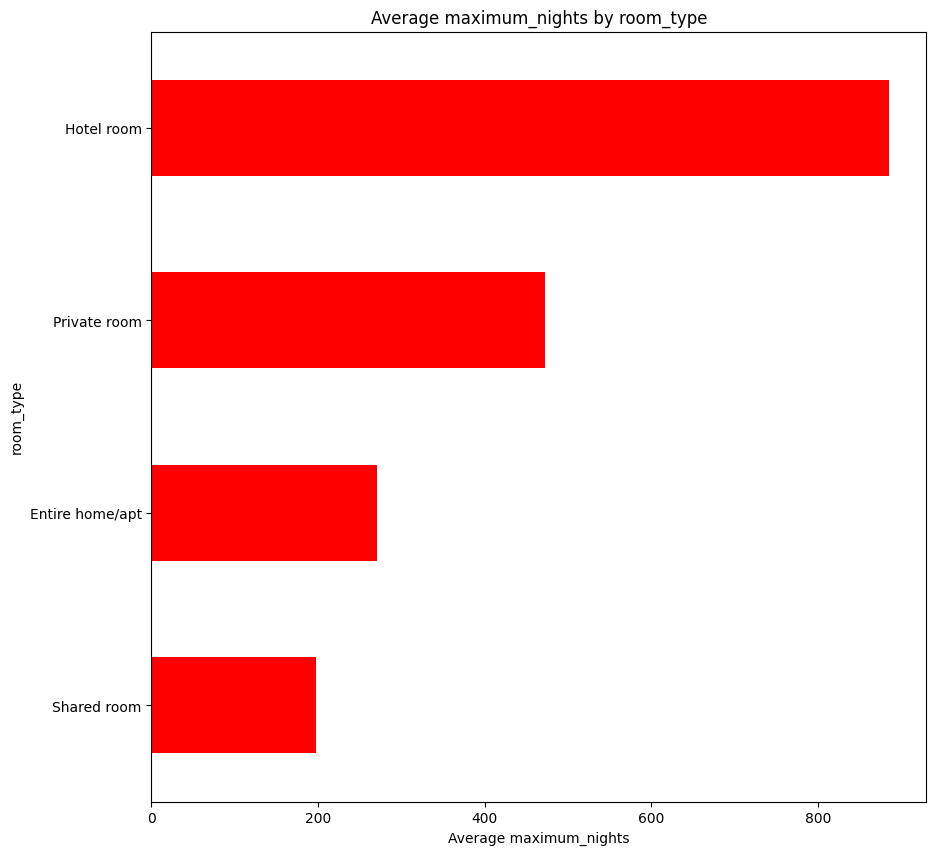

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1729086337.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feature_analysis_2['stay_type'] = city_df['minimum_nights'].apply(lambda x: 'Short-term' if x < 30 else 'Long-term')


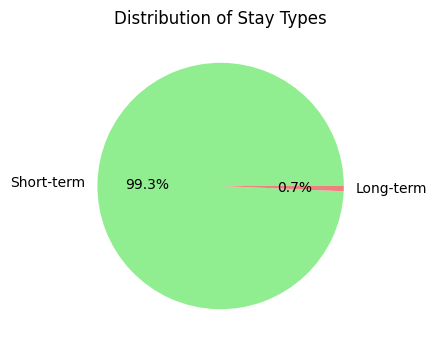

Analysis for newyork:


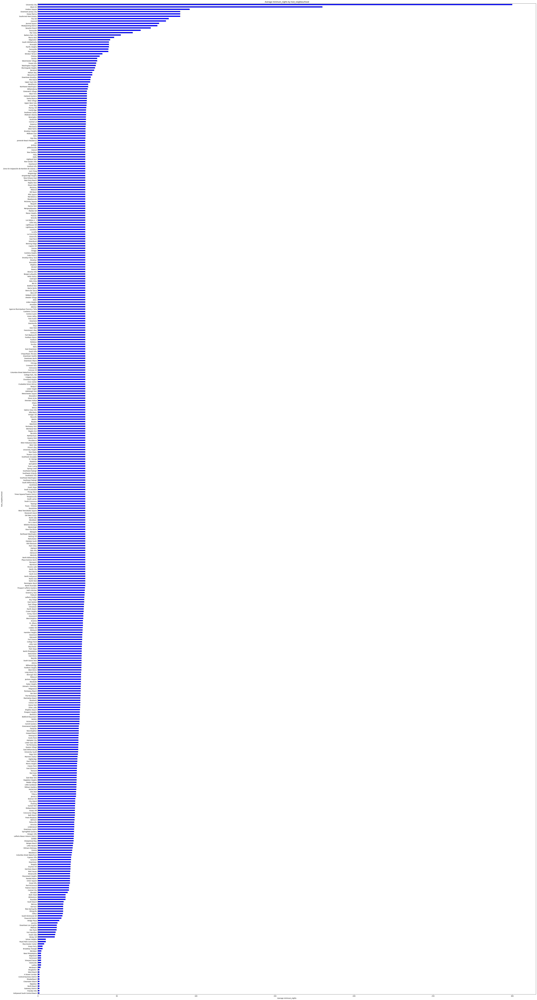

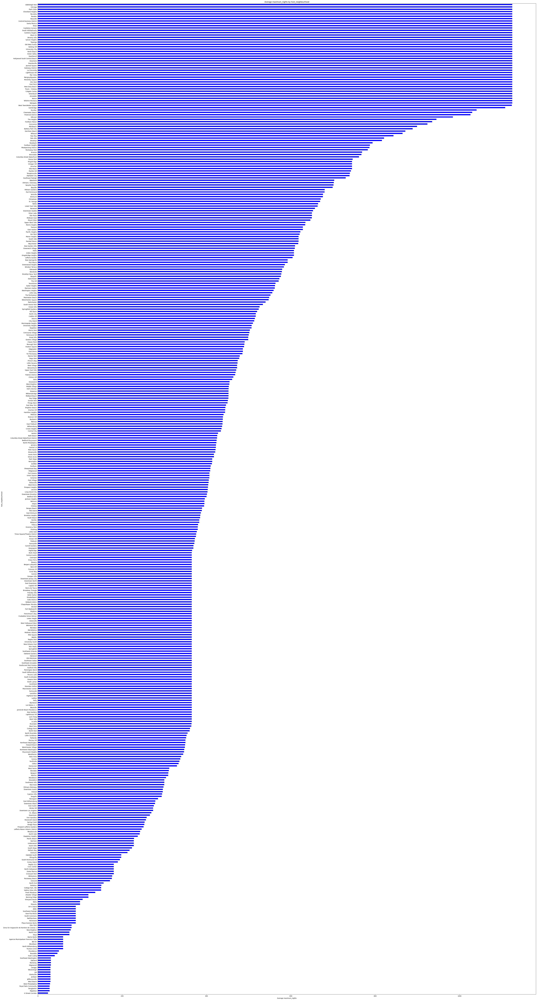

<Figure size 6000x12000 with 0 Axes>

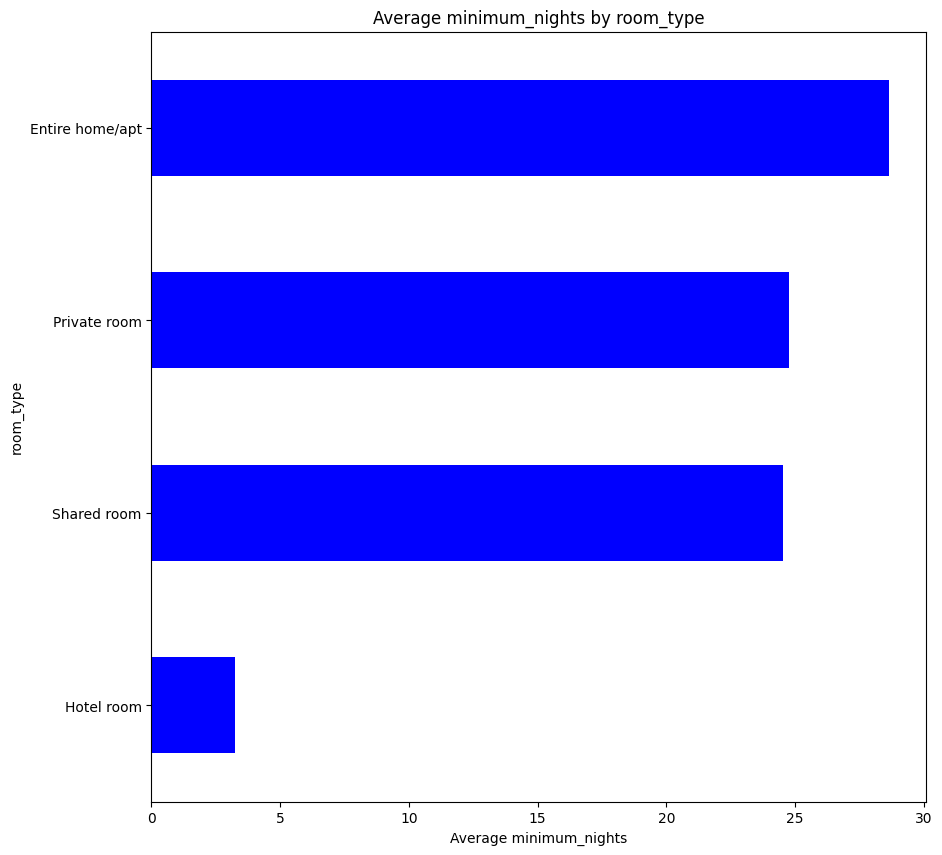

<Figure size 6000x12000 with 0 Axes>

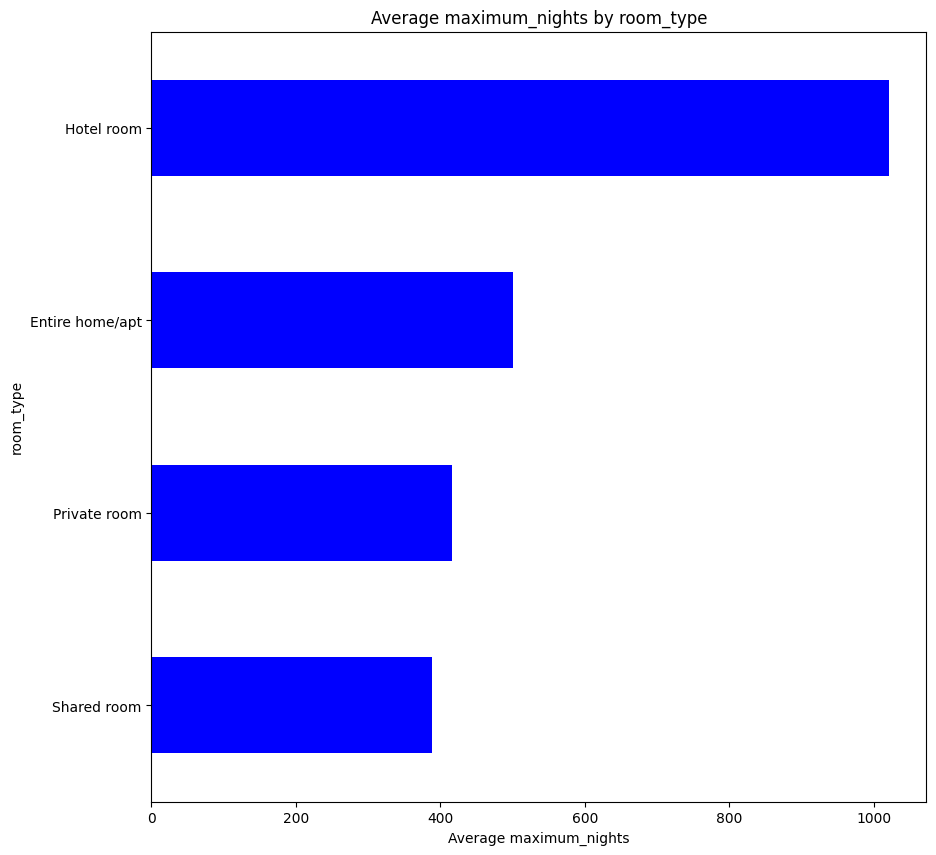

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1729086337.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feature_analysis_2['stay_type'] = city_df['minimum_nights'].apply(lambda x: 'Short-term' if x < 30 else 'Long-term')


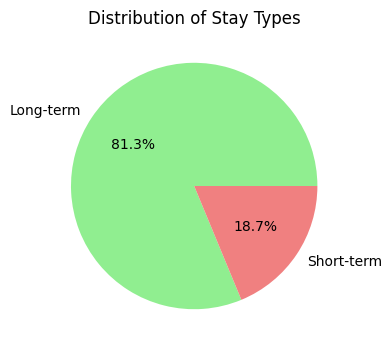

Analysis for london:


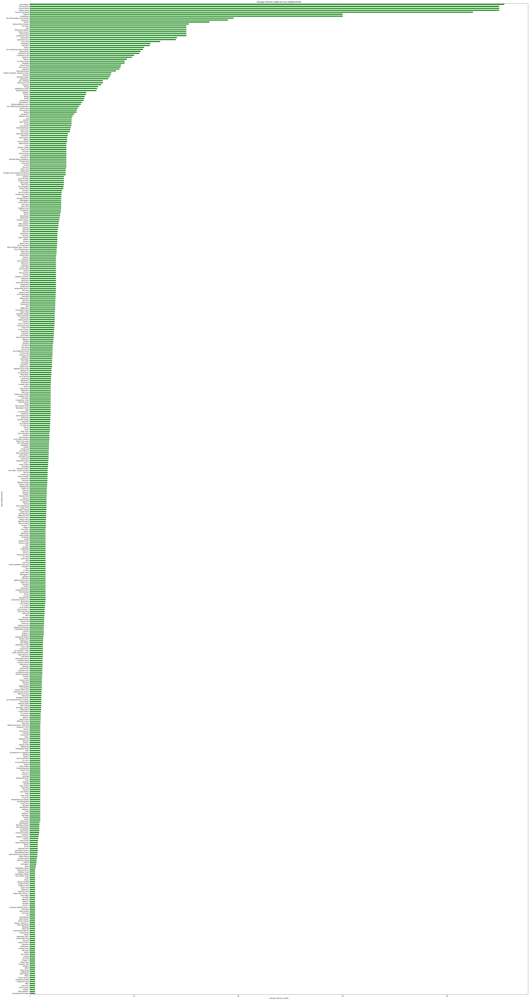

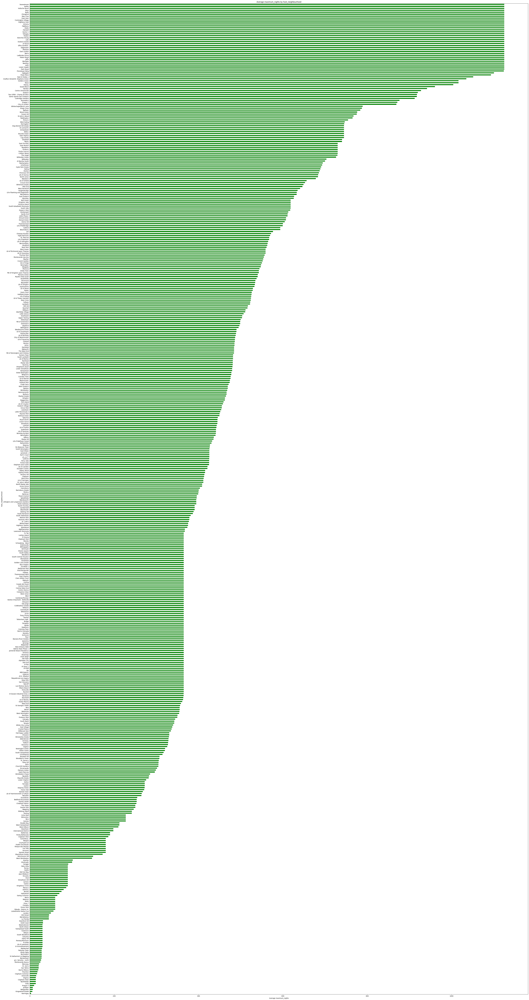

<Figure size 6000x12000 with 0 Axes>

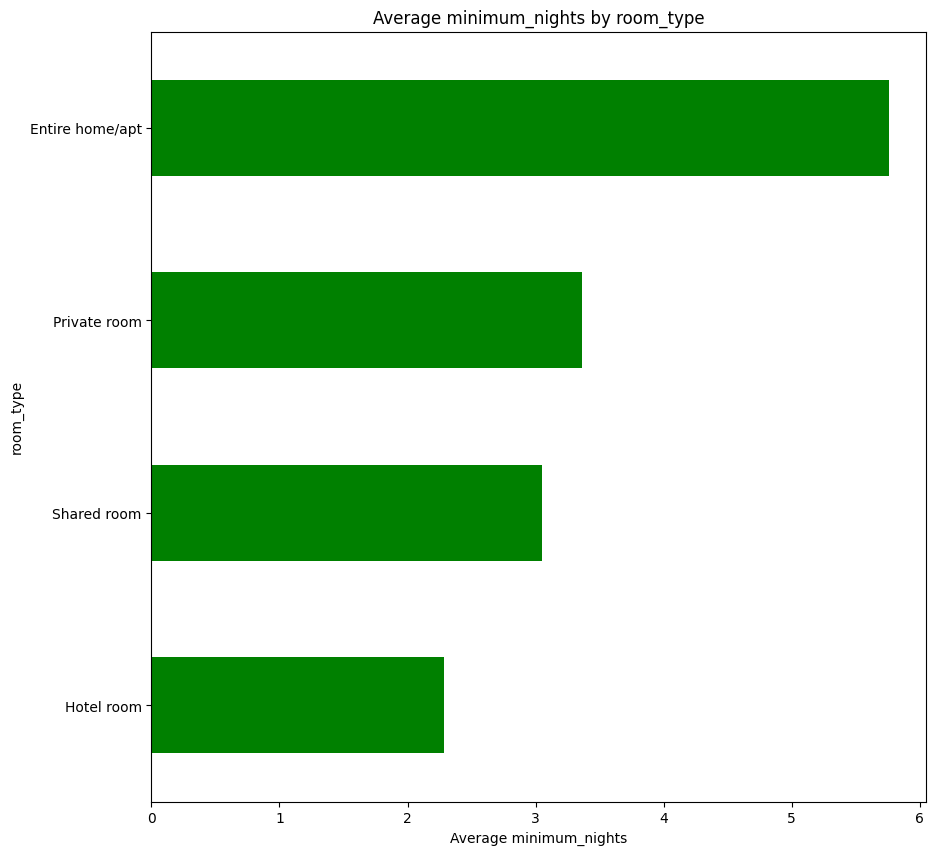

<Figure size 6000x12000 with 0 Axes>

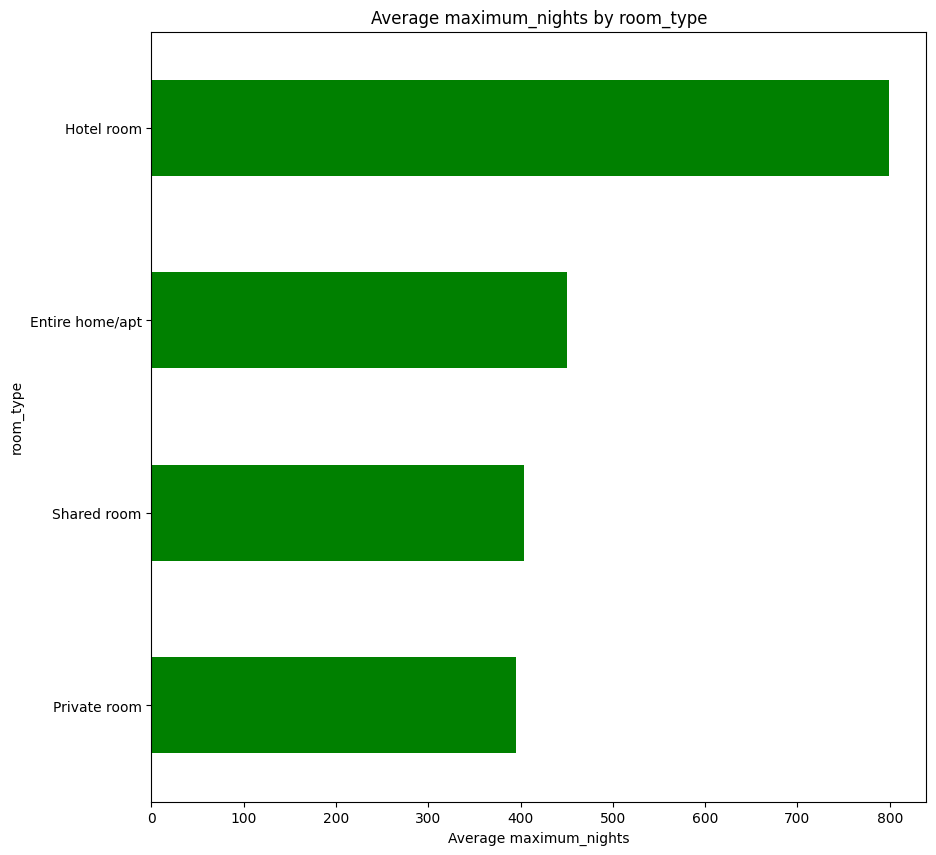

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1729086337.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feature_analysis_2['stay_type'] = city_df['minimum_nights'].apply(lambda x: 'Short-term' if x < 30 else 'Long-term')


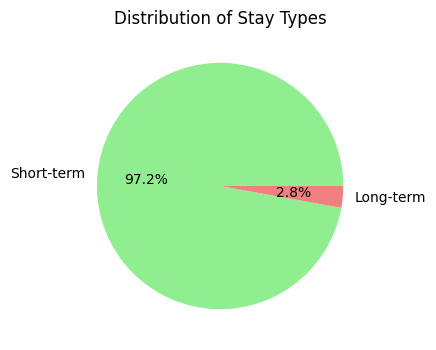

Analysis for sanfrancisco:


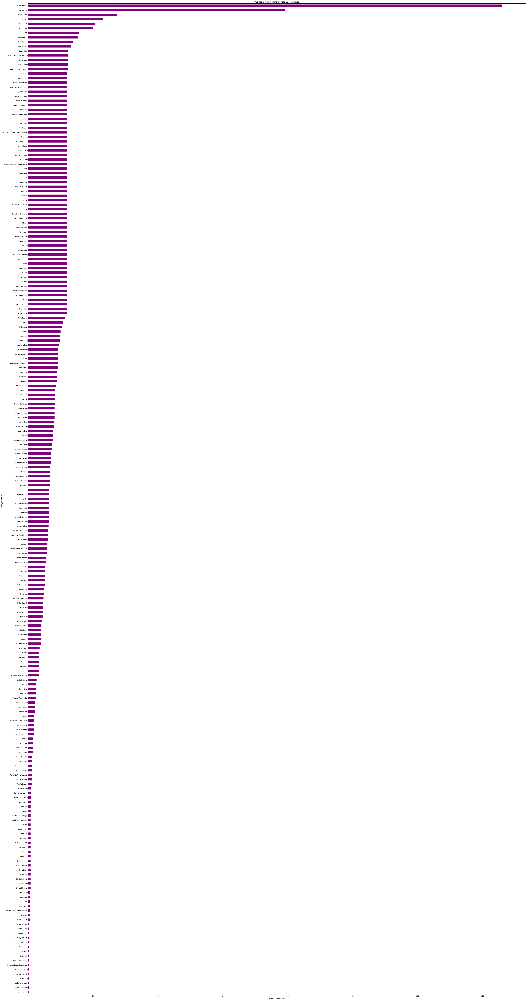

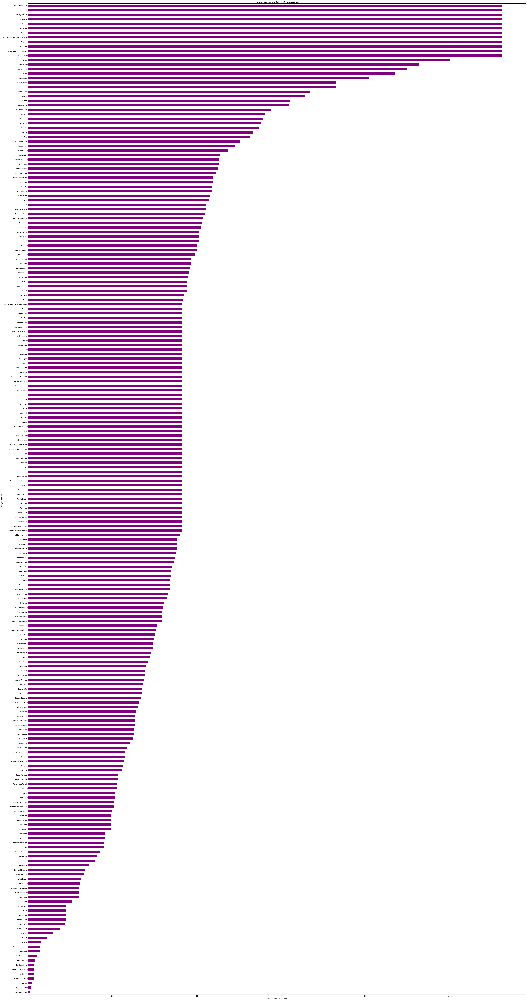

<Figure size 6000x12000 with 0 Axes>

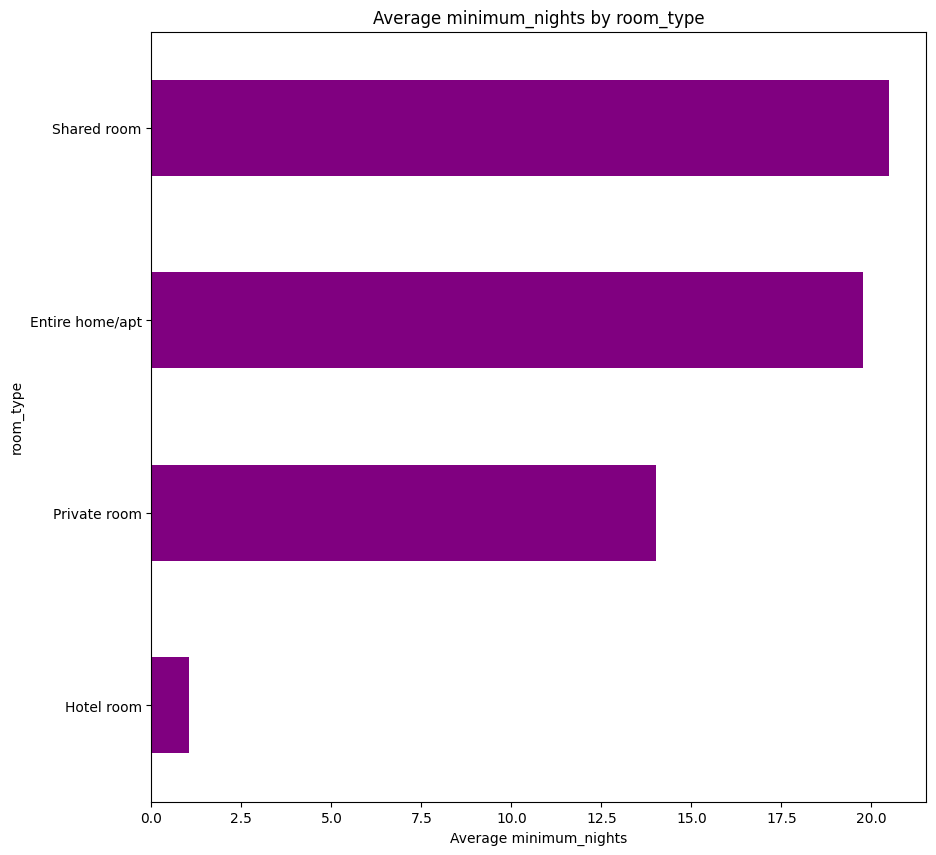

<Figure size 6000x12000 with 0 Axes>

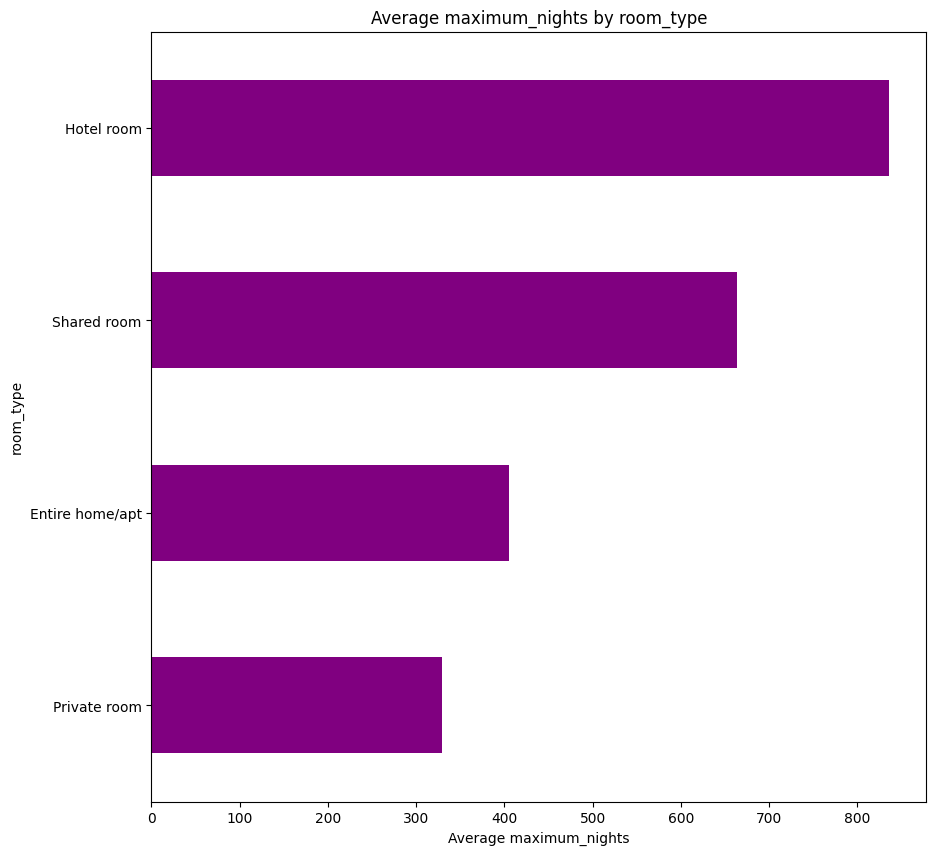

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1729086337.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feature_analysis_2['stay_type'] = city_df['minimum_nights'].apply(lambda x: 'Short-term' if x < 30 else 'Long-term')


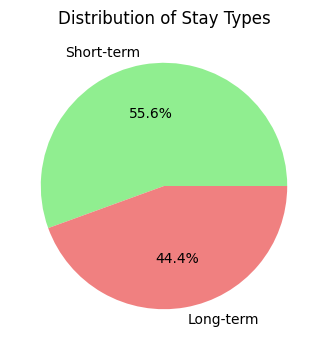

Analysis for toronto:


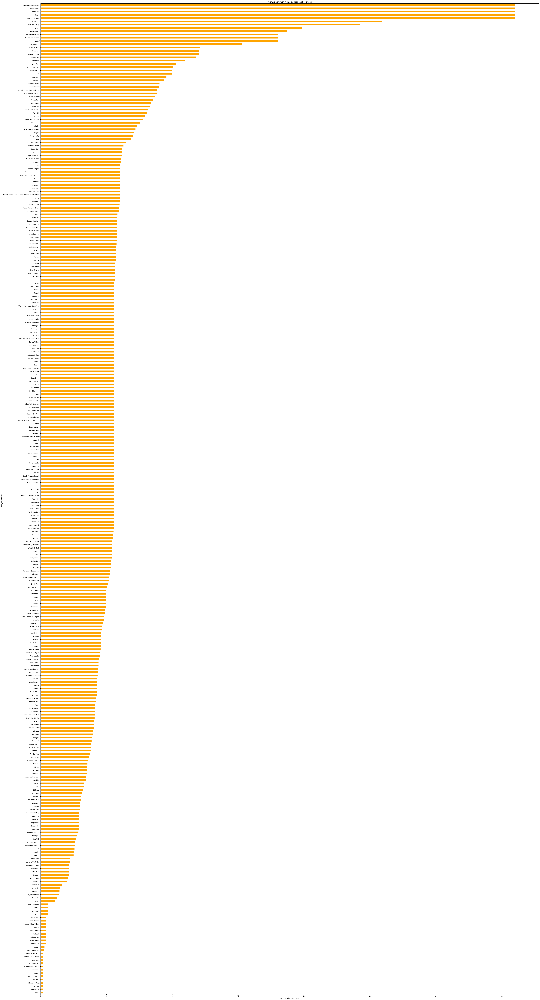

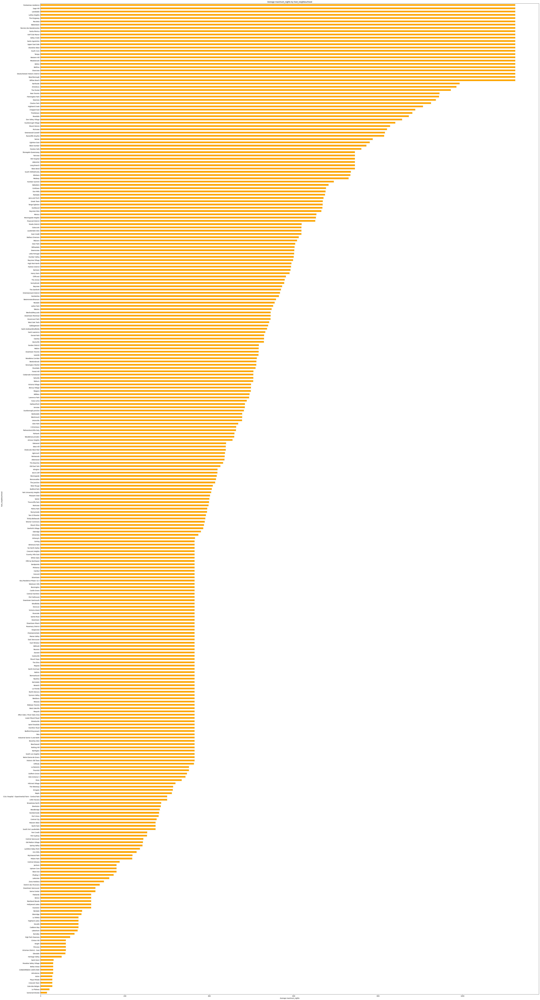

<Figure size 6000x12000 with 0 Axes>

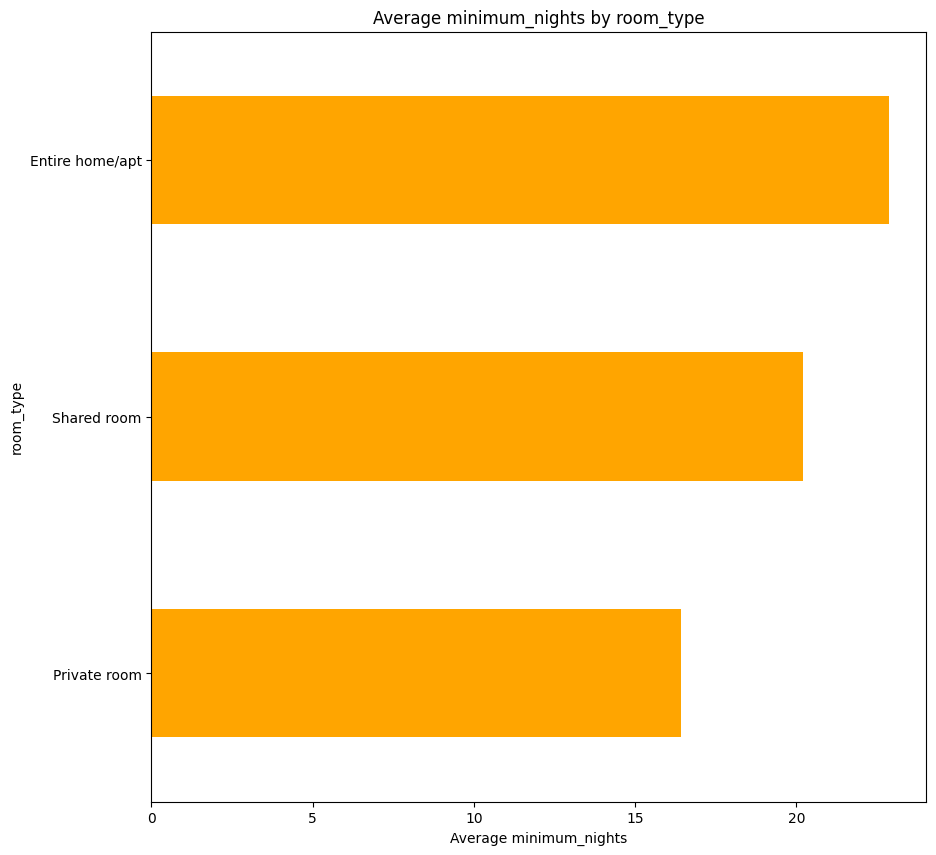

<Figure size 6000x12000 with 0 Axes>

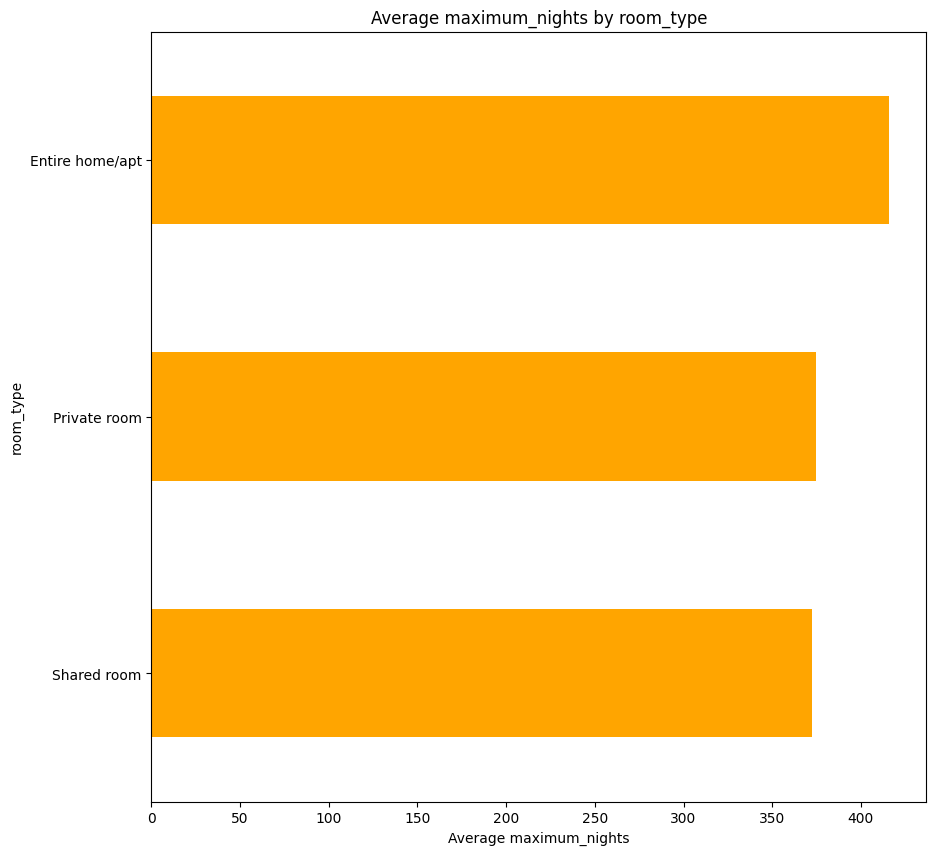

/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1729086337.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  feature_analysis_2['stay_type'] = city_df['minimum_nights'].apply(lambda x: 'Short-term' if x < 30 else 'Long-term')


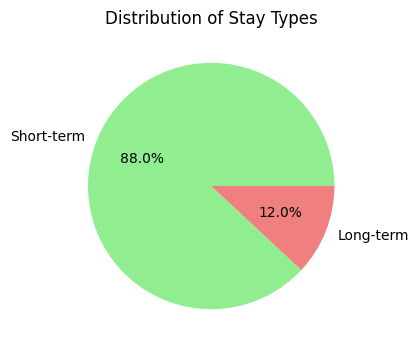

In [201]:
price_analysis(filtered_listing_price_df,analysis_features,feature_two_updated,city_data)

# Task 5 - Neighbourhood Comparison

In [212]:
def neighbourhood_comparison(df,feature_one,feature_two,city_data):
    counter = 0
    for _, row in city_data.iterrows():
        city_id = row['id']
        city_name = row['city']
        # Filter the DataFrame for the current city ID
        city_df = df[df['city_id'] == city_id]
        print(f'Analysis for {city_name}:')
        # Group by neighborhood and calculate average review_scores_rating
        neighborhood_avg_ratings = city_df.groupby('host_neighbourhood')['review_scores_rating'].mean().reset_index()

        # Sort neighborhoods by average rating
        neighborhood_avg_ratings = neighborhood_avg_ratings.sort_values(by='review_scores_rating', ascending=False)

        # Display top neighborhoods with highest ratings
        print("Top 5 neighborhoods with highest average ratings:")
        print(neighborhood_avg_ratings.head())

        # Display bottom neighborhoods with lowest ratings
        print("\nBottom 5 neighborhoods with lowest average ratings:")
        print(neighborhood_avg_ratings.tail())

        # Visualization of the average review_scores_rating across neighborhoods
        plt.figure(figsize=(10, 100))
        sns.barplot(x='review_scores_rating', y='host_neighbourhood', data=neighborhood_avg_ratings, palette='coolwarm')
        plt.title('Average Review Scores Rating by Neighborhood')
        plt.xlabel('Average Review Score Rating')
        plt.ylabel('Neighborhood')
        plt.show()

        # Perform ANOVA to check if differences between neighborhoods are statistically significant
        anova_result = stats.f_oneway(
            *[group['review_scores_rating'].values for name, group in city_df.groupby('host_neighbourhood')]
        )

        print(f"ANOVA test result: F-statistic = {anova_result.statistic:.3f}, p-value = {anova_result.pvalue:.3f}")

        if anova_result.pvalue < 0.05:
            print("The differences in ratings across neighborhoods are statistically significant (p < 0.05).")
        else:
            print("The differences in ratings across neighborhoods are not statistically significant (p >= 0.05).")

        # Step 4: Boxplot for Distribution of Review Scores across Neighborhoods
        plt.figure(figsize=(10, 100))
        sns.boxplot(x='review_scores_rating', y='host_neighbourhood', data=city_df, palette='Set2')
        plt.title('Distribution of Review Scores by Neighborhood')
        plt.xlabel('Review Scores')
        plt.ylabel('Neighborhood')
        plt.show()

Analysis for amsterdam:
Top 5 neighborhoods with highest average ratings:
              host_neighbourhood  review_scores_rating
12                   El Higueral                   5.0
37             Old North Boulder                   5.0
29                      Mountjoy                   5.0
28                   Merkaz HaIr                   5.0
21  Józsefváros - District VIII.                   5.0

Bottom 5 neighborhoods with lowest average ratings:
     host_neighbourhood  review_scores_rating
23               Karlín              4.750000
24      LB of Islington              4.750000
31              Niagara              4.750000
0              Almarjão              4.745000
57  Tuindorp Nieuwendam              4.686667


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='review_scores_rating', y='host_neighbourhood', data=neighborhood_avg_ratings, palette='coolwarm')


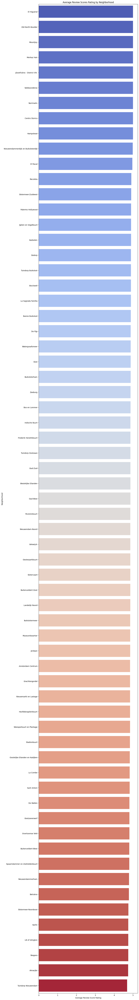

ANOVA test result: F-statistic = 1.397, p-value = 0.021
The differences in ratings across neighborhoods are statistically significant (p < 0.05).


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='review_scores_rating', y='host_neighbourhood', data=city_df, palette='Set2')


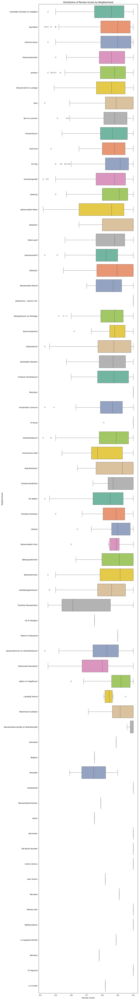

Analysis for newyork:
Top 5 neighborhoods with highest average ratings:
    host_neighbourhood  review_scores_rating
0           Abbotsford                   5.0
270            Newport                   5.0
238    McGinley Square                   5.0
239         Meadowvale                   5.0
246       Mid-Wilshire                   5.0

Bottom 5 neighborhoods with lowest average ratings:
    host_neighbourhood  review_scores_rating
102   Downtown Atlanta                  4.30
10           Astrodome                  4.27
348         Shoreditch                  4.26
355   South Lake Union                  4.25
194             Irvine                  4.00


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='review_scores_rating', y='host_neighbourhood', data=neighborhood_avg_ratings, palette='coolwarm')


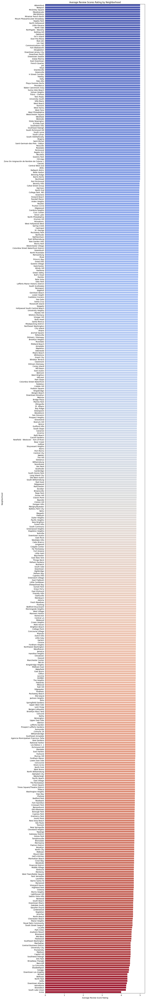

ANOVA test result: F-statistic = 1.962, p-value = 0.000
The differences in ratings across neighborhoods are statistically significant (p < 0.05).


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='review_scores_rating', y='host_neighbourhood', data=city_df, palette='Set2')


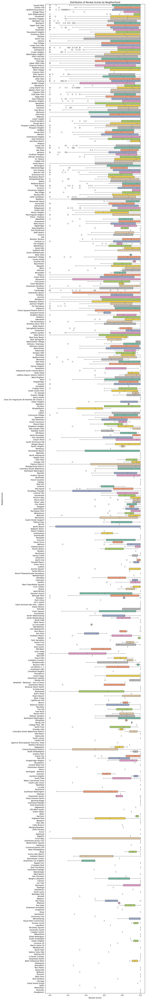

Analysis for london:
Top 5 neighborhoods with highest average ratings:
    host_neighbourhood  review_scores_rating
275      Lantau Island                   5.0
211              Ikoyi                   5.0
347        North Sheen                   5.0
92           Chinatown                   5.0
393           Ratcliff                   5.0

Bottom 5 neighborhoods with lowest average ratings:
          host_neighbourhood  review_scores_rating
147                 El Gouna                   4.0
550            zh.k. Mladost                   4.0
80   Central Fort Lauderdale                   4.0
323         Monteverde Nuovo                   4.0
500                 Victoria                   4.0


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='review_scores_rating', y='host_neighbourhood', data=neighborhood_avg_ratings, palette='coolwarm')


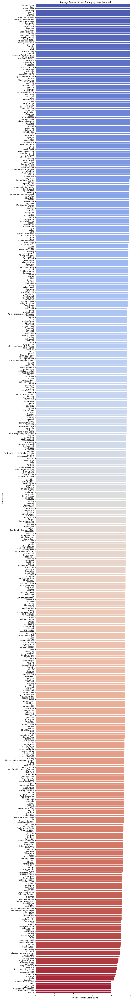

ANOVA test result: F-statistic = 4.382, p-value = 0.000
The differences in ratings across neighborhoods are statistically significant (p < 0.05).


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='review_scores_rating', y='host_neighbourhood', data=city_df, palette='Set2')


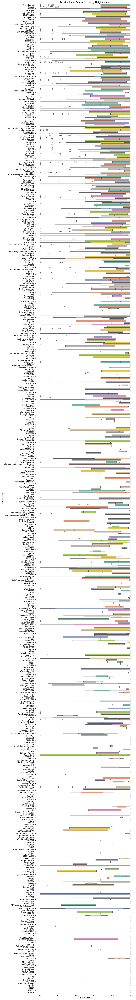

Analysis for sanfrancisco:
Top 5 neighborhoods with highest average ratings:
     host_neighbourhood  review_scores_rating
0              Al Tahoe                   5.0
130  Northwest Berkeley                   5.0
129    Northstar Resort                   5.0
202            Willmore                   5.0
32     Clearwater Beach                   5.0

Bottom 5 neighborhoods with lowest average ratings:
     host_neighbourhood  review_scores_rating
119    New Orleans East                  4.60
10               Avalon                  4.54
95        Little Saigon                  4.50
34   Commerce - Dupleix                  4.50
207      ж.к. Стрелбище                  4.50


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='review_scores_rating', y='host_neighbourhood', data=neighborhood_avg_ratings, palette='coolwarm')


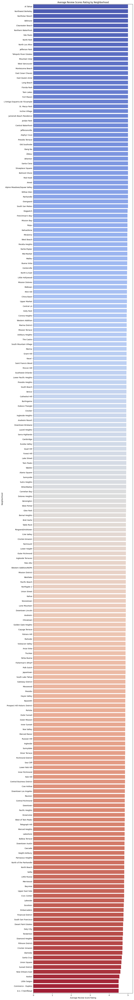

ANOVA test result: F-statistic = 2.705, p-value = 0.000
The differences in ratings across neighborhoods are statistically significant (p < 0.05).


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='review_scores_rating', y='host_neighbourhood', data=city_df, palette='Set2')


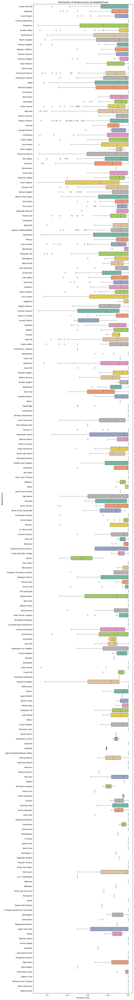

Analysis for toronto:
Top 5 neighborhoods with highest average ratings:
        host_neighbourhood  review_scores_rating
0     Puntarenas residence                   5.0
243        Upper East Side                   5.0
227          Symons Valley                   5.0
36        Central Hamilton                   5.0
37       Central Vancouver                   5.0

Bottom 5 neighborhoods with lowest average ratings:
    host_neighbourhood  review_scores_rating
245       Valley Creek                  4.33
93     Golf Club Manor                  4.33
151             Medway                  4.29
51     Cote-des-Neiges                  4.28
225         Sunnybrook                  4.20


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='review_scores_rating', y='host_neighbourhood', data=neighborhood_avg_ratings, palette='coolwarm')


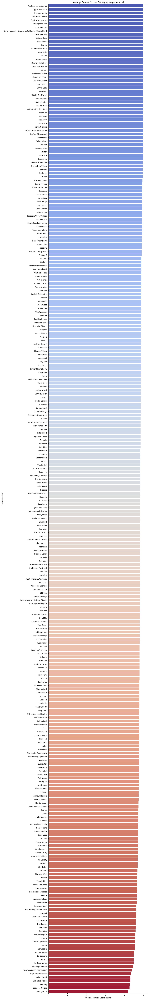

ANOVA test result: F-statistic = 1.849, p-value = 0.000
The differences in ratings across neighborhoods are statistically significant (p < 0.05).


/var/folders/nb/sgb5l3c56gx84mnvsmg95cz00000gn/T/ipykernel_13324/1674690471.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='review_scores_rating', y='host_neighbourhood', data=city_df, palette='Set2')


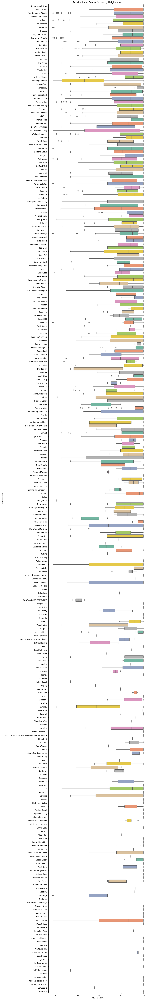

In [213]:
comparison_feature = ['host_neighbourhood']
neighbourhood_comparison(filtered_listing_review_score_df,comparison_feature,feature_three,city_data)